# Data description


Online learning activities are on the rise. Further helped by the recent pandemic of covid-19, educational institutions have had periods of full online activity. And currently, there is a lack of means with which educators can determine if their students are engaging in online class activities, and also determine whether engagement is one of the augmenting-factors of academic success at all. With universities moving their class materials online, there is also an increased opportunity to collect data on student-populations for studying the success factors of a particular student within a semester.
This data aims to model the engagement-level of students in universities. It supplements the manuscript <citing the paper>. While the data points to the activities of university students only, it would serve as a guideline to replicate similar modelling methods designed for other kinds of educational institutions as well.

The raw data for this modelling task had been acquired from a private database of public university data that isn't accessible openly. The database contained 435 tables. The tables pointed to both actionable and non-actionable information. Of the actionable information, there were data related to user information, course information, course enrolments, assignment information, questionnaires, quizes, etc. The non-actionable information were related to website and webpage configuration.

In <paper>, the proposed model for engagement-level takes several inputs. Not all the tables contain the input data needed for the model. Specifically, only 20 of the 435 tables contained the required data that serve as the inputs. Furthermore, the tables contained data in a disjoint manner. For example, one table would have course names and a course id, another table would have user names and the course id's that they are involved in, and again, another would have the faculty that is offering the course. Therefore, the tables would have to be transformed and merged in various ways to ultimately provide meaning for the proposed engagement model.

# Prelude

**Variable naming:** 
1. The names of the dataframes are identical to the names of the postgres tables.
2. A modified dataframe (derived from the psql tables) have a 'vx' suffix where v stands for version and x is the version number. The first modified version is named 'df_v2'.
3. the naming of other variables is such that the last part (after '_') indicates the Postgres table it's used in/taken data from.

In [748]:
import sys, os

Check the version of python you're running

In [749]:
sys.executable

'c:\\Users\\kople\\anaconda3\\python.exe'

In [750]:
sys.path

['c:\\Users\\kople\\Documents\\Work\\RA\\Student-Engagement_Prediction\\notebooks\\data_consolidation',
 'c:\\Users\\kople\\anaconda3\\python39.zip',
 'c:\\Users\\kople\\anaconda3\\DLLs',
 'c:\\Users\\kople\\anaconda3\\lib',
 'c:\\Users\\kople\\anaconda3',
 '',
 'C:\\Users\\kople\\AppData\\Roaming\\Python\\Python39\\site-packages',
 'c:\\Users\\kople\\anaconda3\\lib\\site-packages',
 'c:\\Users\\kople\\anaconda3\\lib\\site-packages\\win32',
 'c:\\Users\\kople\\anaconda3\\lib\\site-packages\\win32\\lib',
 'c:\\Users\\kople\\anaconda3\\lib\\site-packages\\Pythonwin']

Check the working directory

In [751]:
os.getcwd()

'c:\\Users\\kople\\Documents\\Work\\RA\\Student-Engagement_Prediction\\notebooks\\data_consolidation'

## Imports

In [752]:
import pandas as pd
import seaborn as sns
import plotly.express as px
import plotly.io as pio
import matplotlib.pyplot as plt
import numpy as np
#import pyarrow
import missingno as msno
from tqdm.notebook import tqdm_notebook,trange
from tqdm.auto import tqdm
from time import sleep
import re
%matplotlib inline

## Configuring Plotly

Setting the renderer (https://plotly.com/python/renderers/)

In [753]:
pio.renderers

Renderers configuration
-----------------------
    Default renderer: 'vscode'
    Available renderers:
        ['plotly_mimetype', 'jupyterlab', 'nteract', 'vscode',
         'notebook', 'notebook_connected', 'kaggle', 'azure', 'colab',
         'cocalc', 'databricks', 'json', 'png', 'jpeg', 'jpg', 'svg',
         'pdf', 'browser', 'firefox', 'chrome', 'chromium', 'iframe',
         'iframe_connected', 'sphinx_gallery', 'sphinx_gallery_png']

In [754]:
#pio.renderers.default = "notebook"

Available themes

In [755]:
pio.templates

Templates configuration
-----------------------
    Default template: 'plotly'
    Available templates:
        ['ggplot2', 'seaborn', 'simple_white', 'plotly',
         'plotly_white', 'plotly_dark', 'presentation', 'xgridoff',
         'ygridoff', 'gridon', 'none']

In [756]:
template = 'plotly_dark'

## Data path strings

Set path to data extracted from database

In [757]:
ppath = 'C:/Users/kople/Documents/Work/RA/data/processed/sess1819sem2/'
path = 'C:/Users/kople/Documents/Work/RA/data/raw/sess1819sem2/'

In [758]:
assignment_grades = pd.read_csv(f'{path}assignment_grades.csv')
assignment_submission = pd.read_csv(f'{path}assignment_submission.csv')
assignment_user_mapping = pd.read_csv(f'{path}assignment_user_mapping.csv')

### Connect to database

In [759]:
from sqlite3 import connect
import psycopg2

# Connection parameters, yours will be different
param_dic = {
    "host"      : "localhost",
    "database"  : "postgres",
    "user"      : "postgres",
    "password"  : "zarif311998"
}

def connect(params_dic):
    """ Connect to the PostgreSQL database server """
    conn = None
    try:
        # connect to the PostgreSQL server
        print('Connecting to the PostgreSQL database...')
        conn = psycopg2.connect(**params_dic)
    except (Exception, psycopg2.DatabaseError) as error:
        print(error)
        sys.exit(1) 
    print("Connection successful")
    return conn

In [760]:
def postgresql_to_dataframe(conn, select_query, column_names):
    """
    Tranform a SELECT query into a pandas dataframe
    """
    cursor = conn.cursor()
    try:
        cursor.execute(select_query)
    except (Exception, psycopg2.DatabaseError) as error:
        print("Error: %s" % error)
        cursor.close()
        return 1
    
    # Naturally we get a list of tupples
    tupples = cursor.fetchall()
    cursor.close()
    
    # We just need to turn it into a pandas dataframe
    df = pd.DataFrame(tupples, columns=column_names)
    return df

In [761]:
conn = connect(param_dic)

Connecting to the PostgreSQL database...
Connection successful


# Custom functions

## items_per_user

In [762]:
def items_per_user(df,feature, parent_feature=None):
    """For a given dataframe and feature within that dataframe, items_per_user() returns
    a dataframe with the number of items in the feature that belong to or are attributed 
    to the user id. Note that the function assumes that the df has a column 'userid'."""

    #preprocessing: sort the df by userid
    users = df.sort_values(by='userid').userid.unique()
    n_items_per_user = []
    if feature not in df.columns:
        print('The column', feature,' does not exist')
        pass
    if parent_feature==None:

        for user in users:
                #select portion of dataframe specific to the single user and then count number of unique values for the feature
                n_items=df[df.userid==user][feature].nunique()
                #add the data to the array
                n_items_per_user.append(n_items)
                #create the dataframe
        feature = 'number_of_' + feature +'s' #changing the name of the item column
        items_per_user_df = pd.DataFrame({'userid':users,feature:n_items_per_user})

    # else:
    #     # insert each item of the parent feature into a list
    #     parents = df[parent_feature].sort_values().unique()
    #     users = df.sort_values(by=parent_feature).userid.unique()
    #
    #     for user in users: # selecting a user
    #         for parent in parents: # iterating through all the parent_feature items
    #             n_items = df[(df.userid==user)&(df[parent_feature]==parent)][feature].nunique()
    #             n_items_per_user.append(n_items)
    #     # create the dataframe
    #     feature = 'number_of_' + feature +'s' #changing the name of the item column
    #     parent_feature = parent_feature+'id'
    #     items_per_user_df = pd.DataFrame({'userid':users, parent_feature:parent, feature:n_items_per_user})



        #
        # for item in items_parent_feature:
        #     # select portion of dataframe specific to the item, count the number of items in the child feature and put into list
        #     n_items = df[df[parent_feature]==item][feature].nunique()
        #     users = df[df[parent_feature]==item].userid.unique()
        #     n_items_per_user.append(n_items)

    return items_per_user_df

In [763]:
help(items_per_user)

Help on function items_per_user in module __main__:

items_per_user(df, feature, parent_feature=None)
    For a given dataframe and feature within that dataframe, items_per_user() returns
    a dataframe with the number of items in the feature that belong to or are attributed 
    to the user id. Note that the function assumes that the df has a column 'userid'.



## pcnt_df

In [764]:
def pcnt_df_old(df,feature,x,method ='>'):
    """Calculate the portion(in percentage) of the dataframe that is populated by values greater or lesser than x"""
    #preprocessing
    df_notna = df[df[feature].notna()] #select portion of dataframe that is not empty

    if feature not in df.columns:
        raise Exception(feature, "is not a column of the dataframe")
    #if x not in df[feature]:
        #raise Exception(x, "is not within the range of the selected feature.")
    else:
        if method=='>':
            df_above_x = df_notna[df_notna[feature]>x]
            pcnt = df_above_x.shape[0]/df_notna.shape[0]

        if method=='<':
            df_below_x = df_notna[df_notna[feature]<x]
            pcnt = df_below_x.shape[0]/df_notna.shape[0]

        if method=='>=':
            df_above_equal_x = df_notna[df_notna[feature]>=x]
            pcnt = df_above_equal_x.shape[0]/df_notna.shape[0]
            
        if method=='<=':
            df_below_equal_x = df_notna[df_notna[feature]<=x]
            pcnt = df_below_equal_x.shape[0]/df_notna.shape[0]

        return pcnt*100

    

In [765]:
def pcnt_df(df,feature,lbound=None,hbound=None):
    """Calculate the portion(in percentage) of the dataframe that is populated by values bound by lbound and hbound (You can also use only one bound)"""
    #preprocessing
    df_notna = df[df[feature].notna()] #select portion of dataframe that is not empty

    if feature not in df.columns:
        raise Exception(feature, "is not a column of the dataframe")
    #if x not in df[feature]:
    #raise Exception(x, "is not within the range of the selected feature.")
    else:
        if hbound is None:
            df_above_lbound = df_notna[df_notna[feature]>lbound]
            pcnt = df_above_lbound.shape[0]/df_notna.shape[0]

        elif lbound is None:
            df_below_hbound = df_notna[df_notna[feature]<hbound]
            pcnt = df_below_hbound.shape[0]/df_notna.shape[0]

        elif lbound is not None and hbound is not None:
            df_btn_l_h = df_notna[(df_notna[feature]>lbound)&(df_notna[feature]<hbound)]
            pcnt = df_btn_l_h.shape[0]/df_notna.shape[0]

        return pcnt*100

## get_df_name(df)

In [766]:
def get_df_name(df):
    name =[x for x in globals() if globals()[x] is df][0]
    return name

## find_stats

In [767]:
# find statistical max,min and mean for the data on attempts
def find_stats(df,attempt_column):
    stat_all = []
    for user in df.userid.unique():
        df_user = df.loc[df.userid==user]
        max_attempt = df_user[attempt_column].max()
        min_attempt = df_user[attempt_column].min()
        mean_attempt = df_user[attempt_column].mean()
        stat_user = [max_attempt,min_attempt,mean_attempt]
        stat_all.append(stat_user)

    max_attempts = [el[0] for el in stat_all]
    min_attempts = [el[1] for el in stat_all]
    mean_attempts = [el[2] for el in stat_all]

    df2 = pd.DataFrame()
    df2['userid'] = df.userid.unique()
    df2[f'max_{attempt_column}'] = max_attempts
    df2[f'min_{attempt_column}'] = min_attempts
    df2[f'mean_{attempt_column}'] = mean_attempts

    return df2

## classify_emails

In [768]:
#function to classify emails
def classify_email(df, email_column):
    """classify_email takes an email and returns a 2-tuple of student and teacher's emails. The first element of the tuple is a list of student emails and the second list is a list of teacher's emails."""

    student_emails = []
    teacher_emails = []

    pattern_student = re.compile(r'[a-zA-Z0-9]+@siswa.um.edu.my$')
    pattern_teacher = re.compile(r'[a-zA-Z0-9]+@um.edu.my$')

    for email in df[email_column].unique():
        if type(email)==str: # To escape NaN values from the original series
            if(re.search(pattern_student,email)):
                student_emails.append(email)
            if(re.search(pattern_teacher,email)):
                teacher_emails.append(email)
        else:
            pass

    return student_emails,teacher_emails

# Assignment related data

## Assign_meta

In [769]:
assign_meta = pd.read_csv(f'{path}assignment_meta.csv')

In [770]:
assign_meta

,id,course,name,intro,introformat,alwaysshowdescription,nosubmissions,submissiondrafts,sendnotifications,sendlatenotifications,...,requireallteammemberssubmit,teamsubmissiongroupingid,blindmarking,revealidentities,attemptreopenmethod,maxattempts,markingworkflow,markingallocation,sendstudentnotifications,preventsubmissionnotingroup
0,1,4,Write an inline text,<p>How do we change the look of the platform a...,1,1,0,0,0,0,...,0,0,0,0,none,-1,0,0,1,0
1,2,4,Dropbox Paper Submission - Meaning making in p...,<p>Dropbox Paper Submission - Meaning making i...,1,1,0,0,0,0,...,0,0,0,0,none,-1,0,0,1,0
2,3,4,Building defect knowledge game,<p><span>You are to create a game to help with...,1,1,0,0,0,1,...,0,4,0,0,manual,-1,0,0,1,0
3,4,4,Defect portfolio video,<p><span>You are to submit a defects portfolio...,1,1,0,0,0,0,...,0,0,0,0,manual,-1,0,0,1,0
4,5,4,Defect Presentation 11th October 2017,"<p>Hi all,</p>\n<p>Could you please submit mat...",1,1,0,0,0,0,...,0,0,0,0,none,-1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11026,13182,1613,Assignment,NaN,1,1,0,0,0,0,...,0,0,0,0,none,-1,0,0,1,0
11027,13183,1613,Imtihan,<p>Assalamualaikum</p>\r\n<p>Semoga dimudahkan...,1,1,0,0,0,0,...,0,0,0,0,none,-1,0,0,1,0
11028,13184,1613,Imtihan Fiqih Ibadat,NaN,1,1,0,0,0,0,...,0,0,0,0,none,-1,0,0,1,0
11029,10916,3799,Group Assignment - Final Report Submission (Gr...,"<p dir=""ltr""><span>Group Assignment (for all, ...",1,1,0,0,0,0,...,0,0,0,0,none,-1,0,0,1,0


In [771]:
assign_meta.describe()

,id,course,introformat,alwaysshowdescription,nosubmissions,submissiondrafts,sendnotifications,sendlatenotifications,duedate,allowsubmissionsfromdate,...,teamsubmission,requireallteammemberssubmit,teamsubmissiongroupingid,blindmarking,revealidentities,maxattempts,markingworkflow,markingallocation,sendstudentnotifications,preventsubmissionnotingroup
count,11031.000000,11031.000000,11031.000000,11031.000000,11031.000000,11031.000000,11031.000000,11031.000000,1.103100e+04,1.103100e+04,...,11031.000000,11031.000000,11031.000000,11031.000000,11031.0,11031.000000,11031.000000,11031.000000,11031.000000,11031.000000
mean,7005.099356,2682.099084,0.997280,0.893391,0.031004,0.076602,0.037531,0.028737,1.358069e+09,1.396341e+09,...,0.050494,0.003717,19.420814,0.000907,0.0,-0.968906,0.001904,0.001360,0.994198,0.020306
std,3723.621051,1500.728648,0.053794,0.308629,0.173335,0.265971,0.190067,0.167075,5.180012e+08,4.677814e+08,...,0.218972,0.060855,134.824350,0.030096,0.0,0.342559,0.043592,0.036852,0.075952,0.141053
min,1.000000,4.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,...,0.000000,0.000000,0.000000,0.000000,0.0,-1.000000,0.000000,0.000000,0.000000,0.000000
25%,3963.500000,1558.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.540915e+09,1.539792e+09,...,0.000000,0.000000,0.000000,0.000000,0.0,-1.000000,0.000000,0.000000,1.000000,0.000000
50%,7170.000000,2541.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.553270e+09,1.551974e+09,...,0.000000,0.000000,0.000000,0.000000,0.0,-1.000000,0.000000,0.000000,1.000000,0.000000
75%,10228.500000,3993.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.558454e+09,1.556834e+09,...,0.000000,0.000000,0.000000,0.000000,0.0,-1.000000,0.000000,0.000000,1.000000,0.000000
max,13184.000000,5191.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.733448e+09,1.732667e+09,...,1.000000,1.000000,1227.000000,1.000000,0.0,10.000000,1.000000,1.000000,1.000000,1.000000


<AxesSubplot:>

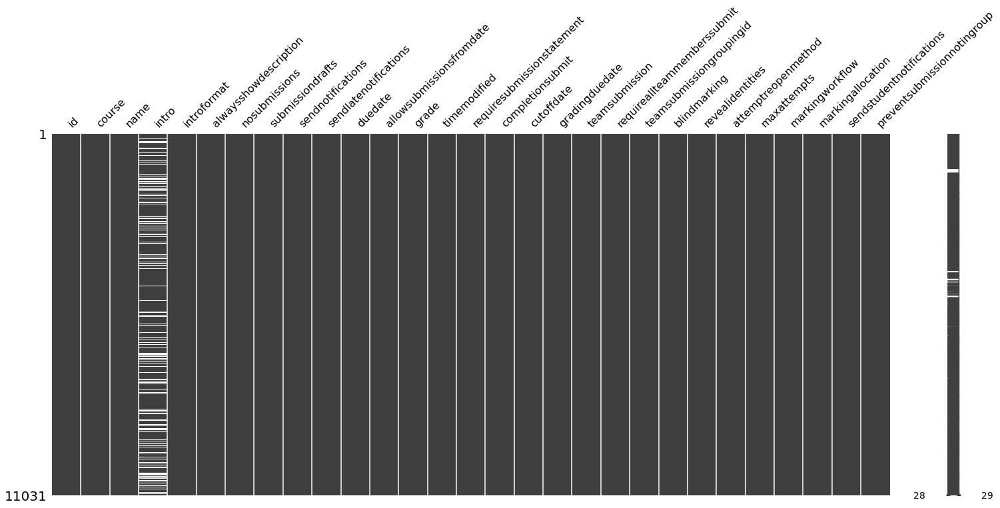

In [772]:
msno.matrix(assign_meta)

Selecting the relevant columns

In [773]:
assign_meta = assign_meta[['id','course','name','grade','timemodified']]

In [774]:
assign_meta

,id,course,name,grade,timemodified
0,1,4,Write an inline text,100,1515377733
1,2,4,Dropbox Paper Submission - Meaning making in p...,100,1543643384
2,3,4,Building defect knowledge game,100,1544847160
3,4,4,Defect portfolio video,100,1549695483
4,5,4,Defect Presentation 11th October 2017,100,1545625653
...,...,...,...,...,...
11026,13182,1613,Assignment,100,1577711108
11027,13183,1613,Imtihan,100,1577711263
11028,13184,1613,Imtihan Fiqih Ibadat,100,1577711312
11029,10916,3799,Group Assignment - Final Report Submission (Gr...,100,1577951482


In [775]:
assign_meta.course.nunique()

2458

In [776]:
assign_meta.grade.describe()

count    11031.000000
mean        91.664582
std         26.354981
min         -8.000000
25%        100.000000
50%        100.000000
75%        100.000000
max        100.000000
Name: grade, dtype: float64

In [777]:
assign_meta.grade.unique()

array([100,   0,   5,  15,  10,  20,  65,  25,  -2,  -3,   3,  80,  60,
        75,  40,   7,  12,  50,  30,   8,   4,  -1,  35,   1,  -6,  -5,
        -7,  -8,   2,   9,  70,  16], dtype=int64)

## Assignment grades

In [778]:
assignment_grades

,id,assignment,userid,timecreated,timemodified,grader,grade,attemptnumber
0,1,378,3213,1536750002,1536749769,2,-1.0,0
1,2,378,3006,1536750003,1536749811,2,-1.0,0
2,3,378,3119,1536750003,1536749816,2,-1.0,0
3,4,378,3118,1536750004,1536749821,2,-1.0,0
4,5,378,3005,1536750004,1536749950,2,-1.0,0
...,...,...,...,...,...,...,...,...
166096,180948,7155,20184,1605666483,1605666802,926,17.0,0
166097,180947,7151,20184,1605666162,1605667397,926,30.0,0
166098,180949,7579,11065,1605667904,1605668029,926,10.0,0
166099,180950,7579,19157,1605668115,1560900678,926,-1.0,0


In [779]:
assignment_grades.assignment.nunique()
assignment_grades.userid.nunique()

print("assignments graded <0")
print(assignment_grades[assignment_grades.grade<0].assignment.nunique()
      )

print("assignments graded=-1")
print(assignment_grades[assignment_grades.grade==-1].assignment.nunique())

assignments graded <0
6422
assignments graded=-1
6422


<AxesSubplot:>

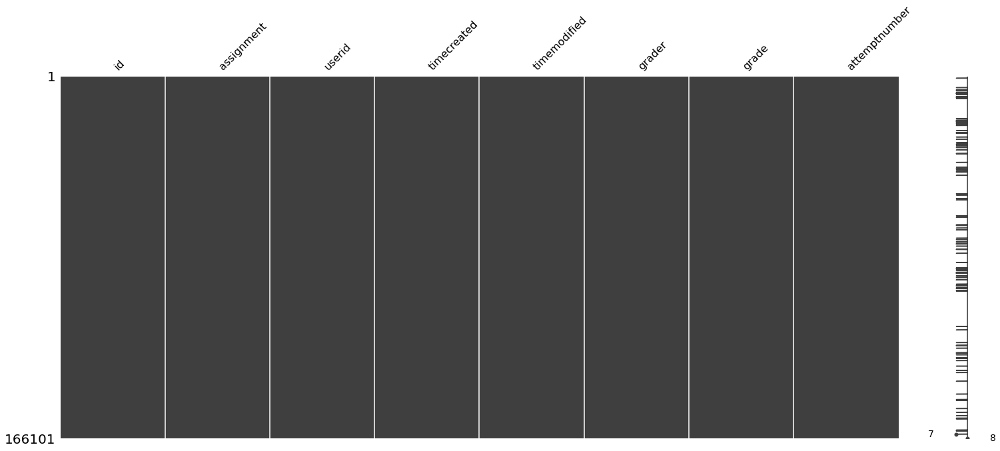

In [780]:
msno.matrix(assignment_grades)

In [781]:
assignment_grades.describe()

,id,assignment,userid,timecreated,timemodified,grader,grade,attemptnumber
count,166101.000000,166101.000000,166101.000000,1.661010e+05,1.661010e+05,166101.000000,165855.000000,166101.000000
mean,95661.414573,7225.889826,11223.647889,1.552435e+09,1.552648e+09,474.356133,2.269411,0.000247
std,50738.999432,3773.008914,6023.295174,6.652291e+06,6.644536e+06,3064.895220,15.100271,0.016088
min,1.000000,25.000000,32.000000,1.536750e+09,1.536750e+09,2.000000,-1.000000,0.000000
25%,55201.000000,3822.000000,6229.000000,1.545860e+09,1.546065e+09,2.000000,-1.000000,0.000000
50%,97345.000000,7909.000000,10522.000000,1.554473e+09,1.554630e+09,2.000000,-1.000000,0.000000
75%,139115.000000,10429.000000,15636.000000,1.557907e+09,1.558083e+09,2.000000,-1.000000,0.000000
max,180951.000000,13176.000000,28166.000000,1.616026e+09,1.616026e+09,27964.000000,100.000000,2.000000


In [782]:
print(assignment_grades[assignment_grades.grade>0].userid.nunique())
print(assignment_grades[assignment_grades.grade>0].assignment.nunique())
print(assignment_grades[assignment_grades.grade<0].assignment.nunique())
print(assignment_grades.assignment.nunique())
print(assignment_grades[assignment_grades.attemptnumber>1].assignment.nunique())

4963
618
6422
6851
1


In [783]:
fig = px.histogram(assignment_grades[assignment_grades.grade>0], x='grade')
fig.show()

In [784]:
#shape of dataframe
print(assignment_grades.shape)

#number of unique id's
print(assignment_grades.id.nunique())

#number of unique userid's
print(assignment_grades.userid.nunique())

#Checking number of unique assignments
print(assignment_grades.assignment.nunique())

#number of unique graders
print(assignment_grades.grader.nunique())

print('')
print('Attempt types')
#types of attempts
print(assignment_grades.attemptnumber.value_counts())

print('grades')
print(assignment_grades.grade.describe())

(166101, 8)
166101
17266
6851
363

Attempt types
0    166061
1        39
2         1
Name: attemptnumber, dtype: int64
grades
count    165855.000000
mean          2.269411
std          15.100271
min          -1.000000
25%          -1.000000
50%          -1.000000
75%          -1.000000
max         100.000000
Name: grade, dtype: float64


### Number of assignments per user

In [785]:
assignment_per_user_assignmentgrades = items_per_user(assignment_grades, 'assignment')

In [786]:
assignment_per_user_assignmentgrades

,userid,number_of_assignments
0,32,2
1,58,2
2,64,17
3,65,13
4,66,26
...,...,...
17261,28156,1
17262,28159,1
17263,28161,1
17264,28165,1


In [787]:
fig = px.scatter(assignment_per_user_assignmentgrades,
                 x="userid",
                 y="number_of_assignments",
                 color="number_of_assignments",
                 template=template)
fig.show()

In [788]:
assignment_per_user_assignmentgrades.describe()

,userid,number_of_assignments
count,17266.000000,17266.000000
mean,12087.402989,9.618035
std,6635.138300,10.694494
min,32.000000,1.000000
25%,6599.250000,3.000000
50%,11663.500000,6.000000
75%,16802.750000,12.000000
max,28166.000000,90.000000


In [789]:
assignment_per_user_assignmentgrades.number_of_assignments.mode()

0    4
Name: number_of_assignments, dtype: int64

In [790]:
assignment_per_user_assignmentgrades.number_of_assignments.value_counts()[0:5]

4    2010
3    1725
2    1718
1    1548
5    1173
Name: number_of_assignments, dtype: int64

Shah: So on average, each student has 9 assignments. The most assignments a student has is 90?! Can we do a histogram or box plot on this?

Zayan: Maybe the 90 assignment userid is not a student. Maybe someone from Citra or something? I think it's simply impossible for a student to have 90 assignments. Can we treat it as an outlier?

In [791]:
fig = px.histogram(assignment_per_user_assignmentgrades, x='number_of_assignments')
fig.show()

In [792]:
fig = px.box(assignment_per_user_assignmentgrades, y='number_of_assignments')
fig.show()

In [793]:
assignment_per_user_assignmentgrades.to_csv(f'{ppath}assignment_per_user.csv',index=False)

## Assignment submission

In [794]:
assignment_submission

,id,assignment,userid,timecreated,timemodified,status,groupid,attemptnumber,latest
0,1,29,30,1536036211,1536036211,new,0,0,1
1,2,36,1050,1536116105,1536116105,new,0,0,1
2,96223,6850,11257,1550732015,1550732015,new,0,0,1
3,10,15,47,1536286329,1536286329,new,0,0,1
4,99745,7300,6477,1551165200,1551191779,submitted,0,0,1
...,...,...,...,...,...,...,...,...,...
257888,282536,7316,6614,1620177302,1620177302,new,0,0,1
257889,282537,10454,6614,1620177379,1620177379,new,0,0,1
257890,282538,8906,4041,1620705086,1620705086,new,0,0,1
257891,282539,3454,10360,1621339410,1621339410,new,0,0,1


<AxesSubplot:>

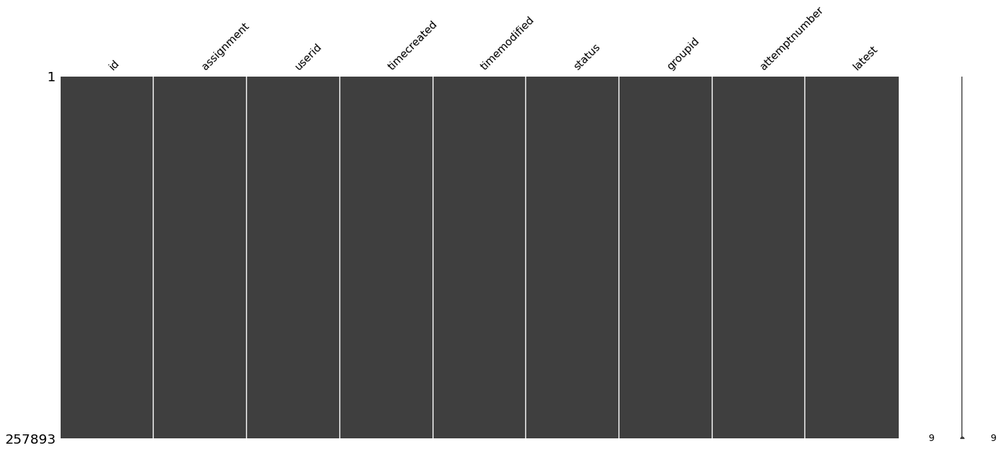

In [795]:
msno.matrix(assignment_submission)

In [796]:
assignment_submission.sort_values(by='userid', inplace=True)


In [797]:
#shape of dataframe
print(assignment_submission.shape)

#number of unique ids
print("id's:",assignment_submission.id.nunique())

#number of unique users
print("userid's:",assignment_submission.userid.nunique())

#number of unique assignments
print("assignments:",assignment_submission.assignment.nunique())

#number of unique groupid's
print("groupid's:",assignment_submission.groupid.nunique())

print('')

#number of submissions, drafts, etc
print('Status types')
print(assignment_submission.status.value_counts())

print('')

#number of unique attemptnumbers
print(assignment_submission.attemptnumber.value_counts())

(257893, 9)
id's: 257893
userid's: 19316
assignments: 8837
groupid's: 1132

Status types
submitted    160054
new           93595
draft          4231
reopened         13
Name: status, dtype: int64

0    257837
1        55
2         1
Name: attemptnumber, dtype: int64


Therefore, number of userid's in assignment_submission is greater than number of userid's in assignment_grades. So, everyone had not been graded?

Shah: Maybe some of the assignments are not graded online.

In [798]:
fig = px.histogram(assignment_submission, x='status', color='status')
fig.show()

### Number of assignments per user

In [799]:
assignment_submitted_per_user = items_per_user(assignment_submission, 'assignment')

In [800]:
assignment_submitted_per_user

,userid,number_of_assignments
0,0,509
1,5,5
2,6,6
3,7,10
4,9,9
...,...,...
19311,28206,3
19312,28214,2
19313,28216,1
19314,28223,1


In [801]:
fig = px.histogram(assignment_submitted_per_user[assignment_submitted_per_user.number_of_assignments<=40],
                 x="number_of_assignments",
                 template=template)
fig.show()

In [802]:
print(assignment_submitted_per_user.number_of_assignments.mode())

print(assignment_submitted_per_user.number_of_assignments.median())

print(assignment_submitted_per_user.number_of_assignments.max())

0    4
Name: number_of_assignments, dtype: int64
9.0
509


## Assignment user mapping

In [803]:
assignment_user_mapping

,id,assignment,userid
0,1,378,3009
1,2,378,3119
2,3,378,3213
3,4,378,3004
4,5,378,3006
...,...,...,...
545820,610345,5800,17253
545821,610346,5799,17253
545822,610347,5798,17253
545823,610348,5797,17253


In [804]:
#number of unique id's
print(assignment_user_mapping.id.nunique())

#number of unique userid's
print(assignment_user_mapping.userid.nunique())

#number of unique assignments
print(assignment_user_mapping.assignment.nunique())

545825
18882
6733


Comparing this dataframe to the assignment submissions and assignment grade tables, this dataframe has less number of assignments.

In [805]:
assignment_user_mapping.describe()

,id,assignment,userid
count,545825.000000,545825.000000,545825.000000
mean,328034.419825,8051.519837,11154.102016
std,170478.528129,3743.667159,5806.815164
min,1.000000,25.000000,32.000000
25%,197377.000000,4253.000000,5482.000000
50%,336115.000000,8996.000000,11377.000000
75%,473556.000000,11231.000000,16012.000000
max,610349.000000,13176.000000,28218.000000


### Number of assignments per user

In [806]:
assignment_per_user_usermapping = items_per_user(assignment_user_mapping, "assignment")

In [807]:
assignment_per_user_usermapping

,userid,number_of_assignments
0,32,2
1,58,2
2,64,34
3,65,34
4,66,51
...,...,...
18877,28214,1
18878,28215,1
18879,28216,1
18880,28217,1


In [808]:
fig = px.scatter(assignment_per_user_usermapping,
                 x="userid",
                 y="number_of_assignments",
                 color="number_of_assignments",
                 template=template)
fig.show()

In [809]:
assignment_per_user_usermapping.describe()

,userid,number_of_assignments
count,18882.000000,18882.000000
mean,12145.869929,28.907160
std,6760.306066,36.731127
min,32.000000,1.000000
25%,6529.250000,5.000000
50%,11661.500000,16.000000
75%,17022.750000,43.000000
max,28218.000000,263.000000


## Merging the assignment metadata and assignment grades

In [810]:
assign_meta

,id,course,name,grade,timemodified
0,1,4,Write an inline text,100,1515377733
1,2,4,Dropbox Paper Submission - Meaning making in p...,100,1543643384
2,3,4,Building defect knowledge game,100,1544847160
3,4,4,Defect portfolio video,100,1549695483
4,5,4,Defect Presentation 11th October 2017,100,1545625653
...,...,...,...,...,...
11026,13182,1613,Assignment,100,1577711108
11027,13183,1613,Imtihan,100,1577711263
11028,13184,1613,Imtihan Fiqih Ibadat,100,1577711312
11029,10916,3799,Group Assignment - Final Report Submission (Gr...,100,1577951482


In [811]:
assignment_grades

,id,assignment,userid,timecreated,timemodified,grader,grade,attemptnumber
0,1,378,3213,1536750002,1536749769,2,-1.0,0
1,2,378,3006,1536750003,1536749811,2,-1.0,0
2,3,378,3119,1536750003,1536749816,2,-1.0,0
3,4,378,3118,1536750004,1536749821,2,-1.0,0
4,5,378,3005,1536750004,1536749950,2,-1.0,0
...,...,...,...,...,...,...,...,...
166096,180948,7155,20184,1605666483,1605666802,926,17.0,0
166097,180947,7151,20184,1605666162,1605667397,926,30.0,0
166098,180949,7579,11065,1605667904,1605668029,926,10.0,0
166099,180950,7579,19157,1605668115,1560900678,926,-1.0,0


Renaming the id column in assign_meta

In [812]:
assign_meta.rename(columns={'id':'assignment'},inplace=True)

C:\Users\kople\AppData\Local\Temp\ipykernel_10416\1424496403.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [813]:
assignment_consolidated = assignment_grades.merge(assign_meta, on='assignment',how='inner')

In [814]:
assignment_consolidated.drop(columns=['timemodified_x','timemodified_y','timecreated','grader'],inplace=True)

In [815]:
assignment_consolidated.rename(columns={'grade_x':'grade_obtained','grade_y':'grademax'},inplace=True)

In [816]:
assignment_consolidated

,id,assignment,userid,grade_obtained,attemptnumber,course,name,grademax
0,1,378,3213,-1.0,0,157,What does the LIBRARY mean to you?,100
1,2,378,3006,-1.0,0,157,What does the LIBRARY mean to you?,100
2,3,378,3119,-1.0,0,157,What does the LIBRARY mean to you?,100
3,4,378,3118,-1.0,0,157,What does the LIBRARY mean to you?,100
4,5,378,3005,-1.0,0,157,What does the LIBRARY mean to you?,100
...,...,...,...,...,...,...,...,...
166096,180932,13160,3235,-1.0,0,4531,Assignment 2,10
166097,180934,13160,18777,-1.0,0,4531,Assignment 2,10
166098,180890,13176,8956,-1.0,0,3807,Test Marks Doubts,100
166099,180949,7579,11065,10.0,0,4179,Assignment 1,100


In [817]:
# rearranging the columns
assignment_consolidated = assignment_consolidated[['id','userid','assignment','course','name','attemptnumber','grademax','grade_obtained']]

In [818]:
assignment_consolidated

,id,userid,assignment,course,name,attemptnumber,grademax,grade_obtained
0,1,3213,378,157,What does the LIBRARY mean to you?,0,100,-1.0
1,2,3006,378,157,What does the LIBRARY mean to you?,0,100,-1.0
2,3,3119,378,157,What does the LIBRARY mean to you?,0,100,-1.0
3,4,3118,378,157,What does the LIBRARY mean to you?,0,100,-1.0
4,5,3005,378,157,What does the LIBRARY mean to you?,0,100,-1.0
...,...,...,...,...,...,...,...,...
166096,180932,3235,13160,4531,Assignment 2,0,10,-1.0
166097,180934,18777,13160,4531,Assignment 2,0,10,-1.0
166098,180890,8956,13176,3807,Test Marks Doubts,0,100,-1.0
166099,180949,11065,7579,4179,Assignment 1,0,100,10.0


In [819]:
assignment_consolidated[assignment_consolidated.grade_obtained!=-1.0]

,id,userid,assignment,course,name,attemptnumber,grademax,grade_obtained
468,61,7557,481,1647,Class Test No.1 12/9/2018,0,10,6.0
469,62,7558,481,1647,Class Test No.1 12/9/2018,0,10,3.0
470,63,7560,481,1647,Class Test No.1 12/9/2018,0,10,7.0
471,81,15424,481,1647,Class Test No.1 12/9/2018,0,10,7.0
472,65,7573,481,1647,Class Test No.1 12/9/2018,0,10,6.0
...,...,...,...,...,...,...,...,...
166068,180511,5151,7692,3306,TUTORIAL 5 (PPT & SHORT WRITEUP) 3/4/19,0,15,10.8
166069,180513,2389,7692,3306,TUTORIAL 5 (PPT & SHORT WRITEUP) 3/4/19,0,15,10.8
166070,180512,1907,7692,3306,TUTORIAL 5 (PPT & SHORT WRITEUP) 3/4/19,0,15,10.2
166071,180510,5167,7692,3306,TUTORIAL 5 (PPT & SHORT WRITEUP) 3/4/19,0,15,10.2


In [820]:
assignment_consolidated.to_csv(f'{ppath}assignment_consolidated.csv',index=False)

### no of assignments per user

In [821]:
assignment_per_user = items_per_user(assignment_consolidated,'assignment')
assignment_per_user.to_csv(f'{ppath}assignment_per_user.csv',index=False)

# Attendance related data

In [822]:
attendance = pd.read_csv(f'{path}attendance.csv')
attendance_log = pd.read_csv(f'{path}attendance_log.csv')

In [823]:
attendance

,id,course,name,grade,timemodified,intro,introformat,subnet,sessiondetailspos,showsessiondetails,showextrauserdetails
0,618,4306,Attendance,0,1550642310,<p>attendance record</p>,1,NaN,left,1,1
1,86,131,Attendance,0,1540867790,NaN,1,NaN,left,1,1
2,71,930,Attendance,0,1545206037,<p>19 December 2018</p>,1,NaN,left,1,1
3,38,690,Attendance,100,1536735850,NaN,1,NaN,left,1,1
4,14,2,Meeting Attendance,0,1532042427,NaN,1,NaN,left,1,1
...,...,...,...,...,...,...,...,...,...,...,...
691,528,3898,Attendance,0,1550458624,NaN,1,NaN,left,1,0
692,943,3194,Attendance,0,1572934468,NaN,1,NaN,left,1,1
693,944,3194,Attendance 100,100,1572935193,NaN,1,NaN,left,1,1
694,945,3195,Attendance FAD1014,100,1572935501,NaN,1,NaN,left,1,1


In [824]:
attendance_log.head()

,id,sessionid,studentid,statusid,statusset,timetaken,takenby,remarks,lat,lng,device
0,66539,3120,1353,2141,"2141,2144,2143,2142",1552263010,1353,NaN,3.118497,101.656339,1797E0FA-1F8A-4DF0-A017-014DAA9DFCCF
1,67107,2714,2391,1873,"1873,1876,1875,1874",1552273726,2391,NaN,3.118482,101.653908,A62DA22B-B079-4DD2-9BC4-E80A9D80124F
2,11,23,8,45,"45,47,48,46",1532048033,8,NaN,NaN,NaN,NaN
3,67340,4364,5014,1921,"1921,1924,1923,1922",1552274466,5014,NaN,3.118666,101.654030,BB3471C4-EFC0-4CAF-8C48-64596ABF4FEA
4,67582,2694,6418,1901,"1901,1904,1903,1902",1552280553,6418,Self-recorded,NaN,NaN,NaN


In [825]:
print(attendance.shape)
print(attendance_log.shape)

(696, 11)
(123407, 11)


In [826]:
print(attendance_log.studentid.nunique())

8946


## Number of sessions by a student

In [827]:
attendance_sessions_per_student = pd.DataFrame(attendance_log.groupby('studentid')['sessionid'].agg('count'))

In [828]:
type(attendance_sessions_per_student)

pandas.core.frame.DataFrame

In [829]:
attendance_sessions_per_student.rename(columns={'sessionid':'number_of_sessionids'},inplace=True)

In [830]:
attendance_sessions_per_student.to_csv(f'{ppath}attendance_sessions_per_student.csv')

In [831]:
attendance_sessions_per_student

,number_of_sessionids
studentid,
8,1
64,2
65,1
67,10
68,18
...,...
25981,11
25993,11
26207,10


In [832]:
attendance_sessions_per_student.describe()

,number_of_sessionids
count,8946.000000
mean,13.794657
std,11.991761
min,1.000000
25%,5.000000
50%,10.000000
75%,20.000000
max,78.000000


In [833]:
attendance_sessions_per_student[attendance_sessions_per_student.number_of_sessionids>30]

,number_of_sessionids
studentid,
1584,35
1658,35
1731,40
1756,38
1833,32
...,...
24429,31
24479,40
24557,31


In [834]:
fig = px.histogram(attendance_sessions_per_student[attendance_sessions_per_student.number_of_sessionids>0], x='number_of_sessionids')
fig.show()

# Course related data

## Courses

In [835]:
course = pd.read_csv(f'{path}course.csv')
course

,id,category,sortorder,fullname,shortname,idnumber,summary,summaryformat,format,showgrades,...,defaultgroupingid,lang,calendartype,theme,timecreated,timemodified,requested,enablecompletion,completionnotify,cacherev
0,5104,40,30001,Enhancing Research Impact,ERI,ERI,NaN,1,topics,1,...,0,NaN,NaN,NaN,1555295477,1555295477,0,1,0,1555301229
1,4298,18,390243,SIJ3004 Biokimia Klinikal Dan Fisiologi (Clini...,SIJ3004,SIJ3004,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1560508270
2,5114,18,390005,CNU046 Korean Listening And Speaking 1 (Korean...,CNU046,CNU046,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1555634911
3,2440,3,50026,GKN1001 Khidmat Komuniti (Community Service),GKN1001,GKN1001,"Session 2018/2019 Semester 2<br>(Group 1,2)",1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1540439630
4,3237,9,110051,EIE3007/ESEE3104 Rekabentuk Ujikaji (Experimen...,EIE3007,EIE3007,<p>Session 2018/2019</p>,1,topics,1,...,0,NaN,NaN,NaN,1548403431,1548403431,0,1,0,1548405378
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5176,4838,14,160062,MID3009 Kemahiran Kaunseling Untuk Jururawat (...,MID3009,MID3009,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1607304964
5177,3646,5,70016,BID2008 Teknik Dan Metodologi Perancangan (Pla...,BID2008,BID2008,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,0,NaN,NaN,NaN,0,1550732436,0,0,0,1615265015
5178,3139,18,390314,SHED3302 Kaedah Dalam Biologi Struktur (Struct...,SHED3302,SHED3302,Session 2018/2019 Semester 1,1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1616605617
5179,1129,18,390802,SHED3203 Teknologi Mikrob (Microbial Technology),SHED3203,SHED3203,Session 2018/2019 Semester 1,1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1616606004


In [836]:
course.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5181 entries, 0 to 5180
Data columns (total 31 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 5181 non-null   int64  
 1   category           5181 non-null   int64  
 2   sortorder          5181 non-null   int64  
 3   fullname           5181 non-null   object 
 4   shortname          5017 non-null   object 
 5   idnumber           4938 non-null   object 
 6   summary            5083 non-null   object 
 7   summaryformat      5181 non-null   int64  
 8   format             5181 non-null   object 
 9   showgrades         5181 non-null   int64  
 10  newsitems          5181 non-null   int64  
 11  startdate          5181 non-null   int64  
 12  enddate            5181 non-null   int64  
 13  marker             5181 non-null   int64  
 14  maxbytes           5181 non-null   int64  
 15  legacyfiles        5181 non-null   int64  
 16  showreports        5181 

Checking the categories

In [837]:
course.sort_values(by='category').category.unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 28, 32, 34, 35, 36, 37, 39,
       40, 41, 43, 46], dtype=int64)

In [838]:
course.category.nunique()

38

Note: id's: 29,30,31,42,44,45 do not exist

In [839]:
# How many of each format
print(course.format.value_counts())

print()
# Does it sum up to 5181?
print(f"sum of format value counts: {course.format.value_counts().sum()}")

topics            5056
grid                53
flexsections        36
weeks               23
singleactivity      10
socialwall           1
social               1
site                 1
Name: format, dtype: int64

sum of format value counts: 5181


## Course Categories

In [840]:
course_category = pd.read_csv(f'{path}course_categories.csv')

In [841]:
course_category.head()

,id,name,idnumber,description,descriptionformat,parent,sortorder,coursecount,visible,visibleold,timemodified,depth,path,theme
0,19,Faculty of Computer Science & Information Tech...,W,<p>Faculty of Computer Science &amp; Informati...,1,0,400000,195,1,1,1534731526,1,/19,NaN
1,7,Cultural Centre,R,<p>Cultural Centre</p>,1,0,90000,156,1,1,1534731833,1,/7,NaN
2,12,Faculty of Languages and Linguistics,T,<p>Faculty of Languages and Linguistics</p>,1,0,130000,402,1,1,1534731132,1,/12,NaN
3,40,Epigeum,NaN,NaN,1,1,30000,1,0,1,1555295432,2,/1/40,NaN
4,11,Faculty of Engineering,K,<p>Faculty of Engineering</p>,1,0,120000,442,1,1,1534731102,1,/11,NaN


In [842]:
course_category.sort_values("id", inplace=True)
course_category.reset_index(inplace=True, drop=True)
course_category.head()

,id,name,idnumber,description,descriptionformat,parent,sortorder,coursecount,visible,visibleold,timemodified,depth,path,theme
0,1,Miscellaneous,NaN,NaN,0,0,10000,5,0,0,1507886688,1,/1,NaN
1,2,Foundation Studies in Science,F,<p>Foundation Studies in Science</p>,1,0,40000,40,1,1,1534731414,1,/2,NaN
2,3,University,G,<p>University</p>,1,0,50000,53,1,1,1534731481,1,/3,NaN
3,4,Faculty of Arts and Social Sciences,A,<p>Faculty of Arts and Social Sciences</p>,1,0,60000,644,1,1,1534730840,1,/4,NaN
4,5,Faculty of Built Enviroment,B,<p>Faculty of Built Enviroment</p>,1,0,70000,232,1,1,1534731788,1,/5,NaN


In [843]:
# unique category id'
print(course_category.id.unique())

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46]


id 29 does not exist

In [844]:
pd.DataFrame(course_category.name.unique())

,0
0,Miscellaneous
1,Foundation Studies in Science
2,University
3,Faculty of Arts and Social Sciences
4,Faculty of Built Enviroment
5,Faculty of Business and Accountancy
6,Cultural Centre
7,Faculty of Dentistry
8,Faculty of Economics & Administration
9,Faculty of Education


## Course module completion

In [845]:
course_completion = pd.read_csv(f'{path}course_module_completion.csv')
course_completion

,id,coursemoduleid,userid,completionstate,viewed,timemodified
0,55,7475,14638,1,1,1536767923
1,2,6182,6,1,1,1536674375
2,3,6211,6,1,1,1536719141
3,4,6211,6135,1,1,1536719704
4,5,6211,6136,1,1,1536719740
...,...,...,...,...,...,...
40721,42809,142558,1062,0,0,1605582372
40722,42810,82549,2652,1,1,1615354136
40723,42811,82551,2652,1,1,1615354155
40724,42812,86671,2652,1,1,1615354188


In [846]:
course_completion.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40726 entries, 0 to 40725
Data columns (total 6 columns):
 #   Column           Non-Null Count  Dtype
---  ------           --------------  -----
 0   id               40726 non-null  int64
 1   coursemoduleid   40726 non-null  int64
 2   userid           40726 non-null  int64
 3   completionstate  40726 non-null  int64
 4   viewed           40726 non-null  int64
 5   timemodified     40726 non-null  int64
dtypes: int64(6)
memory usage: 1.9 MB


In [847]:
#number of unique courses
print(course_completion.coursemoduleid.nunique())

#number of unique users
print(course_completion.userid.nunique())

#checking if users have not completed courses
print(course_completion.completionstate.value_counts())

1827
2915
1    39745
0      980
2        1
Name: completionstate, dtype: int64


 (Not enough data)
Therefore, 980 students have not completed the course. Begs the question; is this data referring to the course completion survey? This would be true if the table is set up so that if a user has completed the survey, the completionstate becomes 1.

Another question: Are the 980 users actually instructors?

2915 students completed 1827 courses

# GDataFramelated data

In [848]:
grades = pd.read_csv(f'{path}grades.csv')

In [849]:
grades.head()


,id,itemid,userid,rawgrade,rawgrademax,rawgrademin,rawscaleid,usermodified,finalgrade,hidden,...,overridden,excluded,feedback,feedbackformat,information,informationformat,timecreated,timemodified,aggregationstatus,aggregationweight
0,48156,4690,16356,NaN,100.0,0.0,NaN,16356.0,NaN,0,...,0,0,NaN,0,NaN,0,1.539539e+09,NaN,novalue,0.0
1,22563,1459,3058,NaN,100.0,0.0,NaN,NaN,100.0,0,...,0,0,NaN,0,NaN,0,NaN,1.538378e+09,unknown,NaN
2,407,630,4720,NaN,100.0,0.0,NaN,4720.0,NaN,0,...,0,0,NaN,0,NaN,0,1.544367e+09,NaN,novalue,0.0
3,386,629,1948,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
4,387,630,1948,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0


In [850]:
grades.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1223314 entries, 0 to 1223313
Data columns (total 23 columns):
 #   Column             Non-Null Count    Dtype  
---  ------             --------------    -----  
 0   id                 1223314 non-null  int64  
 1   itemid             1223314 non-null  int64  
 2   userid             1223314 non-null  int64  
 3   rawgrade           80056 non-null    float64
 4   rawgrademax        1223314 non-null  float64
 5   rawgrademin        1223314 non-null  float64
 6   rawscaleid         252 non-null      float64
 7   usermodified       239558 non-null   float64
 8   finalgrade         113636 non-null   float64
 9   hidden             1223314 non-null  int64  
 10  locked             1223314 non-null  int64  
 11  locktime           1223314 non-null  int64  
 12  exported           1223314 non-null  int64  
 13  overridden         1223314 non-null  int64  
 14  excluded           1223314 non-null  int64  
 15  feedback           3044 non-null

In [851]:
grades.describe()

,id,itemid,userid,rawgrade,rawgrademax,rawgrademin,rawscaleid,usermodified,finalgrade,hidden,...,locktime,exported,overridden,excluded,feedbackformat,information,informationformat,timecreated,timemodified,aggregationweight
count,1.223314e+06,1.223314e+06,1.223314e+06,80056.000000,1.223314e+06,1.223314e+06,252.000000,239558.000000,113636.000000,1.223314e+06,...,1223314.0,1223314.0,1.223314e+06,1223314.0,1.223314e+06,0.0,1223314.0,1.999210e+05,1.156050e+05,1.136849e+06
mean,8.050681e+05,1.408961e+04,1.184431e+04,25.101277,7.958312e+01,3.768452e-04,1.805556,10282.247973,36.303812,7.896583e-04,...,0.0,0.0,2.307104e+06,0.0,4.258923e-03,NaN,0.0,1.552918e+09,1.553327e+09,2.707704e-02
std,4.060868e+05,6.485650e+03,6.357090e+03,32.691182,4.041421e+01,1.940885e-02,0.854965,6734.282363,63.021061,2.808977e-02,...,0.0,0.0,5.981915e+07,0.0,6.512133e-02,NaN,0.0,6.335991e+06,6.288772e+06,1.382681e-01
min,1.800000e+01,1.900000e+01,5.000000e+00,0.000000,0.000000e+00,0.000000e+00,1.000000,2.000000,0.000000,0.000000e+00,...,0.0,0.0,0.000000e+00,0.0,0.000000e+00,NaN,0.0,1.536742e+09,1.536553e+09,0.000000e+00
25%,4.881562e+05,8.762000e+03,6.108000e+03,8.000000,1.000000e+02,0.000000e+00,1.000000,4830.000000,8.500000,0.000000e+00,...,0.0,0.0,0.000000e+00,0.0,0.000000e+00,NaN,0.0,1.550996e+09,1.550558e+09,0.000000e+00
50%,8.223105e+05,1.685900e+04,1.219500e+04,10.000000,1.000000e+02,0.000000e+00,2.000000,9295.000000,10.000000,0.000000e+00,...,0.0,0.0,0.000000e+00,0.0,0.000000e+00,NaN,0.0,1.554713e+09,1.554866e+09,0.000000e+00
75%,1.142621e+06,1.976200e+04,1.638400e+04,20.000000,1.000000e+02,0.000000e+00,2.000000,14947.750000,63.514250,0.000000e+00,...,0.0,0.0,0.000000e+00,0.0,0.000000e+00,NaN,0.0,1.557907e+09,1.558377e+09,0.000000e+00
max,1.481988e+06,2.322000e+04,2.821700e+04,850.000000,2.600000e+03,1.000000e+00,5.000000,28217.000000,2550.000000,1.000000e+00,...,0.0,0.0,1.560990e+09,0.0,1.000000e+00,NaN,0.0,1.566041e+09,1.605668e+09,1.000000e+00


In [852]:
grades.sort_values(by='id')

,id,itemid,userid,rawgrade,rawgrademax,rawgrademin,rawscaleid,usermodified,finalgrade,hidden,...,overridden,excluded,feedback,feedbackformat,information,informationformat,timecreated,timemodified,aggregationstatus,aggregationweight
10,18,406,8543,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,unknown,NaN
12,20,406,8736,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,unknown,NaN
13,22,406,8722,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,unknown,NaN
15,24,406,8614,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,unknown,NaN
18,26,406,8536,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,unknown,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223308,1481984,20285,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
1223309,1481985,20287,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
1223311,1481986,21126,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
1223312,1481987,21461,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0


In [853]:
#number of unique id's
print("number of unique ids" )
print(grades.id.nunique())

#number of unique userid's
print("number of unique USERIDs")
print(grades.userid.nunique())

#number of unique items
print("number of unique items")
print(grades.itemid.nunique())

# number of final grades > 0
print("number of final grades > 0")
print(grades.finalgrade[grades.finalgrade>0].shape)

#shape of entire dataframe
print("shape of Gdata")
print(grades.shape)

number of unique ids
1223314
number of unique USERIDs
18697
number of unique items
14136
number of final grades > 0
(111281,)
shape of Gdata
(1223314, 23)


Missing values

<AxesSubplot:>

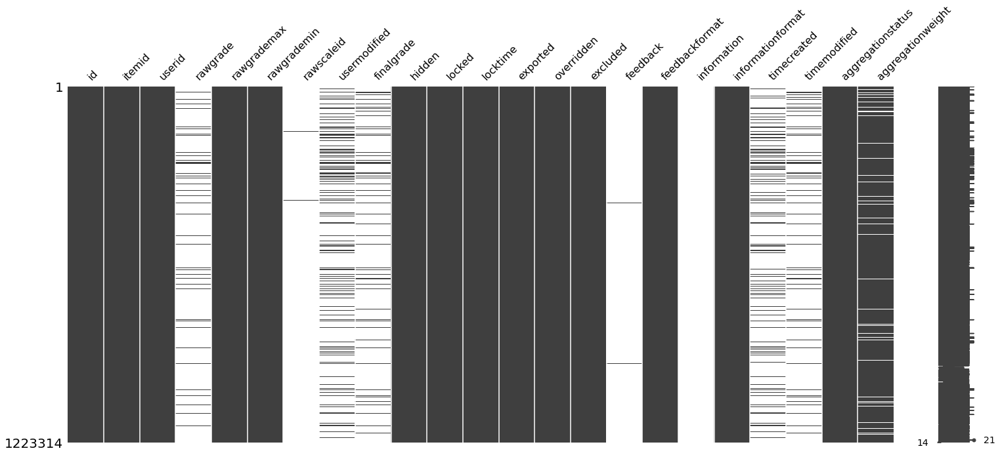

In [854]:
msno.matrix(grades)

Barplot of grade distribution

In [855]:
fig = px.histogram(grades, x="finalgrade")
fig.show()

Focusing on grades <100

In [856]:
grades_below100 = grades[grades.finalgrade<100]
fig = px.histogram(grades_below100, x="finalgrade")
fig.show()

Pie chart

In [857]:
# create bins
bins = np.arange(0,105,10)

# Create a new column to represent the grade range for each student
grades_below100["Grade range"] = pd.cut(grades_below100.finalgrade, bins=bins, labels=[f'{bins[i]}-{bins[i+1]}' for i in range(len(bins)-1)])

# Calculate the count of students in each grade range
grade_counts = grades_below100["Grade range"].value_counts().sort_index()

# create pie chart
fig = px.pie(
    names=grade_counts.index,
    values=grade_counts.values,
    title="Distribution of Student Grades",
)

# Show the pie chart
fig.show()

C:\Users\kople\AppData\Local\Temp\ipykernel_10416\1982078453.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Grade_items

In [858]:
grade_items = pd.read_csv(f'{path}grade_items.csv')
grade_items

,id,courseid,categoryid,itemname,itemtype,itemmodule,iteminstance,itemnumber,iteminfo,idnumber,...,sortorder,display,decimals,hidden,locked,locktime,needsupdate,weightoverride,timecreated,timemodified
0,136,57,38.0,Tutorial 2 Submission,mod,assign,40.0,0.0,NaN,NaN,...,34,0,NaN,0,0,0,0,0,1536132254,1536132254
1,4985,2319,NaN,NaN,course,NaN,1941.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,1,0,1539739182,1539739182
2,181,72,41.0,Submission of Assignment 1: Screen Shots - DEA...,mod,assign,82.0,0.0,NaN,NaN,...,2,0,NaN,0,0,0,1,0,1536133724,1536133724
3,21,81,5.0,TUTORIAL 2,mod,assign,8.0,0.0,NaN,NaN,...,2,0,NaN,1,0,0,0,0,1535424693,1537439536
4,2688,2064,NaN,NaN,course,NaN,1241.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,0,0,1538147356,1541058001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19500,23236,36,NaN,NaN,course,NaN,4441.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,1,0,1610678265,1610678265
19501,15622,3646,3475.0,Tutorial Week 3,mod,assign,8058.0,0.0,NaN,NaN,...,12,0,NaN,1,0,0,0,0,1551838554,1615264921
19502,16958,3646,3475.0,Tutorial Week 5 BID2008,mod,assign,8852.0,0.0,NaN,NaN,...,13,0,NaN,1,0,0,0,0,1552951845,1615264934
19503,17534,3646,3475.0,Tutorial Week 6 and 7 (BID2008),mod,assign,9249.0,0.0,NaN,NaN,...,14,0,NaN,1,0,0,0,0,1553481781,1615264950


In [859]:
grade_items.sort_values('id',inplace=True)
grade_items.reset_index(inplace=True, drop=True)

grade_items

,id,courseid,categoryid,itemname,itemtype,itemmodule,iteminstance,itemnumber,iteminfo,idnumber,...,sortorder,display,decimals,hidden,locked,locktime,needsupdate,weightoverride,timecreated,timemodified
0,14,2,NaN,NaN,course,NaN,4.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,0,0,1527124806,1527124865
1,15,2,4.0,TEST MARK,mod,quiz,2.0,0.0,NaN,NaN,...,2,0,NaN,0,0,0,0,0,1527124865,1527124865
2,19,81,NaN,NaN,course,NaN,5.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,1,0,1505813081,1554704459
3,21,81,5.0,TUTORIAL 2,mod,assign,8.0,0.0,NaN,NaN,...,2,0,NaN,1,0,0,0,0,1535424693,1537439536
4,22,81,5.0,TUTORIAL 3,mod,assign,9.0,0.0,NaN,NaN,...,3,0,NaN,1,0,0,0,0,1535424693,1538725328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19500,23232,4624,3717.0,quiz,mod,quiz,2496.0,0.0,NaN,NaN,...,2,0,NaN,0,0,0,0,0,1577790063,1577790405
19501,23233,4624,3717.0,quiz,mod,quiz,2497.0,0.0,NaN,NaN,...,3,0,NaN,0,0,0,0,0,1577790076,1577790405
19502,23234,4624,3717.0,bengkel 1 (submission),mod,workshop,137.0,0.0,NaN,NaN,...,4,0,NaN,0,0,0,0,0,1577790405,1577790405
19503,23235,4624,3717.0,bengkel 1 (assessment),mod,workshop,137.0,1.0,NaN,NaN,...,5,0,NaN,0,0,0,0,0,1577790405,1577790405


In [860]:
grade_items.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19505 entries, 0 to 19504
Data columns (total 31 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                19505 non-null  int64  
 1   courseid          19505 non-null  int64  
 2   categoryid        15268 non-null  float64
 3   itemname          15257 non-null  object 
 4   itemtype          19505 non-null  object 
 5   itemmodule        15240 non-null  object 
 6   iteminstance      19477 non-null  float64
 7   itemnumber        15268 non-null  float64
 8   iteminfo          1 non-null      object 
 9   idnumber          89 non-null     object 
 10  calculation       0 non-null      float64
 11  gradetype         19505 non-null  int64  
 12  grademax          19505 non-null  float64
 13  grademin          19505 non-null  float64
 14  scaleid           30 non-null     float64
 15  outcomeid         3 non-null      float64
 16  gradepass         19505 non-null  float6

<AxesSubplot:>

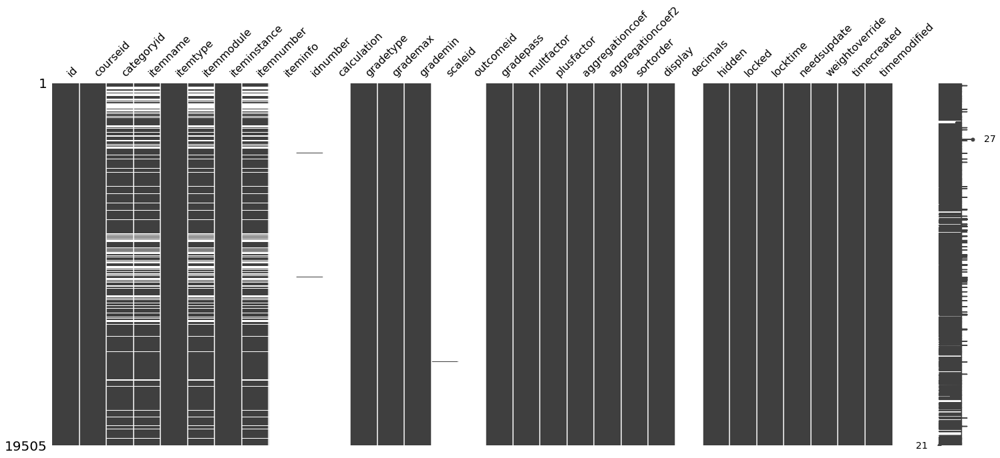

In [861]:
msno.matrix(grade_items)

In [862]:
grade_items.describe()

,id,courseid,categoryid,iteminstance,itemnumber,calculation,gradetype,grademax,grademin,scaleid,...,sortorder,display,decimals,hidden,locked,locktime,needsupdate,weightoverride,timecreated,timemodified
count,19505.000000,19505.000000,15268.000000,19477.000000,15268.000000,0.0,19505.000000,19505.000000,19505.000000,30.000000,...,19505.000000,19505.000000,2.0,1.950500e+04,19505.0,19505.0,19505.000000,19505.000000,1.950500e+04,1.950500e+04
mean,12021.722738,2676.035940,2071.678019,4619.904246,0.203825,NaN,1.014407,113.167983,0.001538,2.766667,...,16.865727,0.000051,1.0,6.909326e+07,0.0,0.0,0.041835,0.001999,1.547092e+09,1.551417e+09
std,6681.890900,1494.821618,1315.865265,3994.839003,14.030723,NaN,0.213009,189.139002,0.039189,1.906130,...,52.820854,0.007160,0.0,3.196346e+08,0.0,0.0,0.200218,0.044672,1.587800e+07,1.411976e+07
min,14.000000,1.000000,4.000000,1.000000,0.000000,NaN,0.000000,0.000000,0.000000,1.000000,...,1.000000,0.000000,1.0,0.000000e+00,0.0,0.0,0.000000,0.000000,1.283737e+09,1.318001e+09
25%,6276.000000,1519.000000,768.750000,1123.000000,0.000000,NaN,1.000000,100.000000,0.000000,2.000000,...,2.000000,0.000000,1.0,0.000000e+00,0.0,0.0,0.000000,0.000000,1.541316e+09,1.545359e+09
50%,12239.000000,2566.000000,2293.000000,3342.000000,0.000000,NaN,1.000000,100.000000,0.000000,2.000000,...,4.000000,0.000000,1.0,0.000000e+00,0.0,0.0,0.000000,0.000000,1.550325e+09,1.553015e+09
75%,17848.000000,3990.000000,3148.000000,7895.000000,0.000000,NaN,1.000000,100.000000,0.000000,3.750000,...,10.000000,0.000000,1.0,0.000000e+00,0.0,0.0,0.000000,0.000000,1.553740e+09,1.558378e+09
max,23236.000000,5287.000000,4437.000000,13184.000000,1002.000000,NaN,3.000000,6920.000000,1.000000,8.000000,...,558.000000,1.000000,1.0,1.699505e+09,0.0,0.0,1.000000,1.000000,1.664130e+09,1.730452e+09


In [863]:
grade_items.itemname = grade_items.itemname.str.lower()
grade_items

,id,courseid,categoryid,itemname,itemtype,itemmodule,iteminstance,itemnumber,iteminfo,idnumber,...,sortorder,display,decimals,hidden,locked,locktime,needsupdate,weightoverride,timecreated,timemodified
0,14,2,NaN,NaN,course,NaN,4.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,0,0,1527124806,1527124865
1,15,2,4.0,test mark,mod,quiz,2.0,0.0,NaN,NaN,...,2,0,NaN,0,0,0,0,0,1527124865,1527124865
2,19,81,NaN,NaN,course,NaN,5.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,1,0,1505813081,1554704459
3,21,81,5.0,tutorial 2,mod,assign,8.0,0.0,NaN,NaN,...,2,0,NaN,1,0,0,0,0,1535424693,1537439536
4,22,81,5.0,tutorial 3,mod,assign,9.0,0.0,NaN,NaN,...,3,0,NaN,1,0,0,0,0,1535424693,1538725328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19500,23232,4624,3717.0,quiz,mod,quiz,2496.0,0.0,NaN,NaN,...,2,0,NaN,0,0,0,0,0,1577790063,1577790405
19501,23233,4624,3717.0,quiz,mod,quiz,2497.0,0.0,NaN,NaN,...,3,0,NaN,0,0,0,0,0,1577790076,1577790405
19502,23234,4624,3717.0,bengkel 1 (submission),mod,workshop,137.0,0.0,NaN,NaN,...,4,0,NaN,0,0,0,0,0,1577790405,1577790405
19503,23235,4624,3717.0,bengkel 1 (assessment),mod,workshop,137.0,1.0,NaN,NaN,...,5,0,NaN,0,0,0,0,0,1577790405,1577790405


In [864]:
grade_items.itemtype.unique()

array(['course', 'mod', 'category', 'manual'], dtype=object)

In [865]:
# count the number of different types of items
itemtype_count_total = grade_items.itemtype.value_counts()

# count the number of different types of items only for items with names
itemtype_count_w_itemname = grade_items[grade_items.itemname.notna()].itemtype.value_counts()

print(f"number of different types of items:\n {itemtype_count_total} \n")
print(f"number of different types of items that DO HAVE A NAME:\n {itemtype_count_w_itemname}")

print()
# number of unique courses
print(f"number of unique courses: {grade_items.courseid.nunique()}")

# number of unique categories
print(f"number of unique categories: {grade_items.categoryid.nunique()}")
print()
# number of unique item types
print(f"Itemtypes: {grade_items.itemtype.unique()}")
print()
# number of unique item modules
print(f"Itemmodules: {grade_items.itemmodule.unique()}")
print()
# info on max grades
print(f"number of unique max grades: {grade_items.grademax.nunique()}")

number of different types of items:
 mod         15240
course       4218
manual         28
category       19
Name: itemtype, dtype: int64 

number of different types of items that DO HAVE A NAME:
 mod       15228
manual       28
course        1
Name: itemtype, dtype: int64

number of unique courses: 4218
number of unique categories: 2740

Itemtypes: ['course' 'mod' 'category' 'manual']

Itemmodules: [nan 'quiz' 'assign' 'lti' 'assignment' 'turnitintool' 'attendance'
 'turnitintooltwo' 'lesson' 'workshop' 'hvp' 'questionnaire' 'forum'
 'glossary' 'scorm' 'data']

number of unique max grades: 218


Note that when the items don't have a name, the itemtype is course

# Joining Grade, Grade_items, course, course category

First inspect all the dataframes

In [866]:
grades

,id,itemid,userid,rawgrade,rawgrademax,rawgrademin,rawscaleid,usermodified,finalgrade,hidden,...,overridden,excluded,feedback,feedbackformat,information,informationformat,timecreated,timemodified,aggregationstatus,aggregationweight
0,48156,4690,16356,NaN,100.0,0.0,NaN,16356.0,NaN,0,...,0,0,NaN,0,NaN,0,1.539539e+09,NaN,novalue,0.0
1,22563,1459,3058,NaN,100.0,0.0,NaN,NaN,100.0,0,...,0,0,NaN,0,NaN,0,NaN,1.538378e+09,unknown,NaN
2,407,630,4720,NaN,100.0,0.0,NaN,4720.0,NaN,0,...,0,0,NaN,0,NaN,0,1.544367e+09,NaN,novalue,0.0
3,386,629,1948,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
4,387,630,1948,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223309,1481985,20287,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
1223310,1481969,20414,18767,NaN,30.0,0.0,NaN,18767.0,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
1223311,1481986,21126,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
1223312,1481987,21461,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0


In [867]:
grade_items.head()

,id,courseid,categoryid,itemname,itemtype,itemmodule,iteminstance,itemnumber,iteminfo,idnumber,...,sortorder,display,decimals,hidden,locked,locktime,needsupdate,weightoverride,timecreated,timemodified
0,14,2,NaN,NaN,course,NaN,4.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,0,0,1527124806,1527124865
1,15,2,4.0,test mark,mod,quiz,2.0,0.0,NaN,NaN,...,2,0,NaN,0,0,0,0,0,1527124865,1527124865
2,19,81,NaN,NaN,course,NaN,5.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,1,0,1505813081,1554704459
3,21,81,5.0,tutorial 2,mod,assign,8.0,0.0,NaN,NaN,...,2,0,NaN,1,0,0,0,0,1535424693,1537439536
4,22,81,5.0,tutorial 3,mod,assign,9.0,0.0,NaN,NaN,...,3,0,NaN,1,0,0,0,0,1535424693,1538725328


In [868]:
print(grades.itemid.nunique())

print(grade_items.id.nunique())

print(grade_items.courseid.nunique())

14136
19505
4218


In [869]:
course.head()

,id,category,sortorder,fullname,shortname,idnumber,summary,summaryformat,format,showgrades,...,defaultgroupingid,lang,calendartype,theme,timecreated,timemodified,requested,enablecompletion,completionnotify,cacherev
0,5104,40,30001,Enhancing Research Impact,ERI,ERI,NaN,1,topics,1,...,0,NaN,NaN,NaN,1555295477,1555295477,0,1,0,1555301229
1,4298,18,390243,SIJ3004 Biokimia Klinikal Dan Fisiologi (Clini...,SIJ3004,SIJ3004,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1560508270
2,5114,18,390005,CNU046 Korean Listening And Speaking 1 (Korean...,CNU046,CNU046,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1555634911
3,2440,3,50026,GKN1001 Khidmat Komuniti (Community Service),GKN1001,GKN1001,"Session 2018/2019 Semester 2<br>(Group 1,2)",1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1540439630
4,3237,9,110051,EIE3007/ESEE3104 Rekabentuk Ujikaji (Experimen...,EIE3007,EIE3007,<p>Session 2018/2019</p>,1,topics,1,...,0,NaN,NaN,NaN,1548403431,1548403431,0,1,0,1548405378


In [870]:
course_category.head()

,id,name,idnumber,description,descriptionformat,parent,sortorder,coursecount,visible,visibleold,timemodified,depth,path,theme
0,1,Miscellaneous,NaN,NaN,0,0,10000,5,0,0,1507886688,1,/1,NaN
1,2,Foundation Studies in Science,F,<p>Foundation Studies in Science</p>,1,0,40000,40,1,1,1534731414,1,/2,NaN
2,3,University,G,<p>University</p>,1,0,50000,53,1,1,1534731481,1,/3,NaN
3,4,Faculty of Arts and Social Sciences,A,<p>Faculty of Arts and Social Sciences</p>,1,0,60000,644,1,1,1534730840,1,/4,NaN
4,5,Faculty of Built Enviroment,B,<p>Faculty of Built Enviroment</p>,1,0,70000,232,1,1,1534731788,1,/5,NaN


Now join the grade and grade items dataframes. We'll join the course and course_category dataframes afterwards

## Merging the grade and gradeitems df's first

In [871]:
grades[grades.itemid.isna()].shape

(0, 23)

In [872]:
grade_items.rename(columns={'id':'itemid'},inplace=True)

In [873]:
grade_items

,itemid,courseid,categoryid,itemname,itemtype,itemmodule,iteminstance,itemnumber,iteminfo,idnumber,...,sortorder,display,decimals,hidden,locked,locktime,needsupdate,weightoverride,timecreated,timemodified
0,14,2,NaN,NaN,course,NaN,4.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,0,0,1527124806,1527124865
1,15,2,4.0,test mark,mod,quiz,2.0,0.0,NaN,NaN,...,2,0,NaN,0,0,0,0,0,1527124865,1527124865
2,19,81,NaN,NaN,course,NaN,5.0,NaN,NaN,NaN,...,1,0,NaN,0,0,0,1,0,1505813081,1554704459
3,21,81,5.0,tutorial 2,mod,assign,8.0,0.0,NaN,NaN,...,2,0,NaN,1,0,0,0,0,1535424693,1537439536
4,22,81,5.0,tutorial 3,mod,assign,9.0,0.0,NaN,NaN,...,3,0,NaN,1,0,0,0,0,1535424693,1538725328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19500,23232,4624,3717.0,quiz,mod,quiz,2496.0,0.0,NaN,NaN,...,2,0,NaN,0,0,0,0,0,1577790063,1577790405
19501,23233,4624,3717.0,quiz,mod,quiz,2497.0,0.0,NaN,NaN,...,3,0,NaN,0,0,0,0,0,1577790076,1577790405
19502,23234,4624,3717.0,bengkel 1 (submission),mod,workshop,137.0,0.0,NaN,NaN,...,4,0,NaN,0,0,0,0,0,1577790405,1577790405
19503,23235,4624,3717.0,bengkel 1 (assessment),mod,workshop,137.0,1.0,NaN,NaN,...,5,0,NaN,0,0,0,0,0,1577790405,1577790405


Do all the itemids in grade exist in grade_items?

In [874]:
grade_itemids = grades.itemid.unique()

grade_itemids_X_gradeitems = []
print("grade items (from grades df) that don't exist in grade_items df")
for id in grade_itemids:
    if id not in grade_items.itemid.unique():
        print(id)
        grade_itemids_X_gradeitems.append(id)

grade items (from grades df) that don't exist in grade_items df
3370
3252


16733
21799
16769
18195


How many rows of the grades df do these particular grade items occupy?

In [875]:
grades[grades.itemid.isin(grade_itemids_X_gradeitems)].shape

(1402, 23)

It's a big portion. So we will keep this itemids. Merging the two dfs below

In [876]:
grades_consolidated = grades.merge(grade_items, on='itemid', how='left')

In [877]:
grades_consolidated

,id,itemid,userid,rawgrade,rawgrademax,rawgrademin,rawscaleid,usermodified,finalgrade,hidden_x,...,sortorder,display,decimals,hidden_y,locked_y,locktime_y,needsupdate,weightoverride,timecreated_y,timemodified_y
0,48156,4690,16356,NaN,100.0,0.0,NaN,16356.0,NaN,0,...,7.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.539240e+09,1.544772e+09
1,22563,1459,3058,NaN,100.0,0.0,NaN,NaN,100.0,0,...,1.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.536844e+09,1.545027e+09
2,407,630,4720,NaN,100.0,0.0,NaN,4720.0,NaN,0,...,4.0,0.0,NaN,1.0,0.0,0.0,0.0,0.0,1.536469e+09,1.545471e+09
3,386,629,1948,NaN,100.0,0.0,NaN,NaN,NaN,0,...,3.0,0.0,NaN,1.0,0.0,0.0,0.0,0.0,1.536469e+09,1.545471e+09
4,387,630,1948,NaN,100.0,0.0,NaN,NaN,NaN,0,...,4.0,0.0,NaN,1.0,0.0,0.0,0.0,0.0,1.536469e+09,1.545471e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223309,1481985,20287,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,30.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.556702e+09,1.568353e+09
1223310,1481969,20414,18767,NaN,30.0,0.0,NaN,18767.0,NaN,0,...,31.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.556849e+09,1.568353e+09
1223311,1481986,21126,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,34.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.557712e+09,1.568353e+09
1223312,1481987,21461,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,35.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,1.557885e+09,1.568353e+09


In [878]:
grades

,id,itemid,userid,rawgrade,rawgrademax,rawgrademin,rawscaleid,usermodified,finalgrade,hidden,...,overridden,excluded,feedback,feedbackformat,information,informationformat,timecreated,timemodified,aggregationstatus,aggregationweight
0,48156,4690,16356,NaN,100.0,0.0,NaN,16356.0,NaN,0,...,0,0,NaN,0,NaN,0,1.539539e+09,NaN,novalue,0.0
1,22563,1459,3058,NaN,100.0,0.0,NaN,NaN,100.0,0,...,0,0,NaN,0,NaN,0,NaN,1.538378e+09,unknown,NaN
2,407,630,4720,NaN,100.0,0.0,NaN,4720.0,NaN,0,...,0,0,NaN,0,NaN,0,1.544367e+09,NaN,novalue,0.0
3,386,629,1948,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
4,387,630,1948,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223309,1481985,20287,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
1223310,1481969,20414,18767,NaN,30.0,0.0,NaN,18767.0,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
1223311,1481986,21126,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0
1223312,1481987,21461,18767,NaN,100.0,0.0,NaN,NaN,NaN,0,...,0,0,NaN,0,NaN,0,NaN,NaN,novalue,0.0


In [879]:
print(grades.shape)
print(grades_consolidated.shape)

(1223314, 23)
(1223314, 53)


Now we need to remove the irrelevant columns or conversely, include only the relevant columns

In [880]:
grades_consolidated.columns

Index(['id', 'itemid', 'userid', 'rawgrade', 'rawgrademax', 'rawgrademin',
       'rawscaleid', 'usermodified', 'finalgrade', 'hidden_x', 'locked_x',
       'locktime_x', 'exported', 'overridden', 'excluded', 'feedback',
       'feedbackformat', 'information', 'informationformat', 'timecreated_x',
       'timemodified_x', 'aggregationstatus', 'aggregationweight', 'courseid',
       'categoryid', 'itemname', 'itemtype', 'itemmodule', 'iteminstance',
       'itemnumber', 'iteminfo', 'idnumber', 'calculation', 'gradetype',
       'grademax', 'grademin', 'scaleid', 'outcomeid', 'gradepass',
       'multfactor', 'plusfactor', 'aggregationcoef', 'aggregationcoef2',
       'sortorder', 'display', 'decimals', 'hidden_y', 'locked_y',
       'locktime_y', 'needsupdate', 'weightoverride', 'timecreated_y',
       'timemodified_y'],
      dtype='object')

In [881]:
grades_consolidated = grades_consolidated[['id','userid','courseid','itemid','itemname','itemtype','itemmodule','scaleid','grademax', 'rawgrademax','rawgrade','finalgrade']]
grades_consolidated

,id,userid,courseid,itemid,itemname,itemtype,itemmodule,scaleid,grademax,rawgrademax,rawgrade,finalgrade
0,48156,16356,131.0,4690,g1 submit tutorial 5 - normalization,mod,assign,NaN,100.0,100.0,NaN,NaN
1,22563,3058,60.0,1459,NaN,course,NaN,NaN,1400.0,100.0,NaN,100.0
2,407,4720,1559.0,630,retail visit video: a typical operating day at...,mod,assign,NaN,100.0,100.0,NaN,NaN
3,386,1948,1559.0,629,retail group project: my ________ store,mod,assign,NaN,100.0,100.0,NaN,NaN
4,387,1948,1559.0,630,retail visit video: a typical operating day at...,mod,assign,NaN,100.0,100.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
1223309,1481985,18767,2446.0,20287,business pitching rubric,mod,assign,NaN,100.0,100.0,NaN,NaN
1223310,1481969,18767,2446.0,20414,quiz - 30%,mod,quiz,NaN,30.0,30.0,NaN,NaN
1223311,1481986,18767,2446.0,21126,video link for business plan.,mod,assign,NaN,100.0,100.0,NaN,NaN
1223312,1481987,18767,2446.0,21461,case study assignment (group work),mod,assign,NaN,100.0,100.0,NaN,NaN


<AxesSubplot:>

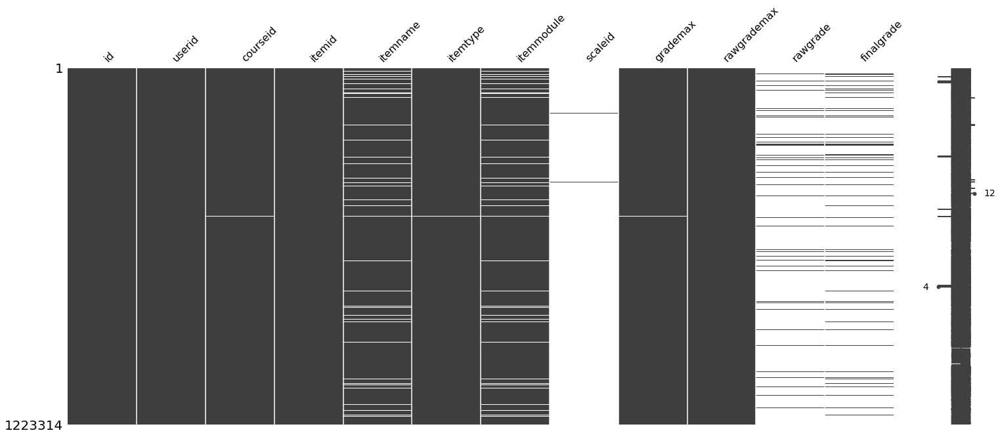

In [882]:
msno.matrix(grades_consolidated)

In [883]:
grades_consolidated.to_csv(f'{ppath}grades_consolidated.csv',index=False)

## Merging the course and course_categories df's

In [884]:
course.head()

,id,category,sortorder,fullname,shortname,idnumber,summary,summaryformat,format,showgrades,...,defaultgroupingid,lang,calendartype,theme,timecreated,timemodified,requested,enablecompletion,completionnotify,cacherev
0,5104,40,30001,Enhancing Research Impact,ERI,ERI,NaN,1,topics,1,...,0,NaN,NaN,NaN,1555295477,1555295477,0,1,0,1555301229
1,4298,18,390243,SIJ3004 Biokimia Klinikal Dan Fisiologi (Clini...,SIJ3004,SIJ3004,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1560508270
2,5114,18,390005,CNU046 Korean Listening And Speaking 1 (Korean...,CNU046,CNU046,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1555634911
3,2440,3,50026,GKN1001 Khidmat Komuniti (Community Service),GKN1001,GKN1001,"Session 2018/2019 Semester 2<br>(Group 1,2)",1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1540439630
4,3237,9,110051,EIE3007/ESEE3104 Rekabentuk Ujikaji (Experimen...,EIE3007,EIE3007,<p>Session 2018/2019</p>,1,topics,1,...,0,NaN,NaN,NaN,1548403431,1548403431,0,1,0,1548405378


In [885]:
course_category.head()

,id,name,idnumber,description,descriptionformat,parent,sortorder,coursecount,visible,visibleold,timemodified,depth,path,theme
0,1,Miscellaneous,NaN,NaN,0,0,10000,5,0,0,1507886688,1,/1,NaN
1,2,Foundation Studies in Science,F,<p>Foundation Studies in Science</p>,1,0,40000,40,1,1,1534731414,1,/2,NaN
2,3,University,G,<p>University</p>,1,0,50000,53,1,1,1534731481,1,/3,NaN
3,4,Faculty of Arts and Social Sciences,A,<p>Faculty of Arts and Social Sciences</p>,1,0,60000,644,1,1,1534730840,1,/4,NaN
4,5,Faculty of Built Enviroment,B,<p>Faculty of Built Enviroment</p>,1,0,70000,232,1,1,1534731788,1,/5,NaN


We'll join on the id column of the category dataframe. First we'll have to change the names of the columns so that they match.

In [886]:
course_category.index

RangeIndex(start=0, stop=45, step=1)

Currently the id columns is the index and so we won't be able to rename it.

In [887]:
course_category.reset_index(inplace=True)
course_category

,index,id,name,idnumber,description,descriptionformat,parent,sortorder,coursecount,visible,visibleold,timemodified,depth,path,theme
0,0,1,Miscellaneous,NaN,NaN,0,0,10000,5,0,0,1507886688,1,/1,NaN
1,1,2,Foundation Studies in Science,F,<p>Foundation Studies in Science</p>,1,0,40000,40,1,1,1534731414,1,/2,NaN
2,2,3,University,G,<p>University</p>,1,0,50000,53,1,1,1534731481,1,/3,NaN
3,3,4,Faculty of Arts and Social Sciences,A,<p>Faculty of Arts and Social Sciences</p>,1,0,60000,644,1,1,1534730840,1,/4,NaN
4,4,5,Faculty of Built Enviroment,B,<p>Faculty of Built Enviroment</p>,1,0,70000,232,1,1,1534731788,1,/5,NaN
5,5,6,Faculty of Business and Accountancy,C,<p>Faculty of Business and Accountancy</p>,1,0,80000,180,1,1,1534731808,1,/6,NaN
6,6,7,Cultural Centre,R,<p>Cultural Centre</p>,1,0,90000,156,1,1,1534731833,1,/7,NaN
7,7,8,Faculty of Dentistry,D,NaN,1,0,100000,83,1,1,1534731841,1,/8,NaN
8,8,9,Faculty of Economics & Administration,E,<p>Faculty of Economics &amp; Administration</p>,1,0,110000,158,1,1,1534731859,1,/9,NaN
9,9,10,Faculty of Education,P,NaN,1,0,140000,394,1,1,1534731147,1,/10,NaN


In [888]:
course_category.rename(columns={'id':'category'},inplace=True)

In [889]:
course_category.drop(columns='index',inplace=True)

In [890]:
course_category.head()

,category,name,idnumber,description,descriptionformat,parent,sortorder,coursecount,visible,visibleold,timemodified,depth,path,theme
0,1,Miscellaneous,NaN,NaN,0,0,10000,5,0,0,1507886688,1,/1,NaN
1,2,Foundation Studies in Science,F,<p>Foundation Studies in Science</p>,1,0,40000,40,1,1,1534731414,1,/2,NaN
2,3,University,G,<p>University</p>,1,0,50000,53,1,1,1534731481,1,/3,NaN
3,4,Faculty of Arts and Social Sciences,A,<p>Faculty of Arts and Social Sciences</p>,1,0,60000,644,1,1,1534730840,1,/4,NaN
4,5,Faculty of Built Enviroment,B,<p>Faculty of Built Enviroment</p>,1,0,70000,232,1,1,1534731788,1,/5,NaN


Now we can merge

In [891]:
course.head()

,id,category,sortorder,fullname,shortname,idnumber,summary,summaryformat,format,showgrades,...,defaultgroupingid,lang,calendartype,theme,timecreated,timemodified,requested,enablecompletion,completionnotify,cacherev
0,5104,40,30001,Enhancing Research Impact,ERI,ERI,NaN,1,topics,1,...,0,NaN,NaN,NaN,1555295477,1555295477,0,1,0,1555301229
1,4298,18,390243,SIJ3004 Biokimia Klinikal Dan Fisiologi (Clini...,SIJ3004,SIJ3004,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1560508270
2,5114,18,390005,CNU046 Korean Listening And Speaking 1 (Korean...,CNU046,CNU046,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1555634911
3,2440,3,50026,GKN1001 Khidmat Komuniti (Community Service),GKN1001,GKN1001,"Session 2018/2019 Semester 2<br>(Group 1,2)",1,topics,1,...,0,NaN,NaN,NaN,0,0,0,0,0,1540439630
4,3237,9,110051,EIE3007/ESEE3104 Rekabentuk Ujikaji (Experimen...,EIE3007,EIE3007,<p>Session 2018/2019</p>,1,topics,1,...,0,NaN,NaN,NaN,1548403431,1548403431,0,1,0,1548405378


In [892]:
course_info= course.merge(course_category, on='category',how='left')

In [893]:
# course_info.head()
course_info

,id,category,sortorder_x,fullname,shortname,idnumber_x,summary,summaryformat,format,showgrades,...,descriptionformat,parent,sortorder_y,coursecount,visible_y,visibleold_y,timemodified_y,depth,path,theme_y
0,5104,40,30001,Enhancing Research Impact,ERI,ERI,NaN,1,topics,1,...,1.0,1.0,30000.0,1.0,0.0,1.0,1.555295e+09,2.0,/1/40,NaN
1,4298,18,390243,SIJ3004 Biokimia Klinikal Dan Fisiologi (Clini...,SIJ3004,SIJ3004,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,390000.0,968.0,1.0,1.0,1.534732e+09,1.0,/18,NaN
2,5114,18,390005,CNU046 Korean Listening And Speaking 1 (Korean...,CNU046,CNU046,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,390000.0,968.0,1.0,1.0,1.534732e+09,1.0,/18,NaN
3,2440,3,50026,GKN1001 Khidmat Komuniti (Community Service),GKN1001,GKN1001,"Session 2018/2019 Semester 2<br>(Group 1,2)",1,topics,1,...,1.0,0.0,50000.0,53.0,1.0,1.0,1.534731e+09,1.0,/3,NaN
4,3237,9,110051,EIE3007/ESEE3104 Rekabentuk Ujikaji (Experimen...,EIE3007,EIE3007,<p>Session 2018/2019</p>,1,topics,1,...,1.0,0.0,110000.0,158.0,1.0,1.0,1.534732e+09,1.0,/9,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5176,4838,14,160062,MID3009 Kemahiran Kaunseling Untuk Jururawat (...,MID3009,MID3009,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,160000.0,297.0,1.0,1.0,1.534731e+09,1.0,/14,NaN
5177,3646,5,70016,BID2008 Teknik Dan Metodologi Perancangan (Pla...,BID2008,BID2008,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,70000.0,232.0,1.0,1.0,1.534732e+09,1.0,/5,NaN
5178,3139,18,390314,SHED3302 Kaedah Dalam Biologi Struktur (Struct...,SHED3302,SHED3302,Session 2018/2019 Semester 1,1,topics,1,...,1.0,0.0,390000.0,968.0,1.0,1.0,1.534732e+09,1.0,/18,NaN
5179,1129,18,390802,SHED3203 Teknologi Mikrob (Microbial Technology),SHED3203,SHED3203,Session 2018/2019 Semester 1,1,topics,1,...,1.0,0.0,390000.0,968.0,1.0,1.0,1.534732e+09,1.0,/18,NaN


In [894]:
course_info.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5181 entries, 0 to 5180
Data columns (total 44 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 5181 non-null   int64  
 1   category           5181 non-null   int64  
 2   sortorder_x        5181 non-null   int64  
 3   fullname           5181 non-null   object 
 4   shortname          5017 non-null   object 
 5   idnumber_x         4938 non-null   object 
 6   summary            5083 non-null   object 
 7   summaryformat      5181 non-null   int64  
 8   format             5181 non-null   object 
 9   showgrades         5181 non-null   int64  
 10  newsitems          5181 non-null   int64  
 11  startdate          5181 non-null   int64  
 12  enddate            5181 non-null   int64  
 13  marker             5181 non-null   int64  
 14  maxbytes           5181 non-null   int64  
 15  legacyfiles        5181 non-null   int64  
 16  showreports        5181 

In [895]:
course_info.sort_values("id", inplace=True)
course_info

,id,category,sortorder_x,fullname,shortname,idnumber_x,summary,summaryformat,format,showgrades,...,descriptionformat,parent,sortorder_y,coursecount,visible_y,visibleold_y,timemodified_y,depth,path,theme_y
3392,1,0,1,SPeCTRUM V3,spectrumv3,NaN,"<p><strong>University of Malaya, </strong>or U...",0,site,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4078,2,3,50053,FS Management Minutes 2017,FS2017,NaN,Faculty Management Minutes 2017,1,topics,1,...,1.0,0.0,50000.0,53.0,1.0,1.0,1.534731e+09,1.0,/3,NaN
4723,6,17,380082,VIX1001 Sejarah Dan Falsafah Sukan (History An...,VIX1001,VIX1001,Session 2018/2019 Semester 1<br>(Group 1),1,topics,1,...,1.0,0.0,380000.0,82.0,1.0,1.0,1.534731e+09,1.0,/17,NaN
3351,7,17,380081,VIA1003 Prinsip Asas Ekonomi Dan Kewangan (Bas...,VIA1003,VIA1003,Session 2018/2019 Semester 1<br>(Group 1),1,topics,1,...,1.0,0.0,380000.0,82.0,1.0,1.0,1.534731e+09,1.0,/17,NaN
1376,8,17,380080,VIA2003/VSEM2202 Ekonomi Sukan (Sport Economy),VIA2003,VIA2003,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,380000.0,82.0,1.0,1.0,1.534731e+09,1.0,/17,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
597,5286,20,0,TSKU003 Introduction To Islam (Introduction To...,TSKU003,TSKU003,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,410000.0,385.0,1.0,1.0,1.534732e+09,1.0,/20,NaN
296,5287,20,0,TSKU004 Printing Practices 1 (Printing Practic...,TSKU004,TSKU004,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,410000.0,385.0,1.0,1.0,1.534732e+09,1.0,/20,NaN
1378,5288,4,0,GUK042 L1 Listening & Speaking (L1 Listening &...,GUK042,GUK042,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,60000.0,644.0,1.0,1.0,1.534731e+09,1.0,/4,NaN
1372,5289,4,0,CNU079 Korean Listening And Speaking 1 (Korean...,CNU079,CNU079,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,60000.0,644.0,1.0,1.0,1.534731e+09,1.0,/4,NaN


In [896]:
course_info.reset_index(inplace=True, drop=True)
course_info

,id,category,sortorder_x,fullname,shortname,idnumber_x,summary,summaryformat,format,showgrades,...,descriptionformat,parent,sortorder_y,coursecount,visible_y,visibleold_y,timemodified_y,depth,path,theme_y
0,1,0,1,SPeCTRUM V3,spectrumv3,NaN,"<p><strong>University of Malaya, </strong>or U...",0,site,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,3,50053,FS Management Minutes 2017,FS2017,NaN,Faculty Management Minutes 2017,1,topics,1,...,1.0,0.0,50000.0,53.0,1.0,1.0,1.534731e+09,1.0,/3,NaN
2,6,17,380082,VIX1001 Sejarah Dan Falsafah Sukan (History An...,VIX1001,VIX1001,Session 2018/2019 Semester 1<br>(Group 1),1,topics,1,...,1.0,0.0,380000.0,82.0,1.0,1.0,1.534731e+09,1.0,/17,NaN
3,7,17,380081,VIA1003 Prinsip Asas Ekonomi Dan Kewangan (Bas...,VIA1003,VIA1003,Session 2018/2019 Semester 1<br>(Group 1),1,topics,1,...,1.0,0.0,380000.0,82.0,1.0,1.0,1.534731e+09,1.0,/17,NaN
4,8,17,380080,VIA2003/VSEM2202 Ekonomi Sukan (Sport Economy),VIA2003,VIA2003,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,380000.0,82.0,1.0,1.0,1.534731e+09,1.0,/17,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5176,5286,20,0,TSKU003 Introduction To Islam (Introduction To...,TSKU003,TSKU003,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,410000.0,385.0,1.0,1.0,1.534732e+09,1.0,/20,NaN
5177,5287,20,0,TSKU004 Printing Practices 1 (Printing Practic...,TSKU004,TSKU004,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,410000.0,385.0,1.0,1.0,1.534732e+09,1.0,/20,NaN
5178,5288,4,0,GUK042 L1 Listening & Speaking (L1 Listening &...,GUK042,GUK042,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,60000.0,644.0,1.0,1.0,1.534731e+09,1.0,/4,NaN
5179,5289,4,0,CNU079 Korean Listening And Speaking 1 (Korean...,CNU079,CNU079,Session 2018/2019 Semester 2<br>(Group 1),1,topics,1,...,1.0,0.0,60000.0,644.0,1.0,1.0,1.534731e+09,1.0,/4,NaN


In [897]:
course_consolidated = course_info[['id','category','shortname','name']]

In [898]:
course_consolidated

,id,category,shortname,name
0,1,0,spectrumv3,NaN
1,2,3,FS2017,University
2,6,17,VIX1001,Sport Centre
3,7,17,VIA1003,Sport Centre
4,8,17,VIA2003,Sport Centre
...,...,...,...,...
5176,5286,20,TSKU003,Academy of Islamic Studies
5177,5287,20,TSKU004,Academy of Islamic Studies
5178,5288,4,GUK042,Faculty of Arts and Social Sciences
5179,5289,4,CNU079,Faculty of Arts and Social Sciences


In [899]:
course_consolidated.rename(columns={'name':'faculty','shortname':'code'},inplace=True)

C:\Users\kople\AppData\Local\Temp\ipykernel_10416\722905123.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [900]:
course_consolidated

,id,category,code,faculty
0,1,0,spectrumv3,NaN
1,2,3,FS2017,University
2,6,17,VIX1001,Sport Centre
3,7,17,VIA1003,Sport Centre
4,8,17,VIA2003,Sport Centre
...,...,...,...,...
5176,5286,20,TSKU003,Academy of Islamic Studies
5177,5287,20,TSKU004,Academy of Islamic Studies
5178,5288,4,GUK042,Faculty of Arts and Social Sciences
5179,5289,4,CNU079,Faculty of Arts and Social Sciences


In [901]:
course_consolidated.to_csv(f'{ppath}course_consolidated.csv',index=False)

In [902]:
print(course.id.nunique())
print(course_consolidated.index.nunique())
print(course_consolidated.category.nunique())
print(course_consolidated.faculty.nunique())

5181
5181
38
37


## Merge the grades_consolidated and course_consolidated dataframes

In [903]:
grades_consolidated

,id,userid,courseid,itemid,itemname,itemtype,itemmodule,scaleid,grademax,rawgrademax,rawgrade,finalgrade
0,48156,16356,131.0,4690,g1 submit tutorial 5 - normalization,mod,assign,NaN,100.0,100.0,NaN,NaN
1,22563,3058,60.0,1459,NaN,course,NaN,NaN,1400.0,100.0,NaN,100.0
2,407,4720,1559.0,630,retail visit video: a typical operating day at...,mod,assign,NaN,100.0,100.0,NaN,NaN
3,386,1948,1559.0,629,retail group project: my ________ store,mod,assign,NaN,100.0,100.0,NaN,NaN
4,387,1948,1559.0,630,retail visit video: a typical operating day at...,mod,assign,NaN,100.0,100.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
1223309,1481985,18767,2446.0,20287,business pitching rubric,mod,assign,NaN,100.0,100.0,NaN,NaN
1223310,1481969,18767,2446.0,20414,quiz - 30%,mod,quiz,NaN,30.0,30.0,NaN,NaN
1223311,1481986,18767,2446.0,21126,video link for business plan.,mod,assign,NaN,100.0,100.0,NaN,NaN
1223312,1481987,18767,2446.0,21461,case study assignment (group work),mod,assign,NaN,100.0,100.0,NaN,NaN


In [904]:
course_consolidated.head()

,id,category,code,faculty
0,1,0,spectrumv3,NaN
1,2,3,FS2017,University
2,6,17,VIX1001,Sport Centre
3,7,17,VIA1003,Sport Centre
4,8,17,VIA2003,Sport Centre


In [905]:
grades_consolidated.courseid.nunique()

2016

We can merge on the course columns of the grades_consolidated, which would be the id column of the course_consolidated df.

In [906]:
course_consolidated.rename(columns={'id':'courseid'},inplace=True)

C:\Users\kople\AppData\Local\Temp\ipykernel_10416\4165011901.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [907]:
course_consolidated

,courseid,category,code,faculty
0,1,0,spectrumv3,NaN
1,2,3,FS2017,University
2,6,17,VIX1001,Sport Centre
3,7,17,VIA1003,Sport Centre
4,8,17,VIA2003,Sport Centre
...,...,...,...,...
5176,5286,20,TSKU003,Academy of Islamic Studies
5177,5287,20,TSKU004,Academy of Islamic Studies
5178,5288,4,GUK042,Faculty of Arts and Social Sciences
5179,5289,4,CNU079,Faculty of Arts and Social Sciences


In [908]:
grades_courses = grades_consolidated.merge(course_consolidated, on='courseid', how='left')

In [909]:
grades_courses

,id,userid,courseid,itemid,itemname,itemtype,itemmodule,scaleid,grademax,rawgrademax,rawgrade,finalgrade,category,code,faculty
0,48156,16356,131.0,4690,g1 submit tutorial 5 - normalization,mod,assign,NaN,100.0,100.0,NaN,NaN,19.0,WXES2114,Faculty of Computer Science & Information Tech...
1,22563,3058,60.0,1459,NaN,course,NaN,NaN,1400.0,100.0,NaN,100.0,19.0,WIX3004,Faculty of Computer Science & Information Tech...
2,407,4720,1559.0,630,retail visit video: a typical operating day at...,mod,assign,NaN,100.0,100.0,NaN,NaN,6.0,CIF2002,Faculty of Business and Accountancy
3,386,1948,1559.0,629,retail group project: my ________ store,mod,assign,NaN,100.0,100.0,NaN,NaN,6.0,CIF2002,Faculty of Business and Accountancy
4,387,1948,1559.0,630,retail visit video: a typical operating day at...,mod,assign,NaN,100.0,100.0,NaN,NaN,6.0,CIF2002,Faculty of Business and Accountancy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223309,1481985,18767,2446.0,20287,business pitching rubric,mod,assign,NaN,100.0,100.0,NaN,NaN,3.0,GIG1003,University
1223310,1481969,18767,2446.0,20414,quiz - 30%,mod,quiz,NaN,30.0,30.0,NaN,NaN,3.0,GIG1003,University
1223311,1481986,18767,2446.0,21126,video link for business plan.,mod,assign,NaN,100.0,100.0,NaN,NaN,3.0,GIG1003,University
1223312,1481987,18767,2446.0,21461,case study assignment (group work),mod,assign,NaN,100.0,100.0,NaN,NaN,3.0,GIG1003,University


In [910]:
grades_courses.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1223314 entries, 0 to 1223313
Data columns (total 15 columns):
 #   Column       Non-Null Count    Dtype  
---  ------       --------------    -----  
 0   id           1223314 non-null  int64  
 1   userid       1223314 non-null  int64  
 2   courseid     1221912 non-null  float64
 3   itemid       1223314 non-null  int64  
 4   itemname     1136853 non-null  object 
 5   itemtype     1221912 non-null  object 
 6   itemmodule   1135845 non-null  object 
 7   scaleid      555 non-null      float64
 8   grademax     1221912 non-null  float64
 9   rawgrademax  1223314 non-null  float64
 10  rawgrade     80056 non-null    float64
 11  finalgrade   113636 non-null   float64
 12  category     1221912 non-null  float64
 13  code         1221912 non-null  object 
 14  faculty      1221912 non-null  object 
dtypes: float64(7), int64(3), object(5)
memory usage: 149.3+ MB


rearrange the columns

In [911]:
grades_courses = grades_courses[['id','userid','courseid','code','category','faculty','itemid','itemname','itemtype','itemmodule','grademax','rawgrademax','rawgrade','scaleid','finalgrade']]

In [912]:
grades_courses.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1223314 entries, 0 to 1223313
Data columns (total 15 columns):
 #   Column       Non-Null Count    Dtype  
---  ------       --------------    -----  
 0   id           1223314 non-null  int64  
 1   userid       1223314 non-null  int64  
 2   courseid     1221912 non-null  float64
 3   code         1221912 non-null  object 
 4   category     1221912 non-null  float64
 5   faculty      1221912 non-null  object 
 6   itemid       1223314 non-null  int64  
 7   itemname     1136853 non-null  object 
 8   itemtype     1221912 non-null  object 
 9   itemmodule   1135845 non-null  object 
 10  grademax     1221912 non-null  float64
 11  rawgrademax  1223314 non-null  float64
 12  rawgrade     80056 non-null    float64
 13  scaleid      555 non-null      float64
 14  finalgrade   113636 non-null   float64
dtypes: float64(7), int64(3), object(5)
memory usage: 149.3+ MB


In [913]:
grades_courses

,id,userid,courseid,code,category,faculty,itemid,itemname,itemtype,itemmodule,grademax,rawgrademax,rawgrade,scaleid,finalgrade
0,48156,16356,131.0,WXES2114,19.0,Faculty of Computer Science & Information Tech...,4690,g1 submit tutorial 5 - normalization,mod,assign,100.0,100.0,NaN,NaN,NaN
1,22563,3058,60.0,WIX3004,19.0,Faculty of Computer Science & Information Tech...,1459,NaN,course,NaN,1400.0,100.0,NaN,NaN,100.0
2,407,4720,1559.0,CIF2002,6.0,Faculty of Business and Accountancy,630,retail visit video: a typical operating day at...,mod,assign,100.0,100.0,NaN,NaN,NaN
3,386,1948,1559.0,CIF2002,6.0,Faculty of Business and Accountancy,629,retail group project: my ________ store,mod,assign,100.0,100.0,NaN,NaN,NaN
4,387,1948,1559.0,CIF2002,6.0,Faculty of Business and Accountancy,630,retail visit video: a typical operating day at...,mod,assign,100.0,100.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223309,1481985,18767,2446.0,GIG1003,3.0,University,20287,business pitching rubric,mod,assign,100.0,100.0,NaN,NaN,NaN
1223310,1481969,18767,2446.0,GIG1003,3.0,University,20414,quiz - 30%,mod,quiz,30.0,30.0,NaN,NaN,NaN
1223311,1481986,18767,2446.0,GIG1003,3.0,University,21126,video link for business plan.,mod,assign,100.0,100.0,NaN,NaN,NaN
1223312,1481987,18767,2446.0,GIG1003,3.0,University,21461,case study assignment (group work),mod,assign,100.0,100.0,NaN,NaN,NaN


In [914]:
grades_courses.sort_values("id",inplace=True)
grades_courses

,id,userid,courseid,code,category,faculty,itemid,itemname,itemtype,itemmodule,grademax,rawgrademax,rawgrade,scaleid,finalgrade
10,18,8543,538.0,KIE1004,11.0,Faculty of Engineering,406,NaN,course,NaN,0.0,100.0,NaN,NaN,NaN
12,20,8736,538.0,KIE1004,11.0,Faculty of Engineering,406,NaN,course,NaN,0.0,100.0,NaN,NaN,NaN
13,22,8722,538.0,KIE1004,11.0,Faculty of Engineering,406,NaN,course,NaN,0.0,100.0,NaN,NaN,NaN
15,24,8614,538.0,KIE1004,11.0,Faculty of Engineering,406,NaN,course,NaN,0.0,100.0,NaN,NaN,NaN
18,26,8536,538.0,KIE1004,11.0,Faculty of Engineering,406,NaN,course,NaN,0.0,100.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1223308,1481984,18767,2446.0,GIG1003,3.0,University,20285,assignment submission for value proposition,mod,assign,100.0,100.0,NaN,NaN,NaN
1223309,1481985,18767,2446.0,GIG1003,3.0,University,20287,business pitching rubric,mod,assign,100.0,100.0,NaN,NaN,NaN
1223311,1481986,18767,2446.0,GIG1003,3.0,University,21126,video link for business plan.,mod,assign,100.0,100.0,NaN,NaN,NaN
1223312,1481987,18767,2446.0,GIG1003,3.0,University,21461,case study assignment (group work),mod,assign,100.0,100.0,NaN,NaN,NaN


In [915]:
grades_courses.to_csv(f'{ppath}grades_courses.csv',index=False)

## no of courses per user

In [916]:
grades_courses.groupby('userid')['courseid'].agg('count')

userid
5        10
7        17
9        25
27       11
32       26
         ..
28204     4
28206     4
28214     3
28216     7
28217     3
Name: courseid, Length: 18697, dtype: int64

In [917]:
grades_courses.loc[grades_courses.userid==71].head()

,id,userid,courseid,code,category,faculty,itemid,itemname,itemtype,itemmodule,grademax,rawgrademax,rawgrade,scaleid,finalgrade
118265,467071,71,4503.0,WIG3004,19.0,Faculty of Computer Science & Information Tech...,14350,submission tutorial 1,mod,assign,100.0,100.0,NaN,NaN,NaN
118264,467072,71,4503.0,WIG3004,19.0,Faculty of Computer Science & Information Tech...,13270,NaN,course,NaN,700.0,100.0,NaN,NaN,NaN
222125,501456,71,4558.0,WIX3005,19.0,Faculty of Computer Science & Information Tech...,14328,text @ blender,mod,assign,100.0,100.0,NaN,NaN,NaN
222124,501457,71,4558.0,WIX3005,19.0,Faculty of Computer Science & Information Tech...,12483,NaN,course,NaN,600.0,100.0,NaN,NaN,NaN
222570,501504,71,4555.0,WIG3005,19.0,Faculty of Computer Science & Information Tech...,10625,lab 1: rock paper scissors,mod,assign,100.0,100.0,NaN,NaN,NaN


Therefore the aggregate function cannot be used due to redundance of courseid's

In [918]:
courses_per_user = items_per_user(grades_courses,'courseid')
courses_per_user.to_csv(f'{ppath}courses_per_user.csv',index=False)
courses_per_user.sort_values(by='number_of_courseids',ascending=False)

,userid,number_of_courseids
14009,16832,14
13440,16252,14
10103,12403,14
9459,11637,14
10039,12337,14
...,...,...
11291,13757,1
11290,13756,1
18696,28217,1
12381,15070,0


In [919]:
courses_per_user[courses_per_user.userid==71]

,userid,number_of_courseids
20,71,4


In [920]:
fig = px.scatter(courses_per_user,
                 x='userid',
                 y='number_of_courseids')
fig.show()

In [921]:
fig = px.box(courses_per_user,
             y='number_of_courseids')
fig.show()

In [922]:
fig = px.histogram(courses_per_user,
                   x='number_of_courseids',
                   color='number_of_courseids')
fig.show()

# Group related data

In [181]:
group_members = pd.read_csv(f'{path}groups_members.csv')
group_meta = pd.read_csv(f'{path}groups_meta.csv')

In [182]:
group_meta

,#,id,courseid,idnumber,name,description,descriptionformat,enrolmentkey,picture,hidepicture,timecreated,timemodified
0,1,1,4,NaN,Group 1,NaN,0,NaN,0,0,1506917053,1506917078
1,2,2,4,NaN,Group 2,NaN,0,NaN,0,0,1506917053,1506924507
2,3,3,4,NaN,Group 3,NaN,0,NaN,0,0,1506917053,1506924537
3,4,4,4,NaN,Group 4,NaN,0,NaN,0,0,1506917053,1506917196
4,5,5,4,NaN,Scientific group 1,NaN,0,NaN,0,0,1513577367,1513577367
...,...,...,...,...,...,...,...,...,...,...,...,...
10442,10443,95377,661,2018@2019@2@1,GROUP 1 2018/2019_2,Group 1 2018/2019_2,0,NaN,0,0,0,1560557737
10443,10444,95374,5226,2018@2019@2@1,GROUP 1 2018/2019_2,Group 1 2018/2019_2,0,NaN,0,0,0,1560557733
10444,10445,43288,3451,2018@2019@2@1,GROUP 1 2018/2019_2,Group 1 2018/2019_2,0,NaN,0,0,0,1561148115
10445,10446,43294,3457,2018@2019@2@1,GROUP 1 2018/2019_2,Group 1 2018/2019_2,0,NaN,0,0,0,1561148116


In [183]:
group_members

,id,groupid,userid,timeadded,component,itemid
0,342946,42754,12512,1549597603,NaN,0
1,342947,42754,12509,1549597603,NaN,0
2,342948,42754,12511,1549597603,NaN,0
3,342949,42754,12515,1549597603,NaN,0
4,342950,42754,12517,1549597603,NaN,0
...,...,...,...,...,...,...
198306,759089,96910,19936,1568950815,NaN,0
198307,759090,96910,19927,1568950815,NaN,0
198308,759091,96910,19909,1568950815,NaN,0
198309,759092,96910,19938,1568950815,NaN,0


In [184]:
group_members.itemid.unique()

array([0], dtype=int64)

In [185]:
print(group_meta.id.nunique())
print(group_meta.courseid.nunique())
print(group_members.userid.nunique())
print(group_members.groupid.nunique())

10447
4393
22524
8209


Is there a way to get the peer assessment form on a given userid? We could do  sentiment analysis to figure out the performance of the userid.

# Questions related data

In [186]:
questions = pd.read_csv(f'{path}question.csv')
question_attempts = pd.read_csv(f'{path}question_attempts.csv')
question_attempt_steps = pd.read_csv(f'{path}question_attempt_steps.csv')
question_usages = pd.read_csv(f'{path}question_usages.csv')

frames = [questions, question_attempts, question_attempt_steps,question_usages]

In [187]:
questions.head()

,id,category,parent,name,questiontext,questiontextformat,generalfeedback,generalfeedbackformat,defaultmark,penalty,qtype,length,stamp,version,hidden,timecreated,timemodified,createdby,modifiedby
0,1,2,0,cloze all types,"<p></p><span style=""font-size: 1rem;"">Sungai {...",1,NaN,1,4.0,0.333333,multianswer,1,spectrumv3.sel+180105093620+DlhodP,spectrumv3.sel+180108014106+mpHiZk,0,1515144980,1515375666,3,3
1,2,2,1,cloze all types,{1:MCS:=Pahang~%0%Kedah~%0%Rajang~%0%Tembeling},1,NaN,1,1.0,0.000000,multichoice,1,spectrumv3.sel+180105093620+m27RYd,spectrumv3.sel+180108014106+9hSOj8,0,1515144980,1515375666,3,3
2,3,2,1,cloze all types,{1:SA:=Jelai},1,NaN,1,1.0,0.000000,shortanswer,1,spectrumv3.sel+180108013850+M1fn9H,spectrumv3.sel+180108014106+wnJjF8,0,1515375530,1515375666,3,3
3,4,2,1,cloze all types,{1:SA:=Semantan},1,NaN,1,1.0,0.000000,shortanswer,1,spectrumv3.sel+180108013850+2slA3J,spectrumv3.sel+180108014106+AfPTE4,0,1515375530,1515375666,3,3
4,5,2,1,cloze all types,{1:MCHS:=Kuala Lipis~%0%Kuala Lumpur~%0%Bera~%...,1,NaN,1,1.0,0.000000,multichoice,1,spectrumv3.sel+180108013850+X9DbGf,spectrumv3.sel+180108014106+nTSDtx,0,1515375530,1515375666,3,3


In [188]:
questions.questiontext.sample(10)

21955    <p>The line of intersection of the planes $$x+...
578      <p>Ta'widh for Late payment on a judgement sum...
12970    A few hours after blood loss, haematocrit incr...
19896    <p>If we were conducting an experiment on the ...
16880    <p><img src="@@PLUGINFILE@@/2.png" alt="" widt...
3701     <p><b>Instructions:</b> Complete the sentence ...
5466     Which of the following has most likely occurre...
15401    <p>        <img style="width: 802px; height: 3...
6984     The key to most sexual harassment cases agains...
21061    ________ refers to the products or sets of pro...
Name: questiontext, dtype: object

In [189]:
questions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28008 entries, 0 to 28007
Data columns (total 19 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     28008 non-null  int64  
 1   category               28008 non-null  int64  
 2   parent                 28008 non-null  int64  
 3   name                   28008 non-null  object 
 4   questiontext           27986 non-null  object 
 5   questiontextformat     28008 non-null  int64  
 6   generalfeedback        916 non-null    object 
 7   generalfeedbackformat  28008 non-null  int64  
 8   defaultmark            28008 non-null  float64
 9   penalty                28008 non-null  float64
 10  qtype                  28008 non-null  object 
 11  length                 28008 non-null  int64  
 12  stamp                  28008 non-null  object 
 13  version                28007 non-null  object 
 14  hidden                 28008 non-null  int64  
 15  ti

In [190]:
questions.category.nunique()

1412

In [191]:
question_attempts.head()

,id,questionusageid,slot,behaviour,questionid,variant,maxmark,minfraction,maxfraction,flagged,questionsummary,rightanswer,responsesummary,timemodified
0,2971,452,1,deferredfeedback,2216,1,1.0,0.0,1.0,0,It is considered a therapeutic duplication whe...,True,True,1537166718
1,2972,452,2,deferredfeedback,2209,1,1.0,0.0,1.0,0,It is considered a therapeutic duplication whe...,False,False,1537166718
2,2973,452,3,deferredfeedback,2210,1,1.0,0.0,1.0,0,It is considered a therapeutic duplication whe...,False,False,1537166718
3,2974,452,4,deferredfeedback,2217,1,1.0,0.0,1.0,0,It is considered a therapeutic duplication whe...,True,True,1537166718
4,2975,452,5,deferredfeedback,2208,1,1.0,0.0,1.0,0,It is considered a therapeutic duplication whe...,False,False,1537166718


In [192]:
question_attempts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 861556 entries, 0 to 861555
Data columns (total 14 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               861556 non-null  int64  
 1   questionusageid  861556 non-null  int64  
 2   slot             861556 non-null  int64  
 3   behaviour        861556 non-null  object 
 4   questionid       861556 non-null  int64  
 5   variant          861556 non-null  int64  
 6   maxmark          861556 non-null  float64
 7   minfraction      861556 non-null  float64
 8   maxfraction      861556 non-null  float64
 9   flagged          861556 non-null  int64  
 10  questionsummary  860897 non-null  object 
 11  rightanswer      837603 non-null  object 
 12  responsesummary  827380 non-null  object 
 13  timemodified     861556 non-null  int64  
dtypes: float64(3), int64(7), object(4)
memory usage: 92.0+ MB


In [193]:
print(question_attempts.questionid.nunique())

11025


In [194]:
question_usages.head()

,id,contextid,component,preferredbehaviour
0,17363,165766,mod_quiz,deferredfeedback
1,17481,197047,mod_quiz,deferredfeedback
2,17592,201986,mod_quiz,deferredfeedback
3,17693,197407,mod_quiz,deferredfeedback
4,18044,204771,mod_quiz,deferredfeedback


In [195]:
question_usages.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 72068 entries, 0 to 72067
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   id                  72068 non-null  int64 
 1   contextid           72068 non-null  int64 
 2   component           72068 non-null  object
 3   preferredbehaviour  72068 non-null  object
dtypes: int64(2), object(2)
memory usage: 2.2+ MB


In [196]:
question_usages.component.unique()

array(['mod_quiz', 'core_question_preview'], dtype=object)

In [197]:
question_attempt_steps.head()

,id,questionattemptid,sequencenumber,state,fraction,timecreated,userid
0,247433,69429,2,gradedright,1.0,1541001579,13313
1,14056,3927,1,complete,NaN,1537421153,5433
2,14057,3928,1,complete,NaN,1537421153,5433
3,14058,3929,1,complete,NaN,1537421153,5433
4,14059,3930,1,complete,NaN,1537421153,5433


In [198]:
question_attempt_steps.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2562544 entries, 0 to 2562543
Data columns (total 7 columns):
 #   Column             Dtype  
---  ------             -----  
 0   id                 int64  
 1   questionattemptid  int64  
 2   sequencenumber     int64  
 3   state              object 
 4   fraction           float64
 5   timecreated        int64  
 6   userid             int64  
dtypes: float64(1), int64(5), object(1)
memory usage: 136.9+ MB


In [199]:
question_attempt_steps.questionattemptid.nunique()

861556

In [200]:
print('shape')
for frame in frames:
    print('')
    print(get_df_name(frame))
    print(frame.shape)
print('_'*20)

print('unique users')
print(question_attempt_steps.userid.nunique())
print('-'*20)

print('states')
print('')
print(question_attempt_steps.state.value_counts())


shape

questions
(28008, 19)

question_attempts
(861556, 14)

question_attempt_steps
(2562544, 7)

question_usages
(72068, 4)
____________________
unique users
12013
--------------------
states

todo             863495
complete         845245
gradedright      666903
gradedwrong      139018
needsgrading      15640
gaveup            11979
gradedpartial     11471
mangrright         3805
mangrpartial       2834
invalid            1464
mangrwrong          425
finished            265
Name: state, dtype: int64


## Number of question attempts per user

In [201]:
question_attempt_steps.userid.value_counts()

2        5401
4810     2026
4800     1872
12202    1823
24479    1698
         ... 
11103       1
28158       1
458         1
804         1
21234       1
Name: userid, Length: 12013, dtype: int64

In [202]:
type(question_attempt_steps.userid.value_counts())

pandas.core.series.Series

In [203]:
question_attempt_steps[question_attempt_steps.userid==2].shape

(5401, 7)

Making a dataframe with the value counts of the userids will give us data on how many times each user has attempted questions.

In [204]:
questionattempts_per_user = pd.DataFrame(question_attempt_steps.userid.value_counts()).reset_index()

In [205]:
questionattempts_per_user

,index,userid
0,2,5401
1,4810,2026
2,4800,1872
3,12202,1823
4,24479,1698
...,...,...
12008,11103,1
12009,28158,1
12010,458,1
12011,804,1


In [206]:
questionattempts_per_user.rename(columns={'index':'userid','userid':'number_of_attempts'},inplace=True)

In [207]:
questionattempts_per_user

,userid,number_of_attempts
0,2,5401
1,4810,2026
2,4800,1872
3,12202,1823
4,24479,1698
...,...,...
12008,11103,1
12009,28158,1
12010,458,1
12011,804,1


In [208]:
questionattempts_per_user.describe()

,userid,number_of_attempts
count,12013.000000,12013.000000
mean,11525.181553,213.314243
std,6752.163483,228.446149
min,2.000000,1.000000
25%,5543.000000,60.000000
50%,11345.000000,128.000000
75%,16354.000000,303.000000
max,28217.000000,5401.000000


In [209]:
questionattempts_per_user.to_csv(f'{ppath}questionattempts_per_user.csv',index=False)

## Calculating the number of different states of the questions for each user

The information is kept in the question_attempt_steps dataframe

In [210]:
question_attempt_steps.head()

,id,questionattemptid,sequencenumber,state,fraction,timecreated,userid
0,247433,69429,2,gradedright,1.0,1541001579,13313
1,14056,3927,1,complete,NaN,1537421153,5433
2,14057,3928,1,complete,NaN,1537421153,5433
3,14058,3929,1,complete,NaN,1537421153,5433
4,14059,3930,1,complete,NaN,1537421153,5433


In [211]:
question_attempts_states_per_user = question_attempt_steps.groupby(['userid','state'],as_index=False).agg( count = ('id','count'))

In [212]:
# randdict = {'a':[],'b':[]}

In [213]:
# randdict['a'].append(4)

In [214]:
# randdict

In [215]:
# states = question_attempt_steps.state.unique() # extracting the names of the states
# state_count_all = { key:[] for key in states} # creating a dictionary with the states as the keys and empty lists as the values
# state_count_all['userid'] = [] # adding userid as a key

# for user in tqdm(question_attempt_steps.sort_values(by='userid').userid.unique()):
#     state_count_all['userid'].append(user)
#     question_attempt_steps_user = question_attempt_steps.loc[question_attempt_steps.userid==user]
#     for state in states:
#         if question_attempt_steps_user[question_attempt_steps_user.state==state].state.shape[0]>0:
#             state_count = question_attempt_steps_user[question_attempt_steps_user.state==state].state.shape[0]
#         else:
#             state_count = None
#         state_count_all[state].append(state_count)

In [216]:
# question_attempt_states_per_user =  pd.DataFrame.from_dict(state_count_all)

In [217]:
question_attempts_states_per_user.head()

,userid,state,count
0,2,gaveup,3332
1,2,gradedpartial,8
2,2,gradedright,1348
3,2,gradedwrong,464
4,2,needsgrading,249


In [218]:
question_attempts_states_per_user = question_attempts_states_per_user.pivot(index='userid',columns='state',values='count')

In [219]:
question_attempts_states_per_user.reset_index(inplace=True)

In [220]:
question_attempts_states_per_user.head()

state,userid,complete,finished,gaveup,gradedpartial,gradedright,gradedwrong,invalid,mangrpartial,mangrright,mangrwrong,needsgrading,todo
0,2,NaN,NaN,3332.0,8.0,1348.0,464.0,NaN,NaN,NaN,NaN,249.0,NaN
1,7,NaN,NaN,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.0
2,9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0
3,32,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0
4,39,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,22.0


In [221]:
question_attempts_states_per_user.to_csv(f'{ppath}question_attempts_state_count.csv',index=False)

# Questionnaire related data

## Questionnaire metadata

In [222]:
questionnare=pd.read_csv(f'{path}questionnaire.csv')
questionnare

,id,course,name,intro,introformat,qtype,respondenttype,resp_eligible,resp_view,notifications,opendate,closedate,resume,navigate,grade,sid,timemodified,completionsubmit,autonum
0,1,1295,Entrance Survey,<p><span>Please rate the survey based on your ...,1,1,fullname,all,1,0,1472918400,0,0,0,0,1,1468307097,1,3
1,84,639,CO EVALUATION (TRY),<p>ANSWER ALL</p>,1,1,fullname,all,1,0,0,0,1,0,0,84,1540034163,0,3
2,162,854,Entrance Survey BID2004 (2017),NaN,1,0,fullname,all,1,0,1537161991,1537305691,0,0,0,162,1537162148,0,3
3,85,639,CO EVALUATION (EARLY SEMESTER) Sem3 2015_16,<p>Please rate your knowledge or understanding...,1,0,fullname,all,1,0,0,0,0,0,0,85,1540145156,1,3
4,24,863,Exit Survey BQC7001,<p>Exit Survey BQC7001</p>,1,1,fullname,all,1,0,1558108800,0,0,0,0,24,1550648290,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
740,833,5121,D. Approaches and Study Skills Inventory for S...,"<p>Dear students,</p>\n<p>This questionnaire i...",1,1,fullname,all,2,0,1544058000,1544284800,0,0,0,830,1544054589,0,3
741,834,5124,Learning Space Preferences of Undergraduate Me...,NaN,1,1,fullname,all,1,0,0,0,0,0,0,831,1547425843,1,3
742,835,5124,End of Stage 2 Evaluation,NaN,1,1,fullname,all,1,0,0,0,0,0,0,832,1554952153,1,3
743,836,5130,"Stage 3.2, Class of 2013/2017",NaN,1,1,fullname,all,2,0,0,1504454700,0,0,0,833,1503562653,0,3


In [223]:
questionnare.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 745 entries, 0 to 744
Data columns (total 19 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   id                745 non-null    int64 
 1   course            745 non-null    int64 
 2   name              745 non-null    object
 3   intro             621 non-null    object
 4   introformat       745 non-null    int64 
 5   qtype             745 non-null    int64 
 6   respondenttype    745 non-null    object
 7   resp_eligible     745 non-null    object
 8   resp_view         745 non-null    int64 
 9   notifications     745 non-null    int64 
 10  opendate          745 non-null    int64 
 11  closedate         745 non-null    int64 
 12  resume            745 non-null    int64 
 13  navigate          745 non-null    int64 
 14  grade             745 non-null    int64 
 15  sid               745 non-null    int64 
 16  timemodified      745 non-null    int64 
 17  completionsubmit

In [394]:
questionnare.name.sample(20)

448                              Tute#1: Favorite Brands
454                         EXIT SURVEY SEM 1, 2017/2018
742                            End of Stage 2 Evaluation
248                Questionnaire on labs and experiments
540    Tutors' Evaluation: Block 8 - Endocrine, Nutri...
406                                     Feedback on OSCE
114                  EXIT SURVEY SEM 1 SESSION 2018/2019
71     CO EVALUATION (AT THE END OF SEMESTER) SEM1_20...
677                 Pre-Test (to be filled by 24/4/2019)
735                          End of Stage 3.2 Evaluation
736    Please CLICK HERE to report on Incident or Con...
335      Survey for Seminar on 16 Oct For Groups A, B, C
209                    BIB3008 ENTRANCE SURVEY_2017/2018
155                       Entrance Survey BID1002 (2017)
270                           Do you like the Wikipages?
277                  Course Exit Survey (SHEN/SHES 2240)
253                                           Tutorial 4
603                            

In [224]:
#question types
print("question types: ")
print(questionnare.qtype.value_counts())

print('')

#number of unique courses
print("courses:")
print('There are ', questionnare.course.nunique(),' courses')

question types: 
1    490
0    253
3      1
4      1
Name: qtype, dtype: int64

courses:
There are  306  courses


## Questionnaire attempts

In [225]:
questionnaireattempts = pd.read_csv(f'{path}questionnaire_attempts.csv')
questionnaireattempts

,id,qid,userid,rid,timemodified
0,2,7,2575,2,1536826661
1,3,10,2575,3,1536826708
2,4,7,2544,4,1536831458
3,5,7,2567,5,1536831577
4,6,10,2544,6,1536831584
...,...,...,...,...,...
5337,5745,531,25539,5802,1561696780
5338,5746,909,28166,5803,1561773611
5339,5747,461,8607,5804,1561813038
5340,5748,909,28139,5805,1561867092


In [226]:
questionnaireattempts[questionnaireattempts.qid==7]

,id,qid,userid,rid,timemodified
0,2,7,2575,2,1536826661
2,4,7,2544,4,1536831458
3,5,7,2567,5,1536831577
6,8,7,15516,8,1536832555
9,12,7,2549,12,1536835164
...,...,...,...,...,...
177,183,7,2533,183,1537159918
210,217,7,2557,218,1537239126
227,236,7,15518,239,1537391901
229,238,7,2536,241,1537398378


In [227]:
questionnaireattempts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5342 entries, 0 to 5341
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype
---  ------        --------------  -----
 0   id            5342 non-null   int64
 1   qid           5342 non-null   int64
 2   userid        5342 non-null   int64
 3   rid           5342 non-null   int64
 4   timemodified  5342 non-null   int64
dtypes: int64(5)
memory usage: 208.8 KB


In [228]:
#number of unique userid's
print(questionnaireattempts.userid.nunique())

#number of unique questionnaires
print(questionnaireattempts.qid.nunique())

#number of unique rid's
print(questionnaireattempts.rid.nunique())

2968
352
5342


Therefore one qid can have multiple rid's.

## Questionnaire questions

In [229]:
questionnaire_questions = pd.read_csv(f'{path}questionnaire_question.csv')
questionnaire_questions

,id,survey_id,name,type_id,result_id,length,precise,position,content,required,deleted,dependquestion,dependchoice
0,3,1,3,4,NaN,0,0,-3,"<p>Produce an abstract, literature review and ...",y,n,0,0
1,17,7,Attendance,8,NaN,5,0,-3,"<p><span style=""font-size: large;""> </span></p...",n,n,0,0
2,737,302,CO3,4,NaN,1,0,-2,<p>I can discuss on the existing national stra...,y,n,0,0
3,6,2,3,4,NaN,0,0,-3,"<p>Produce an abstract, literature review and ...",y,n,0,0
4,739,302,CO2,4,NaN,1,0,-3,<p>I can determine main strategies required in...,y,n,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5022,5449,862,NaN,99,NaN,0,0,33,break,n,n,0,0
5023,5452,862,Q22,3,NaN,40,0,36,"<p><span style=""font-size: small;"">What kind o...",y,n,5417,0
5024,5455,906,Language,1,NaN,0,0,2,<p>I prefer the present usage of mostly Englis...,y,n,0,0
5025,5457,906,Interaction,1,NaN,0,0,4,<p>I feel connected to the lecturer during cla...,y,n,0,0


In [230]:
questionnaire_questions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5027 entries, 0 to 5026
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   id              5027 non-null   int64  
 1   survey_id       5027 non-null   int64  
 2   name            3343 non-null   object 
 3   type_id         5027 non-null   int64  
 4   result_id       0 non-null      float64
 5   length          5027 non-null   int64  
 6   precise         5027 non-null   int64  
 7   position        5027 non-null   int64  
 8   content         5027 non-null   object 
 9   required        5027 non-null   object 
 10  deleted         5027 non-null   object 
 11  dependquestion  5027 non-null   int64  
 12  dependchoice    5027 non-null   int64  
dtypes: float64(1), int64(8), object(4)
memory usage: 510.7+ KB


Therefore, all the id's are unique. **We can set it as index.**

In [401]:
questionnaire_questions[questionnaire_questions.name.notna()].name.sample(20)

2880              Conclusion (5)
2226                Preparedness
3669                          K2
2878                  CONCLUSION
3707           Names of partners
2627                          C5
1685                           2
3495                         IS1
3261                     RESULTS
3281                          C2
132                   Big Pharma
3000                         Q13
774                   group work
3240                          C1
1136                          63
231                           Q1
3369              Overall Rating
2258                Preparedness
3278    Materials & Methods (20)
3571                          A1
Name: name, dtype: object

In [231]:
#setting the id as index
questionnaire_questions.set_index('id')

,survey_id,name,type_id,result_id,length,precise,position,content,required,deleted,dependquestion,dependchoice
id,,,,,,,,,,,,
3,1,3,4,NaN,0,0,-3,"<p>Produce an abstract, literature review and ...",y,n,0,0
17,7,Attendance,8,NaN,5,0,-3,"<p><span style=""font-size: large;""> </span></p...",n,n,0,0
737,302,CO3,4,NaN,1,0,-2,<p>I can discuss on the existing national stra...,y,n,0,0
6,2,3,4,NaN,0,0,-3,"<p>Produce an abstract, literature review and ...",y,n,0,0
739,302,CO2,4,NaN,1,0,-3,<p>I can determine main strategies required in...,y,n,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
5449,862,NaN,99,NaN,0,0,33,break,n,n,0,0
5452,862,Q22,3,NaN,40,0,36,"<p><span style=""font-size: small;"">What kind o...",y,n,5417,0
5455,906,Language,1,NaN,0,0,2,<p>I prefer the present usage of mostly Englis...,y,n,0,0


In [232]:
#number of unique surveys
print(questionnaire_questions.survey_id.nunique())

678


## Questionnaire response

In [233]:
questionnaire_response=pd.read_csv(f'{path}questionnaire_response.csv')
questionnaire_response

,id,survey_id,submitted,complete,grade,userid
0,2,7,1536826661,y,0,2575
1,3,10,1536826708,y,0,2575
2,4,7,1536831458,y,0,2544
3,5,7,1536831577,y,0,2567
4,6,10,1536831584,y,0,2544
...,...,...,...,...,...,...
5393,5802,529,1561696780,y,0,25539
5394,5803,906,1561773611,y,0,28166
5395,5804,461,1561813038,y,0,8607
5396,5805,906,1561867092,y,0,28139


In [234]:
questionnaire_response.describe()

,id,survey_id,submitted,grade,userid
count,5398.000000,5398.000000,5.398000e+03,5398.000000,5398.000000
mean,3060.666358,494.766580,1.545047e+09,0.282697,10894.107447
std,1626.191473,227.315591,2.704965e+07,5.094523,7223.017377
min,2.000000,1.000000,1.393845e+09,0.000000,122.000000
25%,1753.250000,410.000000,1.549886e+09,0.000000,4993.500000
50%,3102.500000,495.000000,1.551924e+09,0.000000,9343.500000
75%,4452.750000,656.000000,1.556087e+09,0.000000,15530.000000
max,5806.000000,906.000000,1.561872e+09,100.000000,28198.000000


<AxesSubplot:>

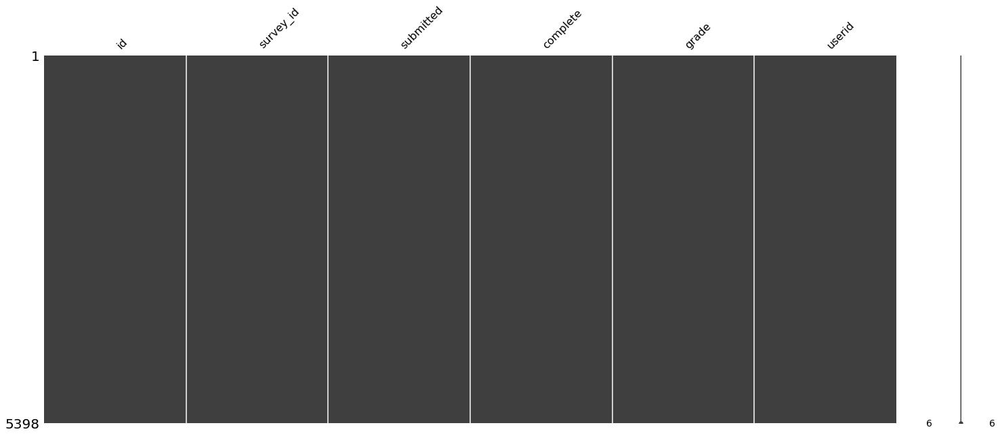

In [235]:
msno.matrix(questionnaire_response)

In [236]:
print(questionnaire_response.userid.nunique())
print('')

print(questionnaire_response.survey_id.nunique())
print()
#checking how many completed and how many didn not
print(questionnaire_response.complete.value_counts())

print('')

#checking the type of grades given
print(questionnaire_response.grade.value_counts())

3010

352

y    5342
n      56
Name: complete, dtype: int64

0      5334
1        31
5        19
100      14
Name: grade, dtype: int64


Therefore, there is data on only 3010 users.

## Consolidation of info on questionnaires

The only dataframes that have meaningful user-centric information are the questionnaire_attempts and questionnaire_response tables. The number of attempts for each question shall be extracted and put into the questionnaire responses dataframe

method 1 (long way):

In [237]:
questionnaireattempts.head()

,id,qid,userid,rid,timemodified
0,2,7,2575,2,1536826661
1,3,10,2575,3,1536826708
2,4,7,2544,4,1536831458
3,5,7,2567,5,1536831577
4,6,10,2544,6,1536831584


In [238]:
questionnaireattempts.shape[0]

5342

In [239]:
user_2567= questionnaireattempts[questionnaireattempts.userid==2567]
for q in user_2567.qid:
    print(q)

7
10


In [240]:
users = []
qids = []
attempts_count = []
for user in questionnaireattempts.sort_values(by='userid').userid.unique():
    user_attempts = questionnaireattempts[questionnaireattempts.userid==user]
    for q in user_attempts.qid.unique():
        users.append(user)
        qids.append(q)
        attempts_count.append(user_attempts[user_attempts.qid==q].rid.nunique())

In [241]:
users[1]

358

In [242]:
print(len(attempts_count))
print(len(qids))
print(len(users))

5247
5247
5247


In [243]:
questionnaire_attempts = pd.DataFrame({'userid':users,'qid':qids,'attempts_count':attempts_count})

In [244]:
questionnaire_attempts

,userid,qid,attempts_count
0,122,663,1
1,358,575,1
2,358,567,1
3,358,579,1
4,358,590,1
...,...,...,...
5242,26487,361,1
5243,26487,365,1
5244,28139,909,1
5245,28166,909,1


In [406]:
questionnaire_attempts.sort_values('userid')

,userid,qid,attempts_count
0,122,663,1
1,358,575,1
2,358,567,1
3,358,579,1
4,358,590,1
...,...,...,...
5243,26487,365,1
5234,26487,825,1
5244,28139,909,1
5245,28166,909,1


In [245]:
questionnaire_attempts.describe()

,userid,qid,attempts_count
count,5247.000000,5247.000000,5247.000000
mean,10918.713741,496.575186,1.018106
std,7264.579534,229.848571,0.141664
min,122.000000,1.000000,1.000000
25%,4990.000000,410.000000,1.000000
50%,9333.000000,498.000000,1.000000
75%,15531.000000,661.000000,1.000000
max,28198.000000,909.000000,3.000000


In [246]:
print(questionnaire_attempts.userid.nunique())
print(questionnaire_attempts.qid.nunique())

2968
352


method 2 (recommended way):

In [419]:
questionnaire_attempts= pd.DataFrame(questionnaireattempts.groupby(['userid','qid']).agg(attempt_count = ('rid','count'))).reset_index()

In [247]:
questionnaire_attempts.to_csv(f'{ppath}questionnaire_attempts.csv',index=False)

## Questionnaire stats

In [248]:
questionnaire_attempts_stats = (questionnaire_attempts.groupby('userid')['attempt_count'].agg(['max','min','mean']))

In [249]:
type(questionnaire_attempts_stats)

pandas.core.frame.DataFrame

In [250]:
questionnaire_attempts_stats

,max,min,mean
userid,,,
122,1,1,1.0
358,1,1,1.0
359,1,1,1.0
1180,1,1,1.0
1183,1,1,1.0
...,...,...,...
26184,1,1,1.0
26487,1,1,1.0
28139,1,1,1.0


In [251]:
questionnaire_attempts_stats.describe()

,max,min,mean
count,2968.000000,2968.000000,2968.000000
mean,1.030660,1.010445,1.018473
std,0.183779,0.104944,0.121583
min,1.000000,1.000000,1.000000
25%,1.000000,1.000000,1.000000
50%,1.000000,1.000000,1.000000
75%,1.000000,1.000000,1.000000
max,3.000000,3.000000,3.000000


In [252]:
questionnaire_attempts_stats.rename({'max':'max_attempts','min':'min_attempts','mean':'mean_attempts'},axis=1,inplace=True)

In [253]:
questionnaire_attempts_stats.reset_index(inplace=True)

In [254]:
questionnaire_attempts_stats.to_csv(f'{ppath}questionnaire_attempts_stats.csv',index=False)

# Surveys

In [255]:
surveys = pd.read_csv(f'{path}survey.csv')

In [256]:
surveys

,id,userid,survey,question,time,answer1,answer2
0,1,16425,6,45,1536761233,4,NaN
1,2,16425,6,46,1536761233,1,NaN
2,3,16425,6,47,1536761233,4,NaN
3,4,16425,6,48,1536761233,4,NaN
4,5,16425,6,49,1536761233,4,NaN
...,...,...,...,...,...,...,...
10333,10512,28114,159,60,1561901015,4,NaN
10334,10513,28114,159,61,1561901015,4,NaN
10335,10514,28114,159,62,1561901015,4,NaN
10336,10515,28114,159,63,1561901015,4,NaN


In [257]:
print(surveys.userid.nunique())
print(surveys.survey.nunique())
print(surveys.question.nunique())

446
40
51


In [258]:
survey_per_user = items_per_user(surveys, 'survey')

In [259]:
survey_per_user

,userid,number_of_surveys
0,95,1
1,423,1
2,641,1
3,710,1
4,1117,1
...,...,...
441,28114,1
442,28116,1
443,28139,1
444,28166,1


In [260]:
survey_per_user.describe()

,userid,number_of_surveys
count,446.000000,446.000000
mean,10865.728700,1.042601
std,6385.850001,0.202182
min,95.000000,1.000000
25%,5949.250000,1.000000
50%,9349.500000,1.000000
75%,16247.750000,1.000000
max,28198.000000,2.000000


In [261]:
surveyquestion_per_user = items_per_user(surveys,'question')

In [262]:
surveyquestion_per_user

,userid,number_of_questions
0,95,20
1,423,5
2,641,5
3,710,5
4,1117,5
...,...,...
441,28114,20
442,28116,20
443,28139,20
444,28166,20


In [263]:
surveyquestion_per_user.describe()

,userid,number_of_questions
count,446.000000,446.000000
mean,10865.728700,23.179372
std,6385.850001,6.734057
min,95.000000,5.000000
25%,5949.250000,20.000000
50%,9349.500000,23.000000
75%,16247.750000,26.000000
max,28198.000000,46.000000


In [264]:
survey_per_user.to_csv(f'{ppath}survey_per_user.csv',index=False)
surveyquestion_per_user.to_csv(f'{ppath}surveyquestion_per_user.csv',index=False)

# Quiz related data

## Quiz attempts

In [265]:
quiz_attempts=pd.read_csv(f'{path}quiz_attempts.csv')
quiz_attempts

,id,quiz,userid,attempt,uniqueid,layout,currentpage,preview,state,timestart,timefinish,timemodified,timemodifiedoffline,timecheckstate,sumgrades
0,5933,424,6118,1,6619,"1,0,2,0,3,0,4,0,5,0",4,0,finished,1541322307,1541331808,1547701814,0,NaN,NaN
1,68,16,14287,2,88,"1,2,3,4,5,6,7,8,9,10,0",0,0,finished,1536757686,1536757792,1536757792,0,NaN,10.0
2,2,16,97,1,11,"1,2,3,4,5,6,7,8,9,10,0",0,1,inprogress,1536128247,0,1536128247,0,NaN,NaN
3,185,17,5417,2,208,"1,0",0,0,finished,1536826143,1536826166,1536826166,0,NaN,1.0
4,4737,376,11315,2,5258,"1,0",0,0,finished,1540737475,1542862254,1542862254,0,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72061,76476,1189,968,1,82617,"1,2,3,4,5,0,6,7,8,9,10,0,11,12,13,14,15,0,16,1...",0,1,inprogress,1594866723,0,1594866723,0,NaN,NaN
72062,76477,1430,1048,1,82618,"1,22,10,5,19,21,17,20,2,13,9,4,11,6,3,14,15,16...",0,1,inprogress,1602139692,0,1602139692,0,NaN,NaN
72063,76478,2212,18767,1,82620,"1,0,2,0,3,0,4,0,5,0,6,0,7,0,8,0,9,0,10,0,11,0,...",0,1,inprogress,1606793013,0,1606793013,0,NaN,NaN
72064,36171,1914,981,1,39270,"1,0,2,0,3,0,4,0,5,0,6,0,7,0,8,0,9,0,10,0",9,1,inprogress,1553832698,0,1553832713,0,NaN,NaN


In [266]:
quiz_attempts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 72066 entries, 0 to 72065
Data columns (total 15 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   id                   72066 non-null  int64  
 1   quiz                 72066 non-null  int64  
 2   userid               72066 non-null  int64  
 3   attempt              72066 non-null  int64  
 4   uniqueid             72066 non-null  int64  
 5   layout               72066 non-null  object 
 6   currentpage          72066 non-null  int64  
 7   preview              72066 non-null  int64  
 8   state                72066 non-null  object 
 9   timestart            72066 non-null  int64  
 10  timefinish           72066 non-null  int64  
 11  timemodified         72066 non-null  int64  
 12  timemodifiedoffline  72066 non-null  int64  
 13  timecheckstate       94 non-null     float64
 14  sumgrades            66279 non-null  float64
dtypes: float64(2), int64(11), object(2)


In [267]:
# number of unique users
print(quiz_attempts.userid.nunique())

# number of unique quizes
print(quiz_attempts.quiz.nunique())

# number of uniqueid's
print(quiz_attempts.uniqueid.nunique())

11999
984
72066


checking if there a user has attempted a quiz twice and if that information is redundantly stored

In [268]:
quiz_attempts_1 = quiz_attempts.loc[quiz_attempts.attempt==1]
quiz_attempts_2= quiz_attempts.loc[quiz_attempts.attempt==2]

In [269]:
quiz_attempts_1.reset_index(inplace=True,drop=True)
quiz_attempts_2.reset_index(inplace=True,drop=True)

In [270]:
quiz_attempts_1.head()

,id,quiz,userid,attempt,uniqueid,layout,currentpage,preview,state,timestart,timefinish,timemodified,timemodifiedoffline,timecheckstate,sumgrades
0,5933,424,6118,1,6619,"1,0,2,0,3,0,4,0,5,0",4,0,finished,1541322307,1541331808,1547701814,0,NaN,NaN
1,2,16,97,1,11,"1,2,3,4,5,6,7,8,9,10,0",0,1,inprogress,1536128247,0,1536128247,0,NaN,NaN
2,26,16,5431,1,39,"1,2,3,4,5,6,7,8,9,10,0",0,0,inprogress,1536741298,0,1536741298,0,NaN,NaN
3,15,52,10418,1,26,"1,0,2,0,3,0,4,0,5,0,6,0",5,0,finished,1536719254,1536720068,1536819690,0,NaN,NaN
4,284,16,5411,1,309,"1,2,3,4,5,6,7,8,9,10,0",0,0,inprogress,1537002411,0,1537002411,0,NaN,NaN


In [271]:
quiz_attempts_2.head()

,id,quiz,userid,attempt,uniqueid,layout,currentpage,preview,state,timestart,timefinish,timemodified,timemodifiedoffline,timecheckstate,sumgrades
0,68,16,14287,2,88,"1,2,3,4,5,6,7,8,9,10,0",0,0,finished,1536757686,1536757792,1536757792,0,NaN,10.0
1,185,17,5417,2,208,"1,0",0,0,finished,1536826143,1536826166,1536826166,0,NaN,1.0
2,4737,376,11315,2,5258,"1,0",0,0,finished,1540737475,1542862254,1542862254,0,NaN,0.0
3,45,16,5417,2,65,"1,2,3,4,5,6,7,8,9,10,0",0,0,finished,1536750628,1536750710,1536750710,0,NaN,10.0
4,52,16,5410,2,72,"1,2,3,4,5,6,7,8,9,10,0",0,0,finished,1536754569,1536755485,1536755485,0,NaN,9.0


In [272]:
quiz_attempts_1_users = quiz_attempts_1.userid.unique()
quiz_attempts_2_users = quiz_attempts_2.userid.unique()

In [273]:
same_users = []
for user1 in quiz_attempts_1_users:
    for user2 in quiz_attempts_2_users:
        if user1==user2:
            same_users.append(user1)
print(same_users[0:10])
print(len(same_users))

[6713, 8159, 10435, 10409, 10375, 14363, 2607, 5392, 10416, 5432]
4702


In [274]:
quiz_attempts_1.loc[quiz_attempts_1.userid==6713]

,id,quiz,userid,attempt,uniqueid,layout,currentpage,preview,state,timestart,timefinish,timemodified,timemodifiedoffline,timecheckstate,sumgrades
9,35,52,6713,1,55,"1,0,2,0,3,0,4,0,5,0,6,0",5,0,finished,1536744851,1536745120,1536819878,0,NaN,NaN
655,847,53,6713,1,946,"5,0,1,0,4,0,3,0,2,0",4,0,finished,1537866396,1537866431,1537866431,0,NaN,4.00000
713,949,54,6713,1,1061,"10,0,6,0,1,0,2,0,9,0,5,0,7,0,3,0,8,0,4,0",9,0,finished,1538122548,1538122715,1538122715,0,NaN,8.00000
10062,11219,572,6713,1,12267,"1,0,2,0,3,0,4,0,5,0,6,0,7,0,8,0,9,0,10,0",9,0,finished,1544794799,1544794978,1544794978,0,NaN,7.66667
11646,13446,55,6713,1,14641,"5,0,3,0,1,0,2,0,4,0",4,0,finished,1545379165,1545379280,1545379280,0,NaN,4.00000
11664,13447,56,6713,1,14642,"5,0,4,0,1,0,3,0,2,0",4,0,finished,1545379294,1545379361,1545379361,0,NaN,4.00000


In [275]:
quiz_attempts_2.loc[quiz_attempts_2.userid==6713]

,id,quiz,userid,attempt,uniqueid,layout,currentpage,preview,state,timestart,timefinish,timemodified,timemodifiedoffline,timecheckstate,sumgrades
289,2554,54,6713,2,2828,"6,0,9,0,7,0,10,0,4,0,1,0,8,0,5,0,3,0,2,0",9,0,finished,1539650200,1539650361,1539650361,0,NaN,7.0


The information is indeed, redundantly stored

### attempt-stats

stats on quiz attempts for each user

In [276]:
quizattempt_stats = find_stats(quiz_attempts,'attempt')
quizattempt_stats.to_csv(f'{ppath}quizattempt_stats.csv',index=False)

In [277]:
quizattempt_stats

,userid,max_attempt,min_attempt,mean_attempt
0,6118,1,1,1.000000
1,14287,3,1,1.535714
2,97,1,1,1.000000
3,5417,2,1,1.227273
4,11315,2,1,1.333333
...,...,...,...,...
11994,28151,1,1,1.000000
11995,734,1,1,1.000000
11996,824,1,1,1.000000
11997,325,1,1,1.000000


In [278]:
quizattempt_stats.describe()

,userid,max_attempt,min_attempt,mean_attempt
count,11999.000000,11999.000000,11999.000000,11999.000000
mean,11531.869489,1.617718,1.000167,1.164920
std,6745.708120,1.131004,0.012910,0.377495
min,7.000000,1.000000,1.000000,1.000000
25%,5549.500000,1.000000,1.000000,1.000000
50%,11356.000000,1.000000,1.000000,1.000000
75%,16354.500000,2.000000,1.000000,1.250000
max,28217.000000,44.000000,2.000000,22.022222


### quiz count per user

In [279]:
quiz_per_user_quizattempts = items_per_user(quiz_attempts,'quiz')

In [280]:
quiz_per_user_quizattempts

,userid,number_of_quizs
0,7,2
1,9,1
2,32,1
3,39,2
4,40,2
...,...,...
11994,28204,1
11995,28206,1
11996,28214,1
11997,28216,2


In [281]:
quiz_per_user_quizattempts.describe()

,userid,number_of_quizs
count,11999.000000,11999.000000
mean,11531.869489,4.571214
std,6745.708120,4.528244
min,7.000000,1.000000
25%,5549.500000,1.000000
50%,11356.000000,3.000000
75%,16354.500000,6.000000
max,28217.000000,27.000000


In [282]:
quiz_per_user_quizattempts.to_csv(f'{ppath}quiz_per_user_quizattempts.csv',index=False)

## Quiz grades

In [283]:
quiz_grades = pd.read_csv(f'{path}quiz_grades.csv')
quiz_grades

,id,quiz,userid,grade,timemodified
0,1,16,5357,10.00000,1536741761
1,2,16,14301,8.00000,1536741779
2,3,16,5432,7.00000,1536742149
3,4,16,5417,10.00000,1536750710
4,5,16,5410,9.00000,1536755485
...,...,...,...,...,...
50023,52180,2478,13393,36.79245,1561908919
50024,52182,2476,16199,18.88889,1561909637
50025,52163,2477,13393,41.00000,1561909676
50026,52183,2487,24429,14.00000,1565890851


In [284]:
print(quiz_grades.quiz.nunique())
print(quiz_grades.userid.nunique())

830
10976


In [285]:
quiz_count_quizgrades = items_per_user(quiz_grades,'quiz')

In [286]:
quiz_count_quizgrades

,userid,number_of_quizs
0,64,3
1,65,3
2,66,1
3,90,1
4,155,2
...,...,...
10971,28204,1
10972,28206,1
10973,28214,1
10974,28216,2


In [287]:
quiz_count_quizgrades.describe()

,userid,number_of_quizs
count,10976.000000,10976.000000
mean,11628.391946,4.557945
std,6688.831079,4.526663
min,64.000000,1.000000
25%,5609.750000,1.000000
50%,11557.500000,3.000000
75%,16387.250000,6.000000
max,28217.000000,27.000000


In [288]:
quiz_count_quizgrades.to_csv(f'{ppath}quiz_count_quizgrades.csv',index=False)

### Grades scaled at 10

In [289]:
quiz_grades[quiz_grades["grade"]<10]

,id,quiz,userid,grade,timemodified
1,2,16,14301,8.00000,1536741779
2,3,16,5432,7.00000,1536742149
4,5,16,5410,9.00000,1536755485
5,6,16,14247,5.00000,1536755637
6,7,16,14246,7.00000,1536755776
...,...,...,...,...,...
49984,52141,2438,15952,3.33333,1561814437
49989,52146,2482,28139,5.00000,1561828961
50003,52160,2482,28122,0.00000,1561883163
50009,52168,2482,28206,5.00000,1561892802


### Grades scaled above 10 and below 40

In [290]:
qgrades_btn_10_40 = pcnt_df(quiz_grades,"grade", lbound=10,hbound=41) #grade 11 to grade 39
print(qgrades_btn_10_40)

qgrades_10 = pcnt_df(quiz_grades,"grade",hbound=11) #upto grade=9
print(qgrades_10)

qgrades_btn_40_100 = pcnt_df(quiz_grades,"grade", lbound=40,hbound=101)
print(qgrades_btn_40_100)

qgrades_above100 = pcnt_df(quiz_grades,"grade", lbound=100)
print(qgrades_above100)

19.311185735987845
77.83641160949868
3.206204525465739
0.009994403134244823


## Joining Quiz attempts and quiz grades

In [291]:
quiz_attempts

,id,quiz,userid,attempt,uniqueid,layout,currentpage,preview,state,timestart,timefinish,timemodified,timemodifiedoffline,timecheckstate,sumgrades
0,5933,424,6118,1,6619,"1,0,2,0,3,0,4,0,5,0",4,0,finished,1541322307,1541331808,1547701814,0,NaN,NaN
1,68,16,14287,2,88,"1,2,3,4,5,6,7,8,9,10,0",0,0,finished,1536757686,1536757792,1536757792,0,NaN,10.0
2,2,16,97,1,11,"1,2,3,4,5,6,7,8,9,10,0",0,1,inprogress,1536128247,0,1536128247,0,NaN,NaN
3,185,17,5417,2,208,"1,0",0,0,finished,1536826143,1536826166,1536826166,0,NaN,1.0
4,4737,376,11315,2,5258,"1,0",0,0,finished,1540737475,1542862254,1542862254,0,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72061,76476,1189,968,1,82617,"1,2,3,4,5,0,6,7,8,9,10,0,11,12,13,14,15,0,16,1...",0,1,inprogress,1594866723,0,1594866723,0,NaN,NaN
72062,76477,1430,1048,1,82618,"1,22,10,5,19,21,17,20,2,13,9,4,11,6,3,14,15,16...",0,1,inprogress,1602139692,0,1602139692,0,NaN,NaN
72063,76478,2212,18767,1,82620,"1,0,2,0,3,0,4,0,5,0,6,0,7,0,8,0,9,0,10,0,11,0,...",0,1,inprogress,1606793013,0,1606793013,0,NaN,NaN
72064,36171,1914,981,1,39270,"1,0,2,0,3,0,4,0,5,0,6,0,7,0,8,0,9,0,10,0",9,1,inprogress,1553832698,0,1553832713,0,NaN,NaN


In [292]:
quiz_grades

,id,quiz,userid,grade,timemodified
0,1,16,5357,10.00000,1536741761
1,2,16,14301,8.00000,1536741779
2,3,16,5432,7.00000,1536742149
3,4,16,5417,10.00000,1536750710
4,5,16,5410,9.00000,1536755485
...,...,...,...,...,...
50023,52180,2478,13393,36.79245,1561908919
50024,52182,2476,16199,18.88889,1561909637
50025,52163,2477,13393,41.00000,1561909676
50026,52183,2487,24429,14.00000,1565890851


Collecting the 'latest' attempts

In [293]:
users = []
quizes = []
latest_attempts = []
for user in quiz_attempts.userid.unique():
  quiz_attempts_user = quiz_attempts[quiz_attempts.userid==user]
  for q in quiz_attempts_user.quiz.unique():
    users.append(user)
    quizes.append(q)
    latest_attempt = quiz_attempts_user[quiz_attempts_user.quiz==q].attempt.max()
    latest_attempts.append(latest_attempt)

quiz_latest_attempts = pd.DataFrame({'userid':users,'quiz':quizes,'latest_attempt':latest_attempts})

In [294]:
quiz_latest_attempts.shape

(54850, 3)

In [295]:
quiz_latest_attempts.rename(columns={'latest_attempt':'attempts'},inplace=True)

In [296]:
quiz_latest_attempts

,userid,quiz,attempts
0,6118,424,1
1,6118,1588,1
2,14287,16,2
3,14287,17,2
4,14287,994,3
...,...,...,...
54845,28151,2482,1
54846,734,2485,1
54847,824,2161,1
54848,325,2141,1


In [297]:
print(quiz_latest_attempts.userid.nunique())
print(quiz_latest_attempts.quiz.nunique())
print()

print(quiz_latest_attempts.attempts.describe())

11999
984

count    54850.000000
mean         1.314111
std          0.766859
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max         44.000000
Name: attempts, dtype: float64


In [298]:
quiz_latest_attempts.to_csv(f'{ppath}quiz_latest_attempts.csv',index=False)

merging quiz_grades and quiz_latest_attempts

In [299]:
quiz_merged = pd.DataFrame()

In [300]:
quiz_merged = quiz_grades.merge(quiz_latest_attempts,on=['userid','quiz'],how='left').drop(columns='id')

In [301]:
quiz_merged

,quiz,userid,grade,timemodified,attempts
0,16,5357,10.00000,1536741761,1
1,16,14301,8.00000,1536741779,1
2,16,5432,7.00000,1536742149,1
3,16,5417,10.00000,1536750710,2
4,16,5410,9.00000,1536755485,2
...,...,...,...,...,...
50023,2478,13393,36.79245,1561908919,2
50024,2476,16199,18.88889,1561909637,1
50025,2477,13393,41.00000,1561909676,3
50026,2487,24429,14.00000,1565890851,1


Verifying the validity of the data by cross-checking with quiz_latest_attempts

In [302]:
quiz_latest_attempts.loc[(quiz_latest_attempts.quiz==16)&(quiz_latest_attempts.userid==5417)]

,userid,quiz,attempts
20,5417,16,2


In [303]:
quiz_merged.to_csv(f'{ppath}quiz_merged.csv',index=False)

In [304]:
quiz_count_quizmerged = items_per_user(quiz_merged,'quiz')

In [305]:
quiz_count_quizmerged

,userid,number_of_quizs
0,64,3
1,65,3
2,66,1
3,90,1
4,155,2
...,...,...
10971,28204,1
10972,28206,1
10973,28214,1
10974,28216,2


In [306]:
quiz_count_quizmerged.to_csv(f'{ppath}quiz_count_quizmerged.csv',index=False)

# Users

In [27]:
users = pd.read_csv(f'{path}users.csv')

In [37]:
users

,id,firstname,lastname,email,idnumber,institution,department
0,3,Zahiruddin Fitri,Abu Hassan,zahiruddin@um.edu.my,NaN,NaN,NaN
1,26362,Prof. Madya Dr. Sayuti Ab Ghani,.,sayuti@um.edu.my,NaN,NaN,NaN
2,22541,Cik Noor Akma Binti Kamaruddin,.,noorakma@um.edu.my,00012785,NaN,NaN
3,20530,NaN,NaN,NaN,NaN,NaN,NaN
4,26159,Dr. Michael Lim Chung Keat,.,michael.lim@um.edu.my,00013722,NaN,NaN
...,...,...,...,...,...,...,...
29130,14301,How Yong Yeu Tai,.,wic180015@siswa.um.edu.my,WIC180015,NaN,NaN
29131,520,Dr. Mohd Azmi Bin Haron,.,azmiharon@um.edu.my,00014264,Fakulti Sains,Institut Sains Matematik
29132,29070,NaN,NaN,NaN,NaN,NaN,NaN
29133,521,Dr. Nur Anisah Binti Mohamed @ A. Rahman,.,nuranisah_mohamed@um.edu.my,00008951,Fakulti Sains,Institut Sains Matematik


In [28]:
users.id.nunique()

29135

In [29]:
users.sort_values(by='id',inplace=True )

In [30]:
users

,id,firstname,lastname,email,idnumber,institution,department
6,1,,.,root@localhost,NaN,NaN,NaN
23,2,Admin Spectrum,.,spectrum@um.edu.my,NaN,NaN,NaN
0,3,Zahiruddin Fitri,Abu Hassan,zahiruddin@um.edu.my,NaN,NaN,NaN
24,4,Encik Adnan Bin Yahya,.,adnan@um.edu.my,00006670,NaN,NaN
27891,5,Encik Mohd Shukri Hadafi Bin Md Nor,.,noreply@um.edu.my,00011225,NaN,NaN
...,...,...,...,...,...,...,...
762,29133,NaN,NaN,NaN,NaN,NaN,NaN
884,29134,NaN,NaN,NaN,NaN,NaN,NaN
1248,29135,NaN,NaN,NaN,NaN,NaN,NaN
1441,29136,NaN,NaN,NaN,NaN,NaN,NaN


There are a lot of values in the lastname column that are not really data (The ones with '.')

In [312]:
#Checking for invalid values
users.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29135 entries, 6 to 12912
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   id           29135 non-null  int64 
 1   firstname    27821 non-null  object
 2   lastname     27821 non-null  object
 3   email        27827 non-null  object
 4   idnumber     27689 non-null  object
 5   institution  1531 non-null   object
 6   department   1553 non-null   object
dtypes: int64(1), object(6)
memory usage: 1.8+ MB


In [313]:
print('There are ',
      users[users.firstname=='.'].shape[0],
      ' users with a dummmy firstname')

print('There are ',
      users[users.lastname=='.'].shape[0],
      ' users with a dummy lastname')

print('There are ',
      users[users.email=='.'].shape[0],
      ' users with a dummy email')



There are  0  users with a dummmy firstname
There are  27612  users with a dummy lastname
There are  0  users with a dummy email


## Script to classify students from other personnel

In [31]:
student_emails = classify_email(users,'email')[0]
teacher_emails = classify_email(users,'email')[1]

print(len(student_emails))
print(len(teacher_emails))

24543
2536


In [32]:
students = users[users.email.isin(student_emails)]
students

,id,firstname,lastname,email,idnumber,institution,department
2401,64,Kunalkumar A/l Poobathy,.,kunalkumar@siswa.um.edu.my,WIF160010,NaN,NaN
2983,65,Prabbananthen A/l Santhra Mohan,.,prabba@siswa.um.edu.my,WIF160052,NaN,NaN
6397,66,Muhammad Shazwar Bin Anuar,.,shazwar.a@siswa.um.edu.my,WIE160015,NaN,NaN
5022,67,Syaza Izzati Binti Ibrahim,.,syazaizzati@siswa.um.edu.my,WIC160061,NaN,NaN
7476,68,Bryan Raj A/l Peter Jabaraj,.,bryanraj@siswa.um.edu.my,WIC160008,NaN,NaN
...,...,...,...,...,...,...,...
8715,28221,Dr Aminah Jalil,.,aminahjalil85@siswa.um.edu.my,DGD150002,NaN,NaN
8902,28230,Li Mei,.,ava180067@siswa.um.edu.my,AVA180067,NaN,NaN
9724,28233,Muhammad Izz Syahmi Bin Kamarul Arifin,.,fae190063@siswa.um.edu.my,FAE190063,NaN,NaN
4014,28234,Soon Wan Fei,.,fellowship87@siswa.um.edu.my,ROA160001,NaN,NaN


In [42]:
teachers = users[users.email.isin(teacher_emails)]
teachers

,id,firstname,lastname,email,idnumber,institution,department
23,2,Admin Spectrum,.,spectrum@um.edu.my,NaN,NaN,NaN
0,3,Zahiruddin Fitri,Abu Hassan,zahiruddin@um.edu.my,NaN,NaN,NaN
24,4,Encik Adnan Bin Yahya,.,adnan@um.edu.my,00006670,NaN,NaN
27891,5,Encik Mohd Shukri Hadafi Bin Md Nor,.,noreply@um.edu.my,00011225,NaN,NaN
10026,6,Dr. Zahiruddin Fitri Bin Abu Hassan,.,zahiruddin@um.edu.my,00008939,NaN,NaN
...,...,...,...,...,...,...,...
1659,28210,Encik Mohamad Bin Akasah,.,mohamad@um.edu.my,00004025,NaN,NaN
1552,28223,Encik Hideharu Fujinami,.,fujinami@um.edu.my,00014689,NaN,NaN
1426,28224,Encik Seiki Nishikori,.,nishikori2018@um.edu.my,00014694,NaN,NaN
1482,28225,Encik Masahiro Onishi,.,masahiro310@um.edu.my,00014986,NaN,NaN


In [317]:
students.to_csv(f'{ppath}students.csv',index=False)
teachers.to_csv(f'{ppath}teachers.csv',index=False)

The student data has been stored as a csv in '/data/processed/'.

In [318]:
students

,id,firstname,lastname,email,idnumber,institution,department
2401,64,Kunalkumar A/l Poobathy,.,kunalkumar@siswa.um.edu.my,WIF160010,NaN,NaN
2983,65,Prabbananthen A/l Santhra Mohan,.,prabba@siswa.um.edu.my,WIF160052,NaN,NaN
6397,66,Muhammad Shazwar Bin Anuar,.,shazwar.a@siswa.um.edu.my,WIE160015,NaN,NaN
5022,67,Syaza Izzati Binti Ibrahim,.,syazaizzati@siswa.um.edu.my,WIC160061,NaN,NaN
7476,68,Bryan Raj A/l Peter Jabaraj,.,bryanraj@siswa.um.edu.my,WIC160008,NaN,NaN
...,...,...,...,...,...,...,...
8715,28221,Dr Aminah Jalil,.,aminahjalil85@siswa.um.edu.my,DGD150002,NaN,NaN
8902,28230,Li Mei,.,ava180067@siswa.um.edu.my,AVA180067,NaN,NaN
9724,28233,Muhammad Izz Syahmi Bin Kamarul Arifin,.,fae190063@siswa.um.edu.my,FAE190063,NaN,NaN
4014,28234,Soon Wan Fei,.,fellowship87@siswa.um.edu.my,ROA160001,NaN,NaN


## Groups (Only students)

In [319]:
group_members

,id,groupid,userid,timeadded,component,itemid
0,342946,42754,12512,1549597603,NaN,0
1,342947,42754,12509,1549597603,NaN,0
2,342948,42754,12511,1549597603,NaN,0
3,342949,42754,12515,1549597603,NaN,0
4,342950,42754,12517,1549597603,NaN,0
...,...,...,...,...,...,...
198306,759089,96910,19936,1568950815,NaN,0
198307,759090,96910,19927,1568950815,NaN,0
198308,759091,96910,19909,1568950815,NaN,0
198309,759092,96910,19938,1568950815,NaN,0


In [320]:
group_members = group_members[group_members.userid.isin(students.id)]

In [321]:
group_members

,id,groupid,userid,timeadded,component,itemid
0,342946,42754,12512,1549597603,NaN,0
1,342947,42754,12509,1549597603,NaN,0
2,342948,42754,12511,1549597603,NaN,0
3,342949,42754,12515,1549597603,NaN,0
4,342950,42754,12517,1549597603,NaN,0
...,...,...,...,...,...,...
198306,759089,96910,19936,1568950815,NaN,0
198307,759090,96910,19927,1568950815,NaN,0
198308,759091,96910,19909,1568950815,NaN,0
198309,759092,96910,19938,1568950815,NaN,0


# Forum related data

In [322]:
forum_meta = pd.read_csv(f'{path}forum.csv')
forumposts = pd.read_csv(f'{path}forumposts.csv')

In [323]:
forum_meta

,id,course,type,name,intro,introformat,assessed,assesstimestart,assesstimefinish,scale,...,rssarticles,timemodified,warnafter,blockafter,blockperiod,completiondiscussions,completionreplies,completionposts,displaywordcount,lockdiscussionafter
0,1,2,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1508210214,0,0,0,0,0,0,0,0
1,3,4,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1510194915,0,0,0,0,0,0,0,0
2,4,4,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1441247824,0,0,0,0,0,0,0,0
3,5,4,general,Feedback on teaching and learning,<p>This forum is for you to ask questions on a...,1,0,0,0,100,...,0,1513584173,0,0,0,0,0,0,0,0
4,6,4,general,Learning reflection week 1,<p>Reflective practice is very important in st...,1,0,0,0,100,...,0,1507893624,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11092,13347,301,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1602682184,0,0,0,0,0,0,0,0
11093,13348,5283,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1605122121,0,0,0,0,0,0,0,0
11094,13349,2688,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1605669962,0,0,0,0,0,0,0,0
11095,13350,3139,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1616605615,0,0,0,0,0,0,0,0


In [324]:
print(forum_meta.course.nunique())

print(forum_meta.type.unique())

4696
['news' 'general' 'single' 'social' 'blog' 'qanda' 'eachuser']


In [325]:
forum_meta[forum_meta.type=='qanda'] #qanda = q and a = QnA

,id,course,type,name,intro,introformat,assessed,assesstimestart,assesstimefinish,scale,...,rssarticles,timemodified,warnafter,blockafter,blockperiod,completiondiscussions,completionreplies,completionposts,displaywordcount,lockdiscussionafter
416,4443,871,qanda,Thursday Tutorial 1-2 [18.10.18],<p>We will conduct our tutorial online. Do bea...,1,0,0,0,100,...,0,1539840589,0,0,0,0,0,0,0,0
494,4441,871,qanda,Thursday Tutorial 11-12 [18.10.18],<p>We will conduct our tutorial online. Do bea...,1,0,0,0,100,...,0,1539840542,0,0,0,0,0,0,0,0
1238,12363,3541,qanda,Tutorial 6,NaN,1,0,0,0,100,...,0,1556077880,0,0,0,0,0,0,0,0
1691,10996,3194,qanda,Video and mini quiz,<p>1. Is the provided videos help you to recal...,1,0,0,0,100,...,0,1552206639,0,0,0,0,0,0,0,0
2050,2187,106,qanda,Forum for Lecture Week 1 (new version of Spect...,"<div class=""contentafterlink"">\r\n<div class=""...",1,0,0,0,100,...,0,1537028393,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10644,12767,3965,qanda,e-Consultation- Group 1 (Dr Nurul's Group),"<p>Dear Group 1 (Dr Nurul's Group),</p>\r\n<p>...",1,0,0,0,100,...,0,1557822974,0,0,0,0,0,0,0,0
10666,12784,3541,qanda,Tutorial Minggu 13/Tutorial Week 13,NaN,1,0,0,0,100,...,0,1557904615,0,0,0,0,0,0,0,0
10925,13262,4423,qanda,Pre-Exam Forum,<p>Please type your questions here and it will...,1,0,0,0,100,...,0,1560732110,0,0,0,0,0,0,0,0
10929,13186,3232,qanda,Q & A Forum,<p><span>Feel free to ask any question and dis...,1,0,0,0,100,...,0,1559843877,0,0,0,0,0,0,0,0


In [326]:
forumposts

,id,discussion,parent,userid,created,modified,mailed,subject,message,messageformat,messagetrust,attachment,totalscore,mailnow
0,8618,3816,7178,4743,1540747317,1540747317,1,Re: my fav ad,"<p>Wow, it's very creative XD</p>",1,0,NaN,0,0
1,24525,13185,24524,7404,1551772328,1551772328,1,Re: Halaqah 2 (5/3),<p>Ms 56 ali imran</p>,1,0,1.0,0,0
2,20948,10939,20917,5766,1550627084,1550627084,1,Re: Three main takeaways from all session atte...,<p>1. There is still flaws in our urban legisl...,1,0,NaN,0,0
3,28,28,0,211,1536248718,1536248718,1,Tutorial slot,<p>Please note that tutorials will be conducte...,1,0,NaN,0,0
4,6418,3426,0,6385,1539622370,1539622370,1,tutorial 4,<p>tutorial 4</p>,1,0,1.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47365,54088,28531,0,521,1577768621,1577768621,0,TEST2,<p>SJEM3260</p>,1,0,NaN,0,0
47366,54092,18792,35138,10609,1605842471,1605842471,0,Re: Kuliah 7,"<p>Yes, you have defined correctly. Bur the qu...",1,0,NaN,0,0
47367,54089,28532,0,521,1577768633,1577768633,0,TEST3,<p>SJEM3260</p>,1,0,NaN,0,0
47368,54093,18792,35145,10609,1605842588,1605842588,0,Re: Kuliah 7,<p>Yes you are partially right. But UM has som...,1,0,NaN,0,0


## Finding the forumposts that were made exclusively by students.

In [327]:
forumposts = forumposts[forumposts.userid.isin(students.id)]

In [328]:
forumposts

,id,discussion,parent,userid,created,modified,mailed,subject,message,messageformat,messagetrust,attachment,totalscore,mailnow
0,8618,3816,7178,4743,1540747317,1540747317,1,Re: my fav ad,"<p>Wow, it's very creative XD</p>",1,0,NaN,0,0
1,24525,13185,24524,7404,1551772328,1551772328,1,Re: Halaqah 2 (5/3),<p>Ms 56 ali imran</p>,1,0,1.0,0,0
2,20948,10939,20917,5766,1550627084,1550627084,1,Re: Three main takeaways from all session atte...,<p>1. There is still flaws in our urban legisl...,1,0,NaN,0,0
4,6418,3426,0,6385,1539622370,1539622370,1,tutorial 4,<p>tutorial 4</p>,1,0,1.0,0,0
5,7824,4128,0,13447,1540267039,1540267039,1,"Jamie,Lih Hong and Afifa",<p>English in Asia</p>,1,0,1.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47341,54023,28478,0,11328,1561541563,1561541563,1,why chamber music is important?,<p>Because we can enjoy an enhanced ability to...,1,0,NaN,0,0
47346,54067,27043,51806,7441,1561873545,1561873545,1,Re: Bagaimana cara menyediakan soalan betul salah,<p>Cara menyediakan soalan betul salah</p>\r\n...,1,0,NaN,0,0
47347,54075,10428,38147,3739,1561908350,1561908350,1,Re: Lat,"<p>I agree with Hidayat, I myself believe Mat ...",1,0,NaN,0,0
47348,54073,28518,0,3739,1561906199,1561906199,1,Importance of Women's Writing,<p><span>In Virgina Woolf's <em>A Room of One'...,1,0,NaN,0,0


In [329]:
print(forumposts.discussion.nunique())
print(forumposts.userid.nunique())

17801
8755


In [330]:
forumposts.to_csv(f'{ppath}forumposts.csv',index=False)

## Forum Metadata

In [331]:
forum_meta

,id,course,type,name,intro,introformat,assessed,assesstimestart,assesstimefinish,scale,...,rssarticles,timemodified,warnafter,blockafter,blockperiod,completiondiscussions,completionreplies,completionposts,displaywordcount,lockdiscussionafter
0,1,2,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1508210214,0,0,0,0,0,0,0,0
1,3,4,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1510194915,0,0,0,0,0,0,0,0
2,4,4,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1441247824,0,0,0,0,0,0,0,0
3,5,4,general,Feedback on teaching and learning,<p>This forum is for you to ask questions on a...,1,0,0,0,100,...,0,1513584173,0,0,0,0,0,0,0,0
4,6,4,general,Learning reflection week 1,<p>Reflective practice is very important in st...,1,0,0,0,100,...,0,1507893624,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11092,13347,301,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1602682184,0,0,0,0,0,0,0,0
11093,13348,5283,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1605122121,0,0,0,0,0,0,0,0
11094,13349,2688,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1605669962,0,0,0,0,0,0,0,0
11095,13350,3139,news,Announcements,General news and announcements,0,0,0,0,0,...,0,1616605615,0,0,0,0,0,0,0,0


In [332]:
print(forum_meta.id.nunique())

11097


Need to know what the 'forcesubscribe' column means
(Update: No need)

In [333]:
forum_meta = forum_meta[['id','course','type','name']]

In [334]:
forum_meta

,id,course,type,name
0,1,2,news,Announcements
1,3,4,news,Announcements
2,4,4,news,Announcements
3,5,4,general,Feedback on teaching and learning
4,6,4,general,Learning reflection week 1
...,...,...,...,...
11092,13347,301,news,Announcements
11093,13348,5283,news,Announcements
11094,13349,2688,news,Announcements
11095,13350,3139,news,Announcements


## Forum Discussions

In [335]:
discussions = pd.read_csv(f'{path}discussions.csv')

In [336]:
discussions

,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,id,course,forum,name,firstpost,userid,groupid,assessed,timemodified,usermodified,timestart,timeend,pinned
0,0,0,0,106,1939,1438,Evelyn Tiong (soalan video),108,13454,-1,0,1536744021,13454,0,0,0
1,1,1,1,107,1939,1438,Soalan,109,11410,-1,0,1536744897,11410,0,0,0
2,2,2,2,108,1939,1438,Tiga soalan berdasarkan video yang telah ditonton,110,8131,-1,0,1536744301,8131,0,0,0
3,3,3,3,109,1939,1438,tiga soalan berdasarkan video Switzerland Tou...,111,11423,-1,0,1536744438,11423,0,0,0
4,4,4,4,110,1939,1438,3 Soalan berdasarkan video.,112,7593,-1,0,1536744467,7593,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16763,16763,16763,16763,28495,4136,12687,Moderate Down Syndrome - Speech and Language,54043,11162,-1,0,1561639473,11162,0,0,0
16764,16764,16764,16764,28515,4230,13196,Muhamad Haziq Hasan,54068,24777,-1,0,1561881618,24777,0,0,0
16765,16765,16765,16765,28516,4805,13242,MOB 180001 @ Cytopeutics,54069,15582,-1,0,1561888761,15582,0,0,0
16766,16766,16766,16766,28517,4805,13241,MOB 180001 @ Cytopeutics,54070,15582,-1,0,1561889369,15582,0,0,0


In [337]:
discussions.describe()

,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,id,course,forum,firstpost,userid,groupid,assessed,timemodified,usermodified,timestart,timeend,pinned
count,16768.000000,16768.000000,16768.000000,16768.000000,16768.000000,16768.000000,16768.000000,16768.000000,16768.000000,16768.0,1.676800e+04,16768.000000,16768.0,16768.0,16768.000000
mean,8383.500000,8383.500000,8383.500000,14871.224296,2903.885198,8649.638418,28088.404998,11984.500954,2930.038526,0.0,1.550717e+09,11681.148199,0.0,0.0,0.000477
std,4840.648992,4840.648992,4840.648992,7958.216269,1277.333488,3717.567328,15060.319207,5691.181204,12634.596287,0.0,6.769835e+06,6086.000905,0.0,0.0,0.021838
min,0.000000,0.000000,0.000000,106.000000,6.000000,21.000000,108.000000,66.000000,-1.000000,0.0,1.536744e+09,6.000000,0.0,0.0,0.000000
25%,4191.750000,4191.750000,4191.750000,7856.750000,2012.000000,4971.000000,16403.750000,7323.500000,-1.000000,0.0,1.544541e+09,7076.000000,0.0,0.0,0.000000
50%,8383.500000,8383.500000,8383.500000,15249.000000,2730.000000,10465.000000,27994.500000,11704.000000,-1.000000,0.0,1.552538e+09,11431.000000,0.0,0.0,0.000000
75%,12575.250000,12575.250000,12575.250000,21788.250000,4007.000000,11738.000000,40448.250000,15625.250000,-1.000000,0.0,1.556284e+09,15698.000000,0.0,0.0,0.000000
max,16767.000000,16767.000000,16767.000000,28518.000000,5001.000000,13295.000000,54073.000000,26256.000000,91510.000000,0.0,1.605843e+09,26256.000000,0.0,0.0,1.000000


<AxesSubplot:>

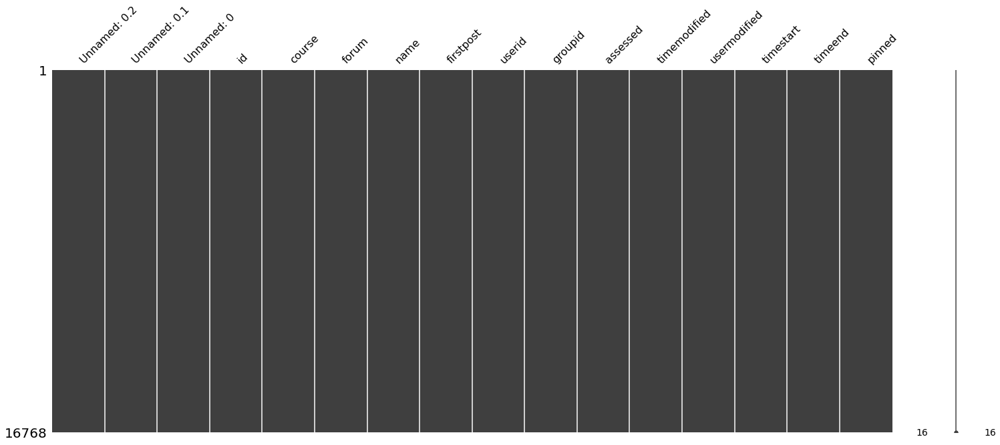

In [338]:
msno.matrix(discussions)

In [339]:
discussions.columns

Index(['Unnamed: 0.2', 'Unnamed: 0.1', 'Unnamed: 0', 'id', 'course', 'forum',
       'name', 'firstpost', 'userid', 'groupid', 'assessed', 'timemodified',
       'usermodified', 'timestart', 'timeend', 'pinned'],
      dtype='object')

In [340]:
discussions= discussions[discussions.userid.isin(students.id)]

In [341]:
discussions

,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,id,course,forum,name,firstpost,userid,groupid,assessed,timemodified,usermodified,timestart,timeend,pinned
0,0,0,0,106,1939,1438,Evelyn Tiong (soalan video),108,13454,-1,0,1536744021,13454,0,0,0
1,1,1,1,107,1939,1438,Soalan,109,11410,-1,0,1536744897,11410,0,0,0
2,2,2,2,108,1939,1438,Tiga soalan berdasarkan video yang telah ditonton,110,8131,-1,0,1536744301,8131,0,0,0
3,3,3,3,109,1939,1438,tiga soalan berdasarkan video Switzerland Tou...,111,11423,-1,0,1536744438,11423,0,0,0
4,4,4,4,110,1939,1438,3 Soalan berdasarkan video.,112,7593,-1,0,1536744467,7593,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16763,16763,16763,16763,28495,4136,12687,Moderate Down Syndrome - Speech and Language,54043,11162,-1,0,1561639473,11162,0,0,0
16764,16764,16764,16764,28515,4230,13196,Muhamad Haziq Hasan,54068,24777,-1,0,1561881618,24777,0,0,0
16765,16765,16765,16765,28516,4805,13242,MOB 180001 @ Cytopeutics,54069,15582,-1,0,1561888761,15582,0,0,0
16766,16766,16766,16766,28517,4805,13241,MOB 180001 @ Cytopeutics,54070,15582,-1,0,1561889369,15582,0,0,0


In [342]:
print(discussions.id.nunique())

print(discussions.course.nunique())

print(discussions.userid.nunique())

print(discussions.groupid.nunique())

print(discussions.forum.nunique())

16768
644
6363
101
1661


In [343]:
discussions.sort_values('id',inplace=True)
discussions.reset_index(drop=True,inplace=True)

In [344]:
discussions.head()

,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,id,course,forum,name,firstpost,userid,groupid,assessed,timemodified,usermodified,timestart,timeend,pinned
0,0,0,0,106,1939,1438,Evelyn Tiong (soalan video),108,13454,-1,0,1536744021,13454,0,0,0
1,1,1,1,107,1939,1438,Soalan,109,11410,-1,0,1536744897,11410,0,0,0
2,2,2,2,108,1939,1438,Tiga soalan berdasarkan video yang telah ditonton,110,8131,-1,0,1536744301,8131,0,0,0
3,3,3,3,109,1939,1438,tiga soalan berdasarkan video Switzerland Tou...,111,11423,-1,0,1536744438,11423,0,0,0
4,4,4,4,110,1939,1438,3 Soalan berdasarkan video.,112,7593,-1,0,1536744467,7593,0,0,0


In [345]:
discussions.to_csv(f'{path}discussions.csv',index=False)

## Forum subscriptions

In [346]:
forum_subscriptions = pd.read_csv(f'{path}forum_subscriptions.csv')

In [347]:
forum_subscriptions

,id,userid,forum
0,1,93,23
1,2,92,23
2,3,47,23
3,4,91,23
4,2984,15992,3782
...,...,...,...
3413,3698,25334,11790
3414,3699,5411,12
3415,3701,3321,13188
3416,3702,13116,13093


This table does not have enough data

## Consolidation of forum activity

In [348]:
forum_meta

,id,course,type,name
0,1,2,news,Announcements
1,3,4,news,Announcements
2,4,4,news,Announcements
3,5,4,general,Feedback on teaching and learning
4,6,4,general,Learning reflection week 1
...,...,...,...,...
11092,13347,301,news,Announcements
11093,13348,5283,news,Announcements
11094,13349,2688,news,Announcements
11095,13350,3139,news,Announcements


In [349]:
forumposts

,id,discussion,parent,userid,created,modified,mailed,subject,message,messageformat,messagetrust,attachment,totalscore,mailnow
0,8618,3816,7178,4743,1540747317,1540747317,1,Re: my fav ad,"<p>Wow, it's very creative XD</p>",1,0,NaN,0,0
1,24525,13185,24524,7404,1551772328,1551772328,1,Re: Halaqah 2 (5/3),<p>Ms 56 ali imran</p>,1,0,1.0,0,0
2,20948,10939,20917,5766,1550627084,1550627084,1,Re: Three main takeaways from all session atte...,<p>1. There is still flaws in our urban legisl...,1,0,NaN,0,0
4,6418,3426,0,6385,1539622370,1539622370,1,tutorial 4,<p>tutorial 4</p>,1,0,1.0,0,0
5,7824,4128,0,13447,1540267039,1540267039,1,"Jamie,Lih Hong and Afifa",<p>English in Asia</p>,1,0,1.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47341,54023,28478,0,11328,1561541563,1561541563,1,why chamber music is important?,<p>Because we can enjoy an enhanced ability to...,1,0,NaN,0,0
47346,54067,27043,51806,7441,1561873545,1561873545,1,Re: Bagaimana cara menyediakan soalan betul salah,<p>Cara menyediakan soalan betul salah</p>\r\n...,1,0,NaN,0,0
47347,54075,10428,38147,3739,1561908350,1561908350,1,Re: Lat,"<p>I agree with Hidayat, I myself believe Mat ...",1,0,NaN,0,0
47348,54073,28518,0,3739,1561906199,1561906199,1,Importance of Women's Writing,<p><span>In Virgina Woolf's <em>A Room of One'...,1,0,NaN,0,0


In [350]:
discussions

,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,id,course,forum,name,firstpost,userid,groupid,assessed,timemodified,usermodified,timestart,timeend,pinned
0,0,0,0,106,1939,1438,Evelyn Tiong (soalan video),108,13454,-1,0,1536744021,13454,0,0,0
1,1,1,1,107,1939,1438,Soalan,109,11410,-1,0,1536744897,11410,0,0,0
2,2,2,2,108,1939,1438,Tiga soalan berdasarkan video yang telah ditonton,110,8131,-1,0,1536744301,8131,0,0,0
3,3,3,3,109,1939,1438,tiga soalan berdasarkan video Switzerland Tou...,111,11423,-1,0,1536744438,11423,0,0,0
4,4,4,4,110,1939,1438,3 Soalan berdasarkan video.,112,7593,-1,0,1536744467,7593,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16763,16763,16763,16763,28495,4136,12687,Moderate Down Syndrome - Speech and Language,54043,11162,-1,0,1561639473,11162,0,0,0
16764,16764,16764,16764,28515,4230,13196,Muhamad Haziq Hasan,54068,24777,-1,0,1561881618,24777,0,0,0
16765,16765,16765,16765,28516,4805,13242,MOB 180001 @ Cytopeutics,54069,15582,-1,0,1561888761,15582,0,0,0
16766,16766,16766,16766,28517,4805,13241,MOB 180001 @ Cytopeutics,54070,15582,-1,0,1561889369,15582,0,0,0


<AxesSubplot:>

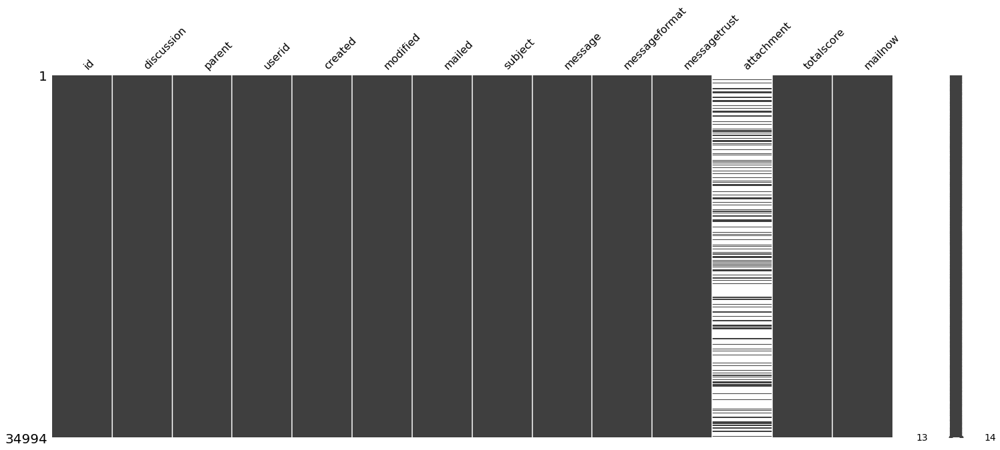

In [351]:
msno.matrix(forumposts)

<AxesSubplot:>

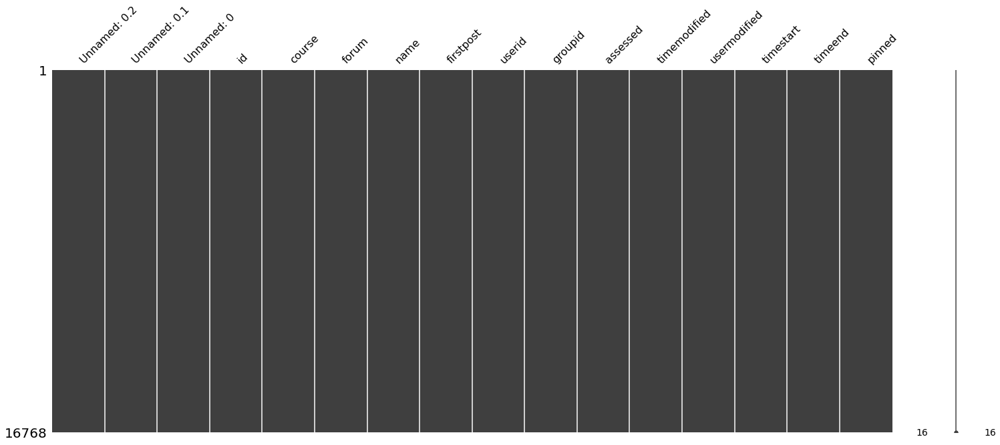

In [352]:
msno.matrix(discussions)

In [353]:
# checking number of discussions in posts df and discussion (should be the same)
print(forumposts.discussion.nunique())
print(discussions.id.nunique())

# checking number of forums in both df's
print(forumposts.id.nunique())
print(discussions.forum.nunique())

17801
16768
34994
1661


## How to measure engagement/activeness on forums

The measurement of how active a student is on forums can be seen as a relative measure, relative to how other students are. This relative measurement is better than absolute measurements taken from , for example the number of posts by a student. This is because if the forum was just an announcement, then the forum does not encourage students to interact with the post. Therefore, most students won't need to interact. There will be a few exceptions when a student might ask 1 question regarding the announcement, but this isn't an indication that this student is more active. Therefore, relative measurements will be effective when a forum has at least 1 post from 50% of the students, for example.

We can go 3 ways:
1. Consider a threshold number of posts: Do a barplot of x=number of posts, y=discussion. Then, identify the set of discussions that have a number of posts that is greater than a certain number. Or,
2. Consider a threshold number of students: If more than 50% of the students are involved, it will be identified as a discussion that encourages egagement. Do a barplot/scatterplot of x=discussion vs y=number of users
Q. How to find this "50% of the students"? We could have used the group id. But the group table is not correct, or is not useful. Therefore, there's no way to find the number of students that WERE SUPPOSED to post in the discussion or in other words, the number of students that are 'subscribed' to the discussion'.
3. We could also see the number of users participating in a post and then add an engagement point for each 'extra' post that a student has made. For example if a disussion has 20 users and most users have posted 1 post, we give the users that have posted >1 posts, an engagement point.

### Total number of posts by a user

In [354]:
forumposts.groupby(['userid'])['id'].agg(['count'])

,count
userid,
64,8
66,2
67,3
68,6
71,1
...,...
26211,1
26218,2
26255,3


In [355]:
total_posts_per_user = forumposts.groupby(['userid'])['id'].agg(['count'])

In [356]:
type(total_posts_per_user)

pandas.core.frame.DataFrame

In [357]:
total_posts_per_user.describe()

,count
count,8755.000000
mean,3.997030
std,4.829985
min,1.000000
25%,1.000000
50%,2.000000
75%,5.000000
max,81.000000


In [358]:
total_posts_per_user.to_csv(f'{ppath}total_posts_per_user.csv',index=True)

## Posts per discussion

In [359]:
posts_per_discussion_per_user = forumposts.groupby(['userid','discussion'])['id'].agg(['count'])

In [360]:
type(posts_per_discussion_per_user)

pandas.core.frame.DataFrame

In [361]:
posts_per_discussion_per_user

count
userid discussion       
64     13201           1
       14289           1
       14290           1
       24384           1
       24386           1
...                  ...
26487  18682           1
       24515           1
       24516           1
       25437           1
       25439           1

[30304 rows x 1 columns]

In [362]:
posts_per_discussion_per_user.rename(columns={'count':'posts'},inplace=True)

In [363]:
posts_per_discussion_per_user

posts
userid discussion       
64     13201           1
       14289           1
       14290           1
       24384           1
       24386           1
...                  ...
26487  18682           1
       24515           1
       24516           1
       25437           1
       25439           1

[30304 rows x 1 columns]

In [364]:
posts_per_discussion_per_user.describe()

,posts
count,30304.000000
mean,1.154765
std,1.075081
min,1.000000
25%,1.000000
50%,1.000000
75%,1.000000
max,33.000000


In [365]:
posts_per_discussion_per_user.reset_index(inplace=True)

In [366]:
posts_per_discussion_per_user.head()

,userid,discussion,posts
0,64,13201,1
1,64,14289,1
2,64,14290,1
3,64,24384,1
4,64,24386,1


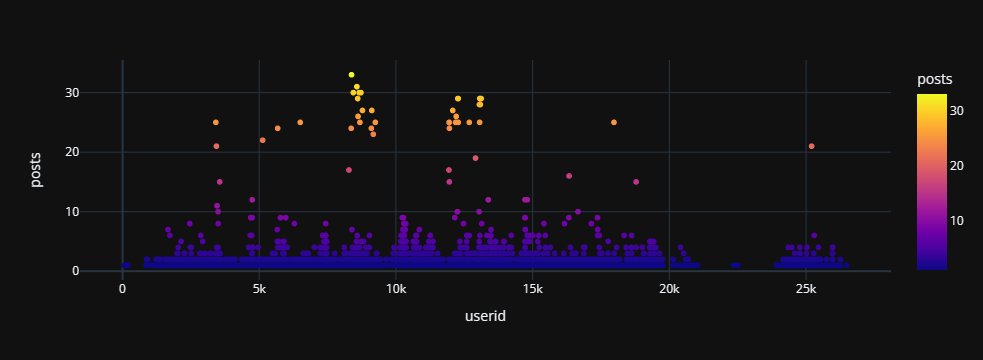

In [367]:
fig = px.scatter(posts_per_discussion_per_user,
                 x="userid",
                 y="posts",
                 color="posts",
                 template=template)
fig.show()

In [368]:
posts_per_discussion_per_user[posts_per_discussion_per_user.posts>20]

,userid,discussion,posts
2082,3413,21187,25
2110,3434,21187,21
4384,5125,21187,22
4734,5674,21187,24
6377,6500,21187,25
10112,8362,21706,24
10121,8375,21706,33
10219,8441,21706,30
10386,8571,21706,31
10431,8601,21706,29


In [369]:
posts_per_discussion_per_user.to_csv(f'{ppath}posts_per_discussion_per_user.csv',index=False)

## Mean number of posts on a discussion by each user

In [370]:
mean_posts_per_discussion = posts_per_discussion_per_user.groupby(['userid'])['posts'].agg('mean')

In [371]:
mean_posts_per_discussion = pd.DataFrame(mean_posts_per_discussion)

In [372]:
mean_posts_per_discussion.reset_index(inplace=True)

In [373]:
mean_posts_per_discussion.head()

,userid,posts
0,64,1.0
1,66,1.0
2,67,1.0
3,68,1.0
4,71,1.0


In [374]:
mean_posts_per_discussion.rename(columns={'posts':'mean_posts'},inplace=True)

In [375]:
posts_per_discussion_per_user.loc[posts_per_discussion_per_user.userid==877].posts.mean()

1.2

In [376]:
mean_posts_per_discussion.to_csv(f'{ppath}mean_posts_per_user.csv',index=False)

### no of users per discussion

An example:

In [377]:
posts_per_discussion_per_user[posts_per_discussion_per_user.discussion==21706].userid.nunique()

26

The function to count number of userid's

In [378]:
def find_users_per_discussion(df,feature, parent_feature=None):
    """ """

    #preprocessing: sort the df by userid
    discussions = df.sort_values(by='discussion').discussion.unique()
    n_items_per_user = []
    if feature not in df.columns:
        print('The column', feature,' does not exist')
        pass
    if parent_feature==None:

        for d in discussions:
            #select portion of dataframe specific to the single user and then count number of unique values for the feature
            n_items=df[df.discussion==d][feature].nunique()
            #add the data to the array
            n_items_per_user.append(n_items)
            #create the dataframe
        feature = 'number_of_' + feature +'s' #changing the name of the item column
        items_per_user_df = pd.DataFrame({'discussion':discussions,feature:n_items_per_user})

    return items_per_user_df

Usage

In [379]:
users_per_discussion = find_users_per_discussion(posts_per_discussion_per_user,'userid')

Verification

In [380]:
users_per_discussion

,discussion,number_of_userids
0,12,4
1,13,4
2,15,1
3,20,1
4,21,2
...,...,...
17796,28495,1
17797,28515,1
17798,28516,1
17799,28517,1


In [381]:
users_per_discussion.loc[users_per_discussion.discussion==21706]

,discussion,number_of_userids
13366,21706,26


Visualization

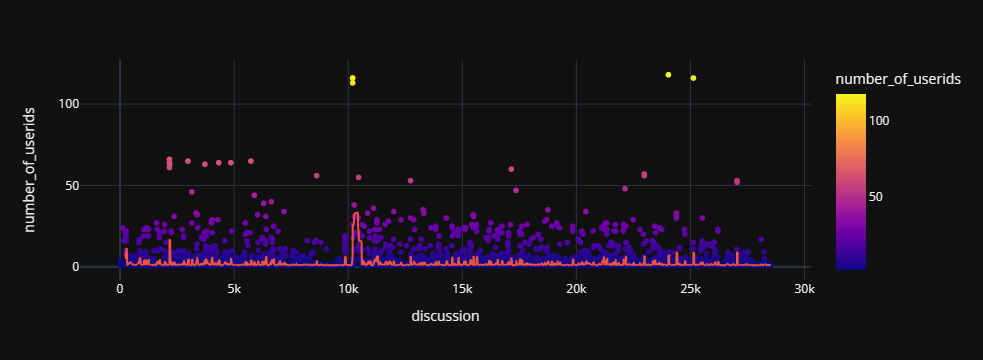

In [382]:
fig = px.scatter(users_per_discussion,
                 x="discussion",
                 y="number_of_userids",
                 color="number_of_userids",
                 # trendline='lowess',
                 trendline='rolling', # moving average model fitted
                 trendline_options=dict(window=20), # window size of moving average model
                 template=template)
fig.show()

In [383]:
users_per_discussion.describe()

,discussion,number_of_userids
count,17801.000000,17801.000000
mean,14770.556429,1.702376
std,7973.457488,4.069876
min,12.000000,1.000000
25%,7679.000000,1.000000
50%,15179.000000,1.000000
75%,21685.000000,1.000000
max,28518.000000,118.000000


In [384]:
users_per_discussion.to_csv(f'{ppath}users_per_discussion.csv',index=False)

## Finding the threshold value of posts that points to how engaged a student is

Preferrably different for each discussion?

### Distribution of posts

The following the distribution of posts, not taking into account the discussion where the post exists.

We'll make a histogram. Hence, calculating nbins first.

In [385]:
from math import sqrt,ceil,log
from numpy import max,min

In [386]:
# sturges rule
nbins_sturges = ceil(log(posts_per_discussion_per_user.size,2))+1 # no of bins = ceil(log2(n))+1
print(posts_per_discussion_per_user.size)
print(nbins_sturges)

# Freedman-Diaconis rule
q3, q1 = np.percentile(posts_per_discussion_per_user, [75 ,25])
iqr = q3 - q1
print(iqr)
h = 2*iqr/posts_per_discussion_per_user.size**(1./3.)
print(h)
k = (max(posts_per_discussion_per_user.posts)-min(posts_per_discussion_per_user.posts))/h
print(k)

90912
18
14983.5
666.4530049846799
0.04801538857302565


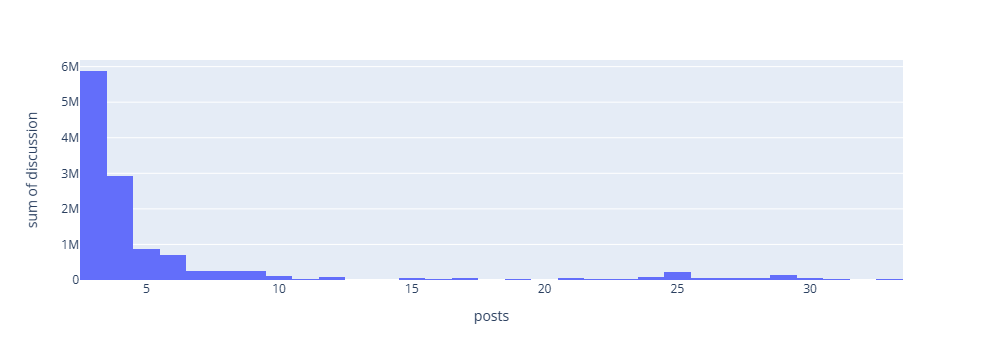

In [387]:
px.histogram(posts_per_discussion_per_user[posts_per_discussion_per_user.posts>2],
             x='posts',
             y='discussion',
             #nbins=nbins_sturges,
             #nbins=100
             )

# Enrolments

In [388]:
enrolment = pd.read_csv(f'{path}user_enrolments.csv')

In [389]:
enrolment

,id,status,enrolid,userid,timestart,timeend,modifierid,timecreated,timemodified
0,1,0,7,3,1510194899,0,2,1510194933,1510194933
1,2,0,7,6,1518505999,0,5,1518506025,1518506025
2,175211,0,3909,921,1548929369,0,2,1548929369,1548929369
3,145244,0,1242,731,1539759599,0,732,1539759668,1539759668
4,5,0,1,8,1532042499,0,9,1532042569,1532042569
...,...,...,...,...,...,...,...,...,...
193024,328696,0,5215,28178,1601806458,0,28178,1601806458,1601806458
193025,328697,0,5215,20793,1608520282,0,20793,1608520282,1608520282
193026,328698,0,5185,20793,1608520603,0,20793,1608520603,1608520603
193027,328699,0,5213,23240,1615970336,0,23240,1615970336,1615970336


In [390]:
enrolment.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 193029 entries, 0 to 193028
Data columns (total 9 columns):
 #   Column        Non-Null Count   Dtype
---  ------        --------------   -----
 0   id            193029 non-null  int64
 1   status        193029 non-null  int64
 2   enrolid       193029 non-null  int64
 3   userid        193029 non-null  int64
 4   timestart     193029 non-null  int64
 5   timeend       193029 non-null  int64
 6   modifierid    193029 non-null  int64
 7   timecreated   193029 non-null  int64
 8   timemodified  193029 non-null  int64
dtypes: int64(9)
memory usage: 13.3 MB


<AxesSubplot:>

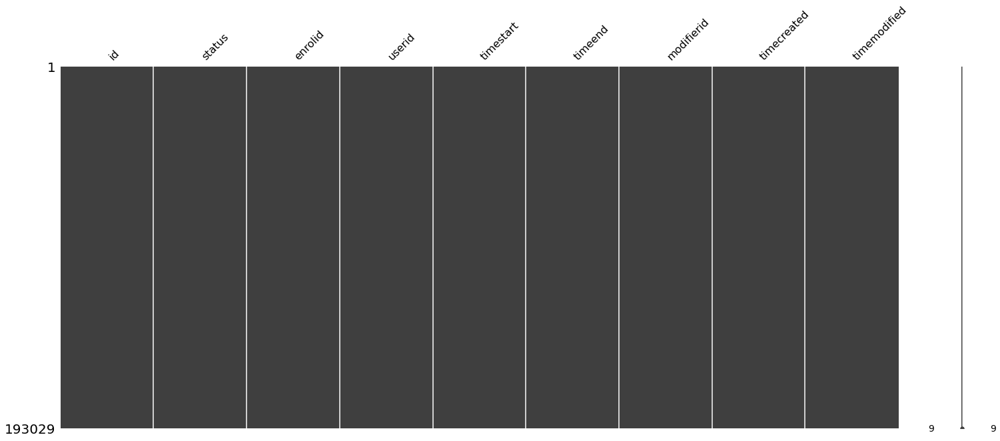

In [391]:
msno.matrix(enrolment)

In [392]:
enrolment.tail()

,id,status,enrolid,userid,timestart,timeend,modifierid,timecreated,timemodified
193024,328696,0,5215,28178,1601806458,0,28178,1601806458,1601806458
193025,328697,0,5215,20793,1608520282,0,20793,1608520282,1608520282
193026,328698,0,5185,20793,1608520603,0,20793,1608520603,1608520603
193027,328699,0,5213,23240,1615970336,0,23240,1615970336,1615970336
193028,328700,0,5215,23240,1615970435,0,23240,1615970435,1615970435


In [393]:

#number of users
print(enrolment.userid.nunique())

#number of enrol id's
print(enrolment.enrolid.nunique())

#number of statuses
print(enrolment.status.value_counts())



24295
4784
0    193029
Name: status, dtype: int64


# Standard log

In [22]:
standard_log = pd.read_csv(f'{path}logstore_standard_log.csv')

In [23]:
standard_log.head()

,id,eventname,component,action,target,objecttable,objectid,crud,edulevel,contextid,...,contextinstanceid,userid,courseid,relateduserid,anonymous,other,timecreated,origin,ip,realuserid
0,2496517,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,2,...,1,0,1,NaN,0,N;,1538443769,web,192.168.90.44,NaN
1,2496518,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,15326,...,2165,6346,2165,NaN,0,N;,1538443770,web,192.168.90.44,NaN
2,2496519,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,8200,...,1147,12403,1147,NaN,0,N;,1538443770,web,192.168.90.44,NaN
3,2496520,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,2,...,1,17434,1,NaN,0,N;,1538443771,web,192.168.90.44,NaN
4,2496521,\mod_resource\event\course_module_viewed,mod_resource,viewed,course_module,resource,8701.0,r,2,73145,...,17337,6346,2165,NaN,0,N;,1538443772,web,192.168.90.44,NaN


In [24]:
standard_log.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44355304 entries, 0 to 44355303
Data columns (total 21 columns):
 #   Column             Dtype  
---  ------             -----  
 0   id                 int64  
 1   eventname          object 
 2   component          object 
 3   action             object 
 4   target             object 
 5   objecttable        object 
 6   objectid           float64
 7   crud               object 
 8   edulevel           int64  
 9   contextid          int64  
 10  contextlevel       int64  
 11  contextinstanceid  int64  
 12  userid             int64  
 13  courseid           int64  
 14  relateduserid      float64
 15  anonymous          int64  
 16  other              object 
 17  timecreated        int64  
 18  origin             object 
 19  ip                 object 
 20  realuserid         float64
dtypes: float64(3), int64(9), object(9)
memory usage: 6.9+ GB


In [25]:
print(standard_log.userid.nunique())

print('')
print('types of actions')
print('-')
print(standard_log.action.value_counts())

25859

types of actions
-
viewed           29880618
called            6843401
loggedin          3053807
sent              1503216
loggedout          470499
created            461169
updated            402748
deleted            346690
submitted          282482
uploaded           273020
graded             267450
reviewed           103942
submissions         95740
started             79068
failed              53959
searched            47122
added               41092
downloaded          31725
submission          29888
student             20825
removed             13892
assigned            10356
locked               7613
unassigned           7472
shown                5459
accepted             5178
taken                3032
answered             2821
ended                2031
restored             1759
launched             1098
previewed             812
becameoverdue         556
unlocked              551
reset                 540
exported              532
loggedinas            456
assessed    

## Filtering the log of students only

Methodology: 

The userids of the students have been identified from the users dataframe and have been stored in the students dataframe. Therefore, only the portion of the standard_log dataframe that exists in the students dataframe shall be kept.

In [33]:
student_log = standard_log[standard_log.userid.isin(students.id)]

In [34]:
student_log[0:10]

,id,eventname,component,action,target,objecttable,objectid,crud,edulevel,contextid,...,contextinstanceid,userid,courseid,relateduserid,anonymous,other,timecreated,origin,ip,realuserid
1,2496518,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,15326,...,2165,6346,2165,NaN,0,N;,1538443770,web,192.168.90.44,NaN
2,2496519,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,8200,...,1147,12403,1147,NaN,0,N;,1538443770,web,192.168.90.44,NaN
3,2496520,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,2,...,1,17434,1,NaN,0,N;,1538443771,web,192.168.90.44,NaN
4,2496521,\mod_resource\event\course_module_viewed,mod_resource,viewed,course_module,resource,8701.0,r,2,73145,...,17337,6346,2165,NaN,0,N;,1538443772,web,192.168.90.44,NaN
5,2496522,\mod_resource\event\course_module_viewed,mod_resource,viewed,course_module,resource,10042.0,r,2,79649,...,19683,16470,2193,NaN,0,N;,1538443772,web,192.168.90.44,NaN
6,2496523,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,15522,...,2193,6467,2193,NaN,0,N;,1538443773,web,192.168.90.44,NaN
7,2496524,\core\event\user_loggedin,core,loggedin,user,user,16152.0,r,0,1,...,0,16152,0,NaN,0,"a:1:{s:8:""username"";s:27:""jasminteo@perdana.um...",1538443774,web,192.168.90.44,NaN
8,2496525,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,2,...,1,5487,1,NaN,0,N;,1538443774,web,192.168.90.44,NaN
9,2496526,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,2,...,1,16152,1,NaN,0,N;,1538443774,web,192.168.90.44,NaN
10,2496527,\mod_resource\event\course_module_viewed,mod_resource,viewed,course_module,resource,7933.0,r,2,69994,...,15779,6467,2193,NaN,0,N;,1538443775,web,192.168.90.44,NaN


In [35]:
print(student_log.userid.nunique())

print('')
print('types of actions')
print('-'*30)
print(student_log.action.nunique(),' types of actions')
print("")
print(student_log.action.value_counts())

22077

types of actions
------------------------------
46  types of actions

viewed           24116178
called            6787046
loggedin          2926651
sent               491819
loggedout          423347
submitted          280856
created            280355
uploaded           256672
updated            147136
reviewed            97882
submissions         87845
started             75111
graded              73859
downloaded          29188
submission          27702
deleted             23151
searched            22423
student             20705
added               18964
removed              6365
accepted             5169
answered             2801
becameoverdue         524
reset                 455
ended                 432
assigned              388
assessed              378
resumed               281
launched              188
reassessed            120
restarted              86
printed                49
failed                 45
saved                  44
abandoned              35
duplicated   

In [36]:
student_log.to_csv(f'{ppath}student_log.csv',index=False)

## Count the log action for each action type for each user

In [37]:
student_log

,id,eventname,component,action,target,objecttable,objectid,crud,edulevel,contextid,...,contextinstanceid,userid,courseid,relateduserid,anonymous,other,timecreated,origin,ip,realuserid
1,2496518,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,15326,...,2165,6346,2165,NaN,0,N;,1538443770,web,192.168.90.44,NaN
2,2496519,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,8200,...,1147,12403,1147,NaN,0,N;,1538443770,web,192.168.90.44,NaN
3,2496520,\core\event\course_viewed,core,viewed,course,NaN,NaN,r,2,2,...,1,17434,1,NaN,0,N;,1538443771,web,192.168.90.44,NaN
4,2496521,\mod_resource\event\course_module_viewed,mod_resource,viewed,course_module,resource,8701.0,r,2,73145,...,17337,6346,2165,NaN,0,N;,1538443772,web,192.168.90.44,NaN
5,2496522,\mod_resource\event\course_module_viewed,mod_resource,viewed,course_module,resource,10042.0,r,2,79649,...,19683,16470,2193,NaN,0,N;,1538443772,web,192.168.90.44,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44355298,2496511,\assignsubmission_file\event\assessable_uploaded,assignsubmission_file,uploaded,assessable,assign_submission,9892.0,c,2,75900,...,18459,12860,2010,NaN,0,"a:2:{s:7:""content"";s:0:"""";s:14:""pathnamehashes...",1538443768,web,192.168.90.44,NaN
44355299,2496512,\assignsubmission_file\event\submission_created,assignsubmission_file,created,submission,assignsubmission_file,4046.0,c,2,75900,...,18459,12860,2010,12860.0,0,"a:6:{s:12:""submissionid"";s:4:""9892"";s:17:""subm...",1538443768,web,192.168.90.44,NaN
44355301,2496514,\core\event\message_viewed,core,viewed,message,message_read,105137.0,c,0,36088,...,12860,12860,0,-10.0,0,"a:1:{s:9:""messageid"";i:105890;}",1538443768,web,192.168.90.44,NaN
44355302,2496515,\mod_assign\event\assessable_submitted,mod_assign,submitted,assessable,assign_submission,9892.0,u,2,75900,...,18459,12860,2010,NaN,0,"a:1:{s:19:""submission_editable"";b:1;}",1538443768,web,192.168.90.44,NaN


In [38]:
actions = student_log.action.unique() # extracting the names of the states
action_count_all = { key:[] for key in actions} # creating a dictionary with the states as the keys and empty lists as the values
action_count_all['userid'] = [] # adding userid as a key

for user in tqdm(student_log.sort_values(by='userid').userid.unique()):
    action_count_all['userid'].append(user)
    log_user = student_log.loc[student_log.userid==user]
    for action in actions:
        if log_user[log_user.action==action].action.shape[0]>0:
            action_count = log_user[log_user.action==action].action.shape[0]
        else:
            action_count = None
        action_count_all[action].append(action_count)



  0%|          | 0/22077 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
log_actions_per_user = pd.DataFrame(action_count_all)

In [ ]:
log_actions_per_user

In [ ]:
log_actions_per_user.to_csv(f'{ppath}log_actions_per_user.csv',index=False)

In [ ]:
msno.matrix(log_actions_per_user)

dropping columns that are mostly empty

In [ ]:
msno.matrix(log_actions_per_user.dropna(axis=1,thresh=log_actions_per_user.shape[0]*0.3))

In [ ]:
log_actions_per_user_dense = log_actions_per_user.dropna(axis=1,thresh=log_actions_per_user.shape[0]*0.3)

### method 2

In [ ]:
student_log

In [ ]:
student_log_pivoted = student_log.drop(columns=['component','target','courseid','origin','id']).pivot_table(index='userid',columns='action',values='timecreated')

In [ ]:
student_log_pivoted

In [ ]:
def replace_with_1(value):
    if value>1:
        value=1
    return value

In [ ]:
for column in student_log_pivoted.columns:
    student_log_pivoted[column] = student_log_pivoted[column].apply(replace_with_1)

In [ ]:
student_log_pivoted

## Number of logins by each student

In [ ]:
student_logins = student_log[student_log.action=='loggedin']
student_logins.head()

In [ ]:
student_logins.describe()

The courseid column seems to be meaningless. So that will be dropped

In [ ]:
student_logins.drop(columns='courseid',inplace=True)

In [ ]:
student_logins.to_csv(f'{ppath}student_logins.csv',index=False)
student_logins.head()

In [ ]:
login_count = items_per_user(student_logins,'timecreated')

In [ ]:
login_count.rename(columns={'number_of_timecreateds': 'number_of_logins'},inplace=True)

In [ ]:
login_count.to_csv(f'{ppath}login_count.csv',index=False)

In [ ]:
fig = px.scatter(login_count,
                 x='userid',
                 y='number_of_logins',
                 color='number_of_logins')
fig.show()

In [ ]:
fig =  px.box(login_count,
              y='number_of_logins')
fig.show()

## Save log data as parquet file

In [42]:
import pyarrow as pa
import pyarrow.parquet as pq

In [43]:
student_log_pyarrow = pa.Table.from_pandas(student_log)
pq.write_table(student_log_pyarrow, f"{ppath}student_log.parquet")
